In [11]:
#load libraries
import numpy as np
import math
from math import sqrt
from matplotlib.image import NonUniformImage
import matplotlib.pyplot as plt
%matplotlib inline
%matplotlib notebook
from statistics import mean
from scipy.stats import norm, lognorm
import seaborn as sns
sns.set()
sns.set_style('white')
from sklearn.neighbors import NearestNeighbors
from scipy.spatial import distance, Voronoi, voronoi_plot_2d, ConvexHull, Delaunay
from collections import defaultdict
import itertools
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import random
import sys
from itertools import combinations 
import time
from scipy import stats
from sklearn.svm import SVC 
from shapely import geometry
import matplotlib.animation as animation
from celluloid import Camera
from scipy.stats import entropy
import sobol_seq
from shapely import geometry
from shapely.geometry import Polygon, LineString
from shapely.ops import unary_union

In [12]:
#load data
raw_data = np.loadtxt('Data Files/EBSD Raw Data/AZ31B Ecomp 10e0 Int_3 raw1.txt', skiprows=17, usecols=(0,1,2,3,4,8,9))
raw_data_copy=np.copy(raw_data)
xy_max=12
raw_data_slice=raw_data[np.where((raw_data[:,3]<=xy_max) & (raw_data[:,4]<=xy_max))]

In [77]:
def golden(n,d=2):
    g = 1.32471795724474602596 
    alpha = np.zeros(d) 
    for j in range(d): 
        alpha[j] = pow(1/g,j+1) %1 
    z = np.zeros((n, d)) 
    seed=0.5
    for i in range(n): 
        z[i] = (seed + alpha*(i+1)) %1 
    return z

In [96]:
def sample(size,array,strategy='random'):
    if strategy == 'random':
        #choose random points
        array_sample=array[np.random.choice(array.shape[0], size, replace=False), 3:6]
    
    if strategy == 'square':
        phi = (np.sqrt(5)+1)/2
        ratio = np.sqrt(3)/2 # cos(60°)
        coords = array[:,3:5]
        N = size
        
        N_X = int(np.sqrt(N))
        N_Y = N // N_X
        xv, yv = np.meshgrid(np.arange(N_X), np.arange(N_Y), sparse=False, indexing='xy')
        square_coords=np.concatenate((xv.reshape(-1,1), yv.reshape(-1,1)), axis=1)
        square_coords[:,0] = square_coords[:,0] * (np.amax(array[:,3]) / np.amax(square_coords[:,0]))
        square_coords[:,1] = square_coords[:,1] * (np.amax(array[:,4]) / np.amax(square_coords[:,1]))
        grid_sample=array[nearest_neighbors(square_coords,coords), 3:6]
        grid_sample=grid_sample[:,0]
        
        array_sample=grid_sample
        
    if strategy == 'hex':
        phi = (np.sqrt(5)+1)/2
        ratio = np.sqrt(3)/2 # cos(60°)
        coords = array[:,3:5]
        N = size
        
        N_X = int(np.sqrt(N)/ratio)
        N_Y = N // N_X
        xv, yv = np.meshgrid(np.arange(N_X), np.arange(N_Y), sparse=False, indexing='xy')
        xv = xv * ratio
        xv[::2, :] += ratio/2
        hex_coords=np.concatenate((xv.reshape(-1,1), yv.reshape(-1,1)), axis=1)
        hex_coords[:,0] *= (np.amax(array[:,3]) / np.amax(hex_coords[:,0]))
        hex_coords[:,1] *= (np.amax(array[:,4]) / np.amax(hex_coords[:,1]))
        grid_sample=array[nearest_neighbors(hex_coords,coords), 3:6]
        grid_sample=grid_sample[:,0]
        
        array_sample=grid_sample
        
    if strategy == 'sobol':
        #choose 2D sobol points
        coords = array[:,3:5]
        sobol = (sobol_seq.i4_sobol_generate(2, size))
        sobol[:,0]*=np.amax(array[:,3])
        sobol[:,1]*=np.amax(array[:,4])
        sobol_sample=array[nearest_neighbors(sobol,coords), 3:6]
        sobol_sample=sobol_sample[:,0]

        array_sample=sobol_sample
        
    if strategy == 'gold':
        #choose 2D golden points
        coords = array[:,3:5]
        golden_2D = golden(size)
        golden_2D[:,0]*=np.amax(array[:,3])
        golden_2D[:,1]*=np.amax(array[:,4])
        golden_sample=array[nearest_neighbors(golden_2D,coords), 3:6]
        golden_sample=golden_sample[:,0]

        array_sample=golden_sample
        
    return array_sample

In [15]:
def nearest_neighbors(values, all_values, nbr_neighbors=1):
    nn = NearestNeighbors(nbr_neighbors, metric='euclidean', algorithm='kd_tree').fit(all_values)
    dists, idxs = nn.kneighbors(values)
    return idxs

In [16]:
def golden_sample(n,array,d=2):
    g = 1.32471795724474602596 
    alpha = np.zeros(d) 
    for j in range(d): 
        alpha[j] = pow(1/g,j+1) %1 
    z = np.zeros((n, d)) 
    seed=0.5
    for i in range(n): 
        z[i] = (seed + alpha*(i+1)) %1 
    
    golden_2D = z
    golden_2D[:,0]*=np.amax(array[:,3])
    golden_2D[:,1]*=np.amax(array[:,4])
    golden_sample=array[nearest_neighbors(golden_2D,array[:,3:5]),3:6]
    return golden_sample[:,0]

In [17]:
def svm_slice(array, num_samples=200, param_1=1e10, param_2=1):
    #create boundaries
    X=array[:,0:2]
    Y=array[:,2]

    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()

    model = SVC(kernel='rbf', C=param_1, gamma=param_2)
    model.fit(X, Y)

    # create grid to evaluate model
    x = np.linspace(x_min, x_max, num_samples)
    y = np.linspace(y_min, y_max, num_samples)
    xx, yy = np.meshgrid(x, y)
    xx=xx.ravel()
    yy=yy.ravel()
    Z = model.predict(np.c_[xx, yy])
    return xx, yy, Z

In [18]:
# #choose the first angle for entire grain for consistency
# for grain_ID in np.unique(raw_data[:,5]):
#     grain_slice=raw_data[np.where(raw_data[:,5]==grain_ID)]
# #     rep_angle=grain_slice[np.random.choice(grain_slice.shape[0], 1, replace=False),0:3] #random angle
#     rep_angle=grain_slice[0,0:3]
#     raw_data[np.where(raw_data[:,5]==grain_ID),0:3]=rep_angle

# #orientation -> rgb colormap
# new_cmap=np.copy(raw_data[:,0:3])

# #normalize
# # print(np.amax(raw_data[:,0]))
# # print(np.amax(raw_data[:,1]))
# # print(np.amax(raw_data[:,2]))
# new_cmap[:,0]=new_cmap[:,0]/(2*math.pi)
# new_cmap[:,1]=new_cmap[:,1]/math.pi
# new_cmap[:,2]=new_cmap[:,2]/(2*math.pi)

# #add grain IDs
# new_cmap=np.concatenate((raw_data[:,5].reshape(-1,1),new_cmap),axis=1)
# #make unique
# u, indices=np.unique(new_cmap[:,0],return_index=True)
# new_cmap=new_cmap[indices]

# %store new_cmap
%store -r
def eulergb_cmap(z):
    colors=np.zeros((len(z),3))
    z=np.concatenate((z.reshape(-1,1),colors),axis=1)
    for row in z:
        row[1:4]=new_cmap[np.where(new_cmap[:,0]==row[0]),1:4] 
    return z[:,1:4]

# print(new_cmap)
# z=np.array([1,2,3])
# eulergb_cmap(z)

# temp_cmap = eulergb_cmap(raw_data[:,5])
# plt.title('100% of Total Data')
# plt.xlabel('x (μm)')
# plt.ylabel('y (μm)')
# plt.scatter(raw_data[:,3], raw_data[:,4], c=temp_cmap)
# plt.show()

In [19]:
def active_sample(size,array,strategy='confidence',budget=5,num_samples=200):          
    #prediction coords
    coords=array[:,3:5]
    #initialize list for array
    row_list=[]
    #initialize first random batch
    indexes=np.random.choice(array.shape[0], 4, replace=False)
    row_list.append(array[indexes,3:6])
    X=array[indexes,3:5]
    Y=array[indexes,5]
    #needs more than one grain and four points
    while (len(np.unique(Y)) < 2) or (len(X) < 4):
        row_list.pop() #remove old selection
        indexes=np.random.choice(array.shape[0], 4, replace=False)
        row_list.append(array[indexes,3:6])
        X=array[indexes,3:5]
        Y=array[indexes,5]
    #add active points in batches to speed up (instead of one by one)
    while len(Y) < size:
        #training window
        x_min, x_max = X[:, 0].min(), X[:, 0].max()
        y_min, y_max = X[:, 1].min(), X[:, 1].max()

        #train with probability output
        model = SVC(kernel='rbf', C=1e10, gamma=10e-3,probability=True)
        model.fit(X, Y)

        #https://davefernig.com/2018/02/23/active-learning/#more-1186
        probs = model.predict_proba(coords)

        if strategy=='confidence':
            # Rank predictions by confidence:
            scores = 1 - np.amax(probs, axis=1)
            # Sort them:
            rankings = np.argsort(-scores)

        if strategy=='margin':
            # Compute the margin of each instance:
            ordered = np.partition(-probs, 1, axis=1)
            margins = -np.abs(ordered[:,0] - ordered[:, 1])
            # Sort them:
            rankings = np.argsort(-margins)

        if strategy=='entropy':
            scores = np.apply_along_axis(entropy, 1, probs)
            rankings = np.argsort(-scores)

        # Take the points for which we have a budget
        active_slice = array[rankings[:budget]]   

        #append data and retrain
        row_list.append(active_slice[:,3:6])
        X=np.vstack((X,active_slice[:,3:5]))
        Y=np.vstack((Y.reshape(-1,1),active_slice[:,5].reshape(-1,1)))
        Y=Y.ravel()
    #create array
    row_tuple=tuple(row_list)
    sliced_array=np.vstack(row_tuple)
    print(len(sliced_array))
    return sliced_array

In [ ]:
#add four to size for active percents
#at one hundred, active is faster, is small batches more efficient to a point?
#0.5 only trains once, but on half the data...batch size could actually speed up as well
#two seperate problems - discovery and classification...what would help is finding what percent of grains are discovered ->
# (np.unique5) vs data points sampled, then doing further active from there.
#possibly implement threshold, i.e. do regular sampling, but further sample if very uncertain
#grain detection is anomaly detection
#confidence is best suited to binary, not multiclass
#faster training is a bug (should train again on all data)?
#existing vs discrimination/novelty
#discriminative -> uncertainty
#'likelihood sampling' - least certain, how is this different from selecting close to decision boundary
#uncertainty sampling of top samples in batches can underperform random sicne the top are too similar

In [91]:
start=time.time()
svm_slice(sample(1000,raw_data,'random'),param_2=10e-3)
end=time.time()
print(end-start)

51.06853437423706


In [92]:
start=time.time()
svm_slice(active_sample(1000,raw_data,'confidence',budget=int(0.5*1000)),param_2=10e-3)
end=time.time()
print(end-start)

1004
9.906893968582153


In [106]:
# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(2000, 3000, 1000):
#     x, y, z = svm_slice(active_sample(size,array,strategy='confidence',budget=int(round(0.5*size,0))),param_1=1,param_2=10e-3)
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# # anim.save('Confidence SVM x% .mp4')

In [108]:
# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(100, 1100, 100):
#     x, y, z = svm_slice(active_sample(size,array,strategy='margin',budget=int(round(0.5*size,0))),param_2=10e-3)
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# # anim.save('Confidence SVM x% .mp4')

In [109]:
# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(100, 1100, 100):
#     x, y, z = svm_slice(active_sample(size,array,strategy='entropy',budget=int(round(0.5*size,0))),param_2=10e-3)
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# # anim.save('Confidence SVM x% .mp4')

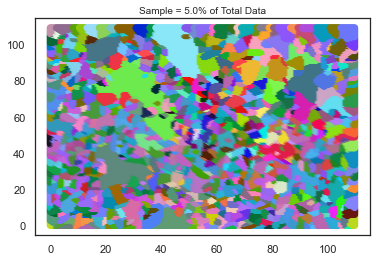

In [99]:
#SVM Animation
# %matplotlib notebook
%matplotlib inline
fig = plt.figure()
# camera = Camera(fig)
ax = fig.add_subplot(111)

array=raw_data
# for size in range(100, 5100, 100):
for size in [4351]:
    x, y, z = svm_slice(sample(size,array,'gold'),param_2=10e-3)
    temp_cmap = eulergb_cmap(z)
    percent=size/len(array)*100
    ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
    plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# anim.save('Sobol SVM 5%.mp4')

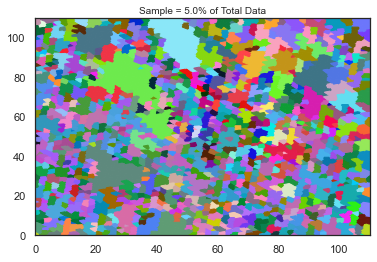

In [97]:
#Voronoi Animation
# %matplotlib notebook
%matplotlib inline
fig = plt.figure()
# camera = Camera(fig)
ax = fig.add_subplot(111)

array=raw_data
# for size in range(100, 5100, 100):
for size in [4351]:
    points_and_IDs=sample(size,array,strategy='gold')
    # add 4 distant dummy points
    points = np.append(points_and_IDs[:,0:2], [[999,999], [-999,999], [999,-999], [-999,-999]], axis = 0)
    # compute Voronoi tesselation
    vor = Voronoi(points)
     # plot & colorize
    percent=size/len(array)*100
    ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
    temp_cmap = eulergb_cmap(points_and_IDs[:,2])
    for r in range(len(vor.point_region)):
        region = vor.regions[vor.point_region[r]]
        if not -1 in region:
            polygon = [vor.vertices[i] for i in region]
            plt.xlim([0,110]), plt.ylim([0,110])
            plt.fill(*zip(*polygon), color=temp_cmap[r])
#     camera.snap()
# anim = camera.animate(blit=True)
# anim.save('_ Voronoi 5%.mp4')

In [ ]:
#scatterplot of coords (black if correct, red if wrong)
#for svm, IDs are compared to nearest neighbor
#voronoi, use inpolygon to determine predicted (as compared to actual)

<IPython.core.display.Javascript object>


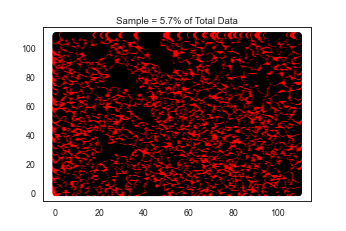

In [87]:
#SVM Animation Binary Coloration
%matplotlib notebook
fig = plt.figure()
camera = Camera(fig)
ax = fig.add_subplot(111)

array=raw_data
actual_IDs=array[:,5].astype(int)
for size in range(100, 5100, 100):
    #predicted IDs for comparison
    x, y, z = svm_slice(sample(size,array,'sobol'),param_2=10e-3)
    svm_prediction=np.stack([x, y, z], axis=1)
    predicted_IDs=svm_prediction[nearest_neighbors(array[:,3:5],svm_prediction[:,0:2]), 2].ravel().astype(int)
    #create colormap
    right_wrong=[]
    for index in np.arange(0,len(array)):
        if actual_IDs[index]==predicted_IDs[index]:
            right_wrong.append([0,0,0])
        else:
            right_wrong.append([1,0,0])
    #plot
    percent=size/len(array)*100
    ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
    plt.scatter(array[:,3], array[:,4], c=right_wrong)
    camera.snap()
anim = camera.animate(blit=True)
anim.save('Sobol SVM 5% Binary Coloration.mp4')

In [63]:
def full_sample(size,method):
    global coords
    
    if method == 'random':
        #choose random points
        raw_data_sample=raw_data[np.random.choice(raw_data.shape[0], size, replace=False), :]
    
    if method == 'square':
        phi = (np.sqrt(5)+1)/2
        ratio = np.sqrt(3)/2 # cos(60°)
        coords = raw_data[:,3:5]
        N = size
        
        N_X = int(np.sqrt(N))
        N_Y = N // N_X
        xv, yv = np.meshgrid(np.arange(N_X), np.arange(N_Y), sparse=False, indexing='xy')
        square_coords=np.concatenate((xv.reshape(-1,1), yv.reshape(-1,1)), axis=1)
        square_coords[:,0] = square_coords[:,0] * (np.amax(raw_data[:,3]) / np.amax(square_coords[:,0]))
        square_coords[:,1] = square_coords[:,1] * (np.amax(raw_data[:,4]) / np.amax(square_coords[:,1]))
        grid_sample=raw_data[nearest_neighbors(square_coords,coords), :]
        grid_sample=grid_sample[:,0]
        
        raw_data_sample=grid_sample
        
    if method == 'hex':
        phi = (np.sqrt(5)+1)/2
        ratio = np.sqrt(3)/2 # cos(60°)
        coords = raw_data[:,3:5]
        N = size
        
        N_X = int(np.sqrt(N)/ratio)
        N_Y = N // N_X
        xv, yv = np.meshgrid(np.arange(N_X), np.arange(N_Y), sparse=False, indexing='xy')
        xv = xv * ratio
        xv[::2, :] += ratio/2
        hex_coords=np.concatenate((xv.reshape(-1,1), yv.reshape(-1,1)), axis=1)
        hex_coords[:,0] *= (np.amax(raw_data[:,3]) / np.amax(hex_coords[:,0]))
        hex_coords[:,1] *= (np.amax(raw_data[:,4]) / np.amax(hex_coords[:,1]))
        grid_sample=raw_data[nearest_neighbors(hex_coords,coords), :]
        grid_sample=grid_sample[:,0]
        
        raw_data_sample=grid_sample
        
    if method == 'sobol':
        #choose 2D sobol points
        sobol = (sobol_seq.i4_sobol_generate(2, size))
        sobol[:,0]*=np.amax(raw_data[:,3])
        sobol[:,1]*=np.amax(raw_data[:,4])
        sobol_sample=raw_data[nearest_neighbors(sobol,coords), :]
        sobol_sample=sobol_sample[:,0]

        raw_data_sample=sobol_sample
        
    if method == 'gold':
        #choose 2D golden points
        golden_2D = golden(size)
        golden_2D[:,0]*=np.amax(raw_data[:,3])
        golden_2D[:,1]*=np.amax(raw_data[:,4])
        golden_sample=raw_data[nearest_neighbors(golden_2D,coords), :]
        golden_sample=golden_sample[:,0]

        raw_data_sample=golden_sample
        
    if method == 'window':
        percent=sqrt(size/file_size)
        #Full Window
        row_list=[]
        for index in range(0,len(raw_data)):
            if (raw_data[index,3]<=int((np.amax(raw_data[:,3])*percent))) and (raw_data[index,4]<=int((np.amax(raw_data[:,4])*percent))):
                row_list.append(raw_data[index,:])
            else:
                continue
        row_tuple=tuple(row_list)
        window_sample=np.vstack(row_tuple)
        
        raw_data_sample=window_sample
    
    return raw_data_sample

In [87]:
def voronoi_polygons(voronoi, diameter):
    """Generate shapely.geometry.Polygon objects corresponding to the
    regions of a scipy.spatial.Voronoi object, in the order of the
    input points. The polygons for the infinite regions are large
    enough that all points within a distance 'diameter' of a Voronoi
    vertex are contained in one of the infinite polygons.

    """
    centroid = voronoi.points.mean(axis=0)

    # Mapping from (input point index, Voronoi point index) to list of
    # unit vectors in the directions of the infinite ridges starting
    # at the Voronoi point and neighbouring the input point.
    ridge_direction = defaultdict(list)
    for (p, q), rv in zip(voronoi.ridge_points, voronoi.ridge_vertices):
        u, v = sorted(rv)
        if u == -1:
            # Infinite ridge starting at ridge point with index v,
            # equidistant from input points with indexes p and q.
            t = voronoi.points[q] - voronoi.points[p] # tangent
            n = np.array([-t[1], t[0]]) / np.linalg.norm(t) # normal
            midpoint = voronoi.points[[p, q]].mean(axis=0)
            direction = np.sign(np.dot(midpoint - centroid, n)) * n
            ridge_direction[p, v].append(direction)
            ridge_direction[q, v].append(direction)
    
#     for i, r in islice(enumerate(voronoi.point_region),0,2):
    for i, r in enumerate(voronoi.point_region):
        region = voronoi.regions[r]
        if -1 not in region:
            # Finite region.
            yield Polygon(voronoi.vertices[region])
            continue
        # Infinite region.
        inf = region.index(-1)              # Index of vertex at infinity.
        j = region[(inf - 1) % len(region)] # Index of previous vertex.
        k = region[(inf + 1) % len(region)] # Index of next vertex.
        try:
            if j == k:
                # Region has one Voronoi vertex with two ridges.
                dir_j, dir_k = ridge_direction[i, j]
            else:
                # Region has two Voronoi vertices, each with one ridge.
                dir_j, = ridge_direction[i, j]
                dir_k, = ridge_direction[i, k]

            # Length of ridges needed for the extra edge to lie at least
            # 'diameter' away from all Voronoi vertices.
            length = 2 * diameter / np.linalg.norm(dir_j + dir_k)

            # Polygon consists of finite part plus an extra edge.
            finite_part = voronoi.vertices[region[inf + 1:] + region[:inf]]
            extra_edge = [voronoi.vertices[j] + dir_j * length,
                          voronoi.vertices[k] + dir_k * length]
            yield Polygon(np.concatenate((finite_part, extra_edge)))
            
        except:
            yield np.nan

In [89]:
array=raw_data_slice

for size in range(1000, 5100, 100):
    print(size)
    #sample array
    coords=array[:,3:5]
    array=full_sample(size,'sobol')

    #slice array
    points_and_IDs=array[:,3:6]
    points=points_and_IDs[:,0:2]

    #collapse infinite polygons #expand boundary
    boundary = np.array([[-1, -1], [-1, np.amax(array[:,4])+1], [np.amax(array[:,3])+1, np.amax(array[:,4])+1], [np.amax(array[:,3])+1, -1]])
    diameter = np.linalg.norm(boundary.ptp(axis=0))
    boundary_polygon = Polygon(boundary)
    
    for p in voronoi_polygons(Voronoi(points), diameter):
        print(p)

1000
POLYGON ((104.4 32.56256955702771, 98.26666669775001 0.69282, 97.2 0.69282, 97.2 112.3454424117409, 107.5690166193963 144.1702100888693, 104.4 32.56256955702771))
nan
nan
nan
nan
nan
nan
nan
nan
POLYGON ((39.8 0.3464099999999942, 30.30491802820082 0.3464100000000001, 30.29508197179918 0.6928200000000001, 36.4 215.6981603309662, 39.8 95.95565867108337, 39.8 0.3464099999999942))
nan
nan
nan
nan
POLYGON ((92 -14.54923421321551, 92.40000000000001 -17.32051679743656, 92.40000000000001 94.32085957795977, 92 97.09214216218081, 92 -14.54923421321551))
POLYGON ((96 -0.6928212921105152, 95.59999999999999 -1.61658215351752, 95.59999999999999 110.0247942218788, 96 110.9485550832858, 96 -0.6928212921105152))
nan
nan
nan
POLYGON ((56.4 60.73727582994146, 54.69508197179918 0.69282, 45.91111110075001 0.69282, 39.8 95.95565867108337, 36.4 215.6981603309662, 36.4 327.3395367063625, 56.4 172.3786522053378, 56.4 60.73727582994146))
nan
nan
nan
nan
nan
nan
nan
nan
nan
POLYGON ((30.29508197179918 0.692

POLYGON ((63.99999994005357 2.771282249656684, 63.40000000000001 1.039230807569067, 59.60000027974999 -5.542564845414427, 60.8 -1.385641938165761, 63.8 3.810512907248644, 63.99999994005357 2.771282249656684))
POLYGON ((63.99999994005357 2.771282249656684, 63.40000000000001 1.039230807569067, 59.60000027974999 -5.542564845414427, 60.8 -1.385641938165761, 63.8 3.810512907248644, 63.99999994005357 2.771282249656684))
nan
nan
nan
POLYGON ((89 6.581795652983484, 89 1.039230807569057, 89.8 -1.270171345948442, 91.43333331002083 3.444857983519044, 90.19999999999999 16.97410534381223, 89 6.581795652983484))
POLYGON ((41 -7.043676729742213, 40.81333335198333 -4.349374486494809, 39 6.119915383793773, 38.199999860125 3.810512826491746, 37.8 2.193931884327818, 37.8 -100.8508977724429, 41 -110.088506386513, 41 -7.043676729742213))
POLYGON ((16.82222225330555 -0.6030109212269339, 23.14999996503125 -40.78981547593534, 19.8 11.43154017537024, 16.82222225330555 -0.6030109212269339))
nan
nan
POLYGON ((16

POLYGON ((29.4 38.45154504849748, 32.999999953375 -5.196155087685113, 29.4 1.039230646055253, 29.4 38.45154504849748))
nan
nan
POLYGON ((24.4 -30.25316837259316, 21.2 -87.52634177982736, 18.83589744307051 -20.64546346248961, 19.64210524843421 -7.146992658790388, 24.4 20.32273830489882, 24.4 -30.25316837259316))
nan
nan
POLYGON ((44.8 27.71282503464101, 50 120.7817318213965, 51.983999994405 44.03567967213127, 48.73658537267683 -17.83590747433076, 44.8 0.3464100000000001, 44.8 27.71282503464101))
POLYGON ((27.34666664801667 -1.331755586424565, 24.42666667599167 20.58447064048862, 24.4 20.32273830489882, 24.4 -30.25316837259316, 27.34666664801667 -1.331755586424565))
POLYGON ((27.34666664801667 -1.331755586424565, 24.42666667599167 20.58447064048862, 24.4 20.32273830489882, 24.4 -30.25316837259316, 27.34666664801667 -1.331755586424565))
nan
nan
nan
POLYGON ((24.4 -30.25316837259316, 21.2 -87.52634177982736, 18.83589744307051 -20.64546346248961, 19.64210524843421 -7.146992658790388, 24.4 2

POLYGON ((87.59999999999999 19.62991749732981, 87.40000000000001 22.51667018922663, 84.35714288711607 -3.835257695799162, 84.80000000000001 -7.159146998931905, 87.59999999999999 0.9237605383793648, 87.59999999999999 19.62991749732981))
nan
nan
POLYGON ((69.466666651125 7.621026541309408, 61.8 127.1325877435696, 59.56315789841776 22.52578642249866, 61 -36.37308440244215, 69.466666651125 7.621026541309408))
nan
nan
POLYGON ((61 -496.4059930601023, 60.8 -512.6872782424008, 47.444444449625 -26.90453543842558, 48.06999999300625 -10.65211809934398, 59.56315789841776 22.52578642249866, 61 -36.37308440244215, 61 -496.4059930601023))
nan
POLYGON ((11.4 -24.36419288112352, 11.4 0.3464096769723749, 11.1000002098125 0.8660247981077321, 10 1.924500987028858, 8.948387150919356 -0.3017129097768729, 11.4 -24.36419288112352))
POLYGON ((11.4 -24.36419288112352, 17 -105.1932682542363, 18.5999999954879 -37.75872556169458, 17.1923076976875 3.69060164469124, 11.4 0.3464096769723749, 11.4 -24.36419288112352)

POLYGON ((61 -496.4059930601023, 60.8 -512.6872782424008, 47.444444449625 -26.90453543842558, 48.06999999300625 -10.65211809934398, 59.56315789841776 22.52578642249866, 61 -36.37308440244215, 61 -496.4059930601023))
nan
nan
POLYGON ((61 -496.4059930601023, 60.8 -512.6872782424008, 47.444444449625 -26.90453543842558, 48.06999999300625 -10.65211809934398, 59.56315789841776 22.52578642249866, 61 -36.37308440244215, 61 -496.4059930601023))
POLYGON ((75.40000000000001 -8.660258883259733, 80.80000000000001 6.928205652983462, 81.12307689079807 3.01110469933916, 75.10000002997322 -14.37602864214887, 75.40000000000001 -8.660258883259733))
POLYGON ((34.91999983215 -1.639675658208499, 31.4 12.58624092910134, 30.95294120115441 5.101061421279953, 32.2 1.50111107675876, 34.91999983215 -1.639675658208499))
POLYGON ((48.06999999300625 -10.65211809934398, 47.444444449625 -26.90453543842558, 42.03157900626316 1.221551562675197, 46.27111111732778 25.69851303067335, 48.06999999300625 -10.65211809934398))


POLYGON ((29.6 82.67659596533008, 21.480000027975 2.979127922014378, 20.81333340793333 0.2848255980100632, 17.77647052241176 1.161492808980181, 17.2 4.156922907248635, 17.2 110.610774684484, 29.6 189.1304477425655, 29.6 82.67659596533008))
POLYGON ((20.95555558663889 -0.3720708135510704, 22.799999860125 0.692820080756908, 21.480000027975 2.979127922014378, 20.81333340793333 0.2848255980100632, 20.95555558663889 -0.3720708135510704))
nan
nan
nan
POLYGON ((55.32727270184091 -13.27906302878092, 52.73617020681383 -46.1905002797816, 49.70344830480173 -2.416909707741176, 52.57333335198334 4.210809000567736, 55.32727270184091 -13.27906302878092))
POLYGON ((63.6 4.041453445628003, 64.59999999999999 -5.196155168442038, 68.333333209 1.270170646055247, 63.6 17.666925505326, 63.6 4.041453445628003))
nan
POLYGON ((8.589189143824324 -6.9625362015913, 3.600000000000001 30.48410729583443, 3.6 4.849743714817703, 5.869230753091347 -25.28351301628183, 8.589189143824324 -6.9625362015913))
nan
POLYGON ((70

POLYGON ((90.54782606871196 -7.003513926796327, 89.81739131042934 -22.60703926177893, 93.8 -149.0719091710691, 98.79512194439634 -13.52690100927919, 98.61428572427678 -9.872694892721077, 95.60000003227884 2.309401377008798, 93 -0.1924509870288529, 91.80000000000001 -2.73279335589809, 91 -5.350115796551274, 90.54782606871196 -7.003513926796327))
POLYGON ((39.6 -48.03556527770562, 37 -4.503334683900595, 37 1.03923, 42.53103445381897 1.039230000000003, 39.6 -48.03556527770562))
nan
POLYGON ((16.32713180463178 8.771251832798168, 30.6 461.9958993575531, 30.6 49.0747947931642, 24.56000005595 3.741230939551397, 19 -5.888976137524893, 16.32713180463178 8.771251832798168))
POLYGON ((73.80833332750521 41.83385717121992, 70.78181819453411 155.4122663644428, 83.39999995463513 2.424871680616695, 81.77999995803749 -1.004590510154147, 77.4200000419625 6.547154386485691, 77.38181814367046 6.760249668659852, 73.80833332750521 41.83385717121992))
POLYGON ((91 -5.350115796551274, 91.80000000000001 -2.732

POLYGON ((99 39.60624580222869, 99 11238.82104874701, 105.4 12971.79642474654, 105.4 1.270170376865567, 104.919999916075 0.6235376608209894, 102.8 1.847520753731143, 100.3857142757232 11.60474489272108, 99 39.60624580222869))
POLYGON ((30.6 19.28350749732974, 30.6 49.0747947931642, 24.56000005595 3.741230939551397, 27.1400000139875 -6.685719613990643, 30.6 19.28350749732974))
POLYGON ((73.80833332750521 41.83385717121992, 70.78461540613462 -12.28424309291123, 77.38181814367046 6.760249668659852, 73.80833332750521 41.83385717121992))
nan
POLYGON ((88 3.464102261193387, 88 8642.706617870297, 85.8 8163.85208133844, 85.8 -0.3464112921105158, 88 3.464102261193387))
POLYGON ((90.54782606871196 -7.003513926796327, 89.81739131042934 -22.60703926177893, 93.8 -149.0719091710691, 98.79512194439634 -13.52690100927919, 98.61428572427678 -9.872694892721077, 95.60000003227884 2.309401377008798, 93 -0.1924509870288529, 91.80000000000001 -2.73279335589809, 91 -5.350115796551274, 90.54782606871196 -7.00

POLYGON ((107 2.424871615138114, 105.3499999650312 -0.4330136104074522, 104.84000005595 1.03923, 140.6703715815896 104.4726514533056, 142.8303715256396 105.8582930684437, 107 2.424871615138114))
POLYGON ((51.8 1.385640646055251, 58.22531647694304 -0.4691893175552178, 58.4 3.464102099679524, 58.4 395.6005874439247, 51.8 147.9172064791721, 51.8 1.385640646055251))
POLYGON ((19.18181823268182 4.12543147082674, 21.6 -7.043676891256032, 23.2 0.3464100000000007, 23.2 32.33162901864842, 20.73333324008333 16.666183818404, 19.18181823268182 4.12543147082674))
POLYGON ((104 5657.573394233566, 104 1.03923, 104.84000005595 1.03923, 141.1576014391564 105.8791635562091, 104.6100691056578 5768.523868112618, 104 5657.573394233566))
POLYGON ((39.4999997901875 0.8660250403784532, 40.0999997901875 0.7505549327025766, 34.4 -15.70393480543287, 33.97857144355803 -2.321774588171211, 39.4999997901875 0.8660250403784532))
POLYGON ((97.35384621840385 17.80015989707616, 99.36271185018221 -3.076593875626946, 92.8

POLYGON ((70.34468086892021 29.5775446014531, 76.31249999125781 -22.10530914703223, 68 -257.2674000633642, 63.97586207620043 -45.84362415287621, 67.04615381387501 -1.527759459672012, 70.34468086892021 29.5775446014531))
nan
POLYGON ((51.8 1.385640646055251, 58.22531647694304 -0.4691893175552178, 58.4 3.464102099679524, 58.4 395.6005874439247, 51.8 147.9172064791721, 51.8 1.385640646055251))
POLYGON ((19.18181823268182 4.12543147082674, 21.6 -7.043676891256032, 23.2 0.3464100000000007, 23.2 32.33162901864842, 20.73333324008333 16.666183818404, 19.18181823268182 4.12543147082674))
nan
POLYGON ((39.4999997901875 0.8660250403784532, 40.0999997901875 0.7505549327025766, 34.4 -15.70393480543287, 33.97857144355803 -2.321774588171211, 39.4999997901875 0.8660250403784532))
POLYGON ((97.35384621840385 17.80015989707616, 99.36271185018221 -3.076593875626946, 92.8 -158.4249878928147, 89.06451614256855 -13.92718560771499, 94.8 37.95117458190197, 97.35384621840385 17.80015989707616))
nan
POLYGON ((1

POLYGON ((92.46666675991668 1.809030502487377, 92.20000004417105 2.424871190101782, 90.2 -0.269431381840409, 89.39999999999999 -1.962992961086578, 87.59999999999999 -7.159147806500962, 86.50485438522816 -13.2712159393269, 87.2 -36.95043494082161, 92.97777774669444 -0.2566009212269333, 92.46666675991668 1.809030502487377))
POLYGON ((42.24615382463462 -4.263512910446269, 41.13043478869022 -26.80914742333789, 43.6 -108.0800212691609, 47.8 -28.05923664977916, 47.8 -2.886753499465951, 44.40000003996428 6.928205537616447, 42.24615382463462 -4.263512910446269))
nan
POLYGON ((100 114.3154051454924, 100 2.771281615138155, 102.440000009325 -18.35974817030398, 103.8 -6.581797268121582, 103.8 252.5331240335155, 100 114.3154051454924))
nan
POLYGON ((92.46666675991668 1.809030502487377, 92.20000004417105 2.424871190101782, 90.2 -0.269431381840409, 89.39999999999999 -1.962992961086578, 87.59999999999999 -7.159147806500962, 86.50485438522816 -13.2712159393269, 87.2 -36.95043494082161, 92.9777777466944

POLYGON ((100 114.3154051454924, 100 2.771281615138155, 102.440000009325 -18.35974817030398, 103.8 -6.581797268121582, 103.8 252.5331240335155, 100 114.3154051454924))
nan
POLYGON ((92.46666675991668 1.809030502487377, 92.20000004417105 2.424871190101782, 90.2 -0.269431381840409, 89.39999999999999 -1.962992961086578, 87.59999999999999 -7.159147806500962, 86.50485438522816 -13.2712159393269, 87.2 -36.95043494082161, 92.97777774669444 -0.2566009212269333, 92.46666675991668 1.809030502487377))
nan
nan
POLYGON ((93.8 1.039229838486198, 93.8 16.28128372867413, 95.39999999999999 31.98521837259322, 95.40000000000001 1.809030879352981, 94.8 1.000740125621857, 93.91999983215001 0.831383935394475, 93.8 1.039229838486198))
POLYGON ((100 114.3154051454924, 95.39999999999999 31.98521837259322, 95.40000000000001 1.809030879352981, 96.280000083925 0.6235376608209894, 100 2.771281615138155, 100 114.3154051454924))
nan
nan
nan
POLYGON ((93.8 1.039229838486198, 93.8 16.28128372867413, 95.39999999999999 

POLYGON ((88.2 688.6637208868106, 101.4 1420.282323121157, 101.4 4.272393337952185, 94.59999999999999 0.3464096769723681, 89.5000000233125 9.179872873798409, 88.2 20.43820857408848, 88.2 688.6637208868106))
POLYGON ((76.8 0.69282, 72 14.54923292110504, 71.46666669775 7.159146460552466, 76.8 -2.078462099679544, 76.8 0.69282))
POLYGON ((13.58378377622297 -28.22776115382725, 8.676595762537236 25.60242403714821, 5.52941181407353 3.192407757179949, 8.933333240083337 -28.25168612934579, 12.41777778399444 -54.4043832632879, 13.2347826208587 -39.31004142577974, 13.58378377622297 -28.22776115382725))
POLYGON ((65.77777774669444 -0.2566009212269336, 62.29677422062097 13.81171389792632, 60.93684214943421 3.081227880652524, 62.59999999999999 -14.20282356716028, 65.30000006993751 -3.290898109140851, 65.77777774669444 -0.2566009212269336))
POLYGON ((79.80000000000001 3.117692099679596, 81.2999997901875 0.5196150403784545, 79.42499998251563 -0.5629171080421441, 79.37142859141072 -0.09897503559985643,

POLYGON ((79.80000000000001 3.117692099679596, 81.2999997901875 0.5196150403784545, 79.42499998251563 -0.5629171080421441, 79.37142859141072 -0.09897503559985643, 79.80000000000001 3.117692099679596))
POLYGON ((5.52941181407353 3.192407757179949, 1.7000002098125 0.9814949057836089, 8.933333240083337 -28.25168612934579, 5.52941181407353 3.192407757179949))
POLYGON ((76.8 0.69282, 72 14.54923292110504, 71.46666669775 7.159146460552466, 76.8 -2.078462099679544, 76.8 0.69282))
POLYGON ((13.58378377622297 -28.22776115382725, 8.676595762537236 25.60242403714821, 5.52941181407353 3.192407757179949, 8.933333240083337 -28.25168612934579, 12.41777778399444 -54.4043832632879, 13.2347826208587 -39.31004142577974, 13.58378377622297 -28.22776115382725))
POLYGON ((65.77777774669444 -0.2566009212269336, 62.29677422062097 13.81171389792632, 60.93684214943421 3.081227880652524, 62.59999999999999 -14.20282356716028, 65.30000006993751 -3.290898109140851, 65.77777774669444 -0.2566009212269336))
POLYGON ((7

POLYGON ((26.75000003496875 3.031089498733443, 38.2 -215.1208107616696, 40.72537312597761 -50.36392543187542, 38.52631581892105 -23.70176010859506, 35.23809521145238 -1.869516821224787, 26.75000003496875 3.031089498733443))
POLYGON ((81 0.5773502153517449, 82.56666668997916 -0.3271656415687432, 89.14999996503126 41.48263547593541, 91.01290323031854 61.91805133601944, 91.06956521130978 64.56787117972495, 89.99811321150591 99.82826434898747, 81 28.82903575248016, 81 0.5773502153517449))
POLYGON ((101.2142857042946 -16.05859322979686, 97.60000000000001 -101.6136949162841, 91.01290323031854 61.91805133601944, 91.06956521130978 64.56787117972495, 94.20000013987496 44.68692997466908, 101.2142857042946 -16.05859322979686))
POLYGON ((35.23809521145238 -1.869516821224787, 38.52631581892105 -23.70176010859506, 46.59999999999999 55.54112033847171, 46.6 201.9572165484541, 30.8 1159.78175971984, 30.8 108.3109595463468, 35.23809521145238 -1.869516821224787))
POLYGON ((79.80000000000001 -0.8082910767

POLYGON ((101.2142857042946 -16.05859322979686, 97.60000000000001 -101.6136949162841, 91.01290323031854 61.91805133601944, 91.06956521130978 64.56787117972495, 94.20000013987496 44.68692997466908, 101.2142857042946 -16.05859322979686))
POLYGON ((26.75000003496875 3.031089498733443, 38.2 -215.1208107616696, 40.72537312597761 -50.36392543187542, 38.52631581892105 -23.70176010859506, 35.23809521145238 -1.869516821224787, 26.75000003496875 3.031089498733443))
POLYGON ((81 0.5773502153517449, 82.56666668997916 -0.3271656415687432, 89.14999996503126 41.48263547593541, 91.01290323031854 61.91805133601944, 91.06956521130978 64.56787117972495, 89.99811321150591 99.82826434898747, 81 28.82903575248016, 81 0.5773502153517449))
POLYGON ((55.8 0.9237602153517503, 54.59999999999999 -0.4618810767587549, 53.93333351983333 0.5003695513505193, 55.8 5.888974037845326, 55.8 0.9237602153517503))
nan
POLYGON ((63.59999999999999 15.24205243656361, 63.59999999999999 3.002221345948432, 67.31111108002779 -7.710

POLYGON ((55.8 0.9237602153517503, 54.59999999999999 -0.4618810767587549, 53.93333351983333 0.5003695513505193, 55.8 5.888974037845326, 55.8 0.9237602153517503))
nan
POLYGON ((63.59999999999999 15.24205243656361, 63.59999999999999 3.002221345948432, 67.31111108002779 -7.710838554250061, 68.8 3.464102099679561, 68.8 78.28873122759151, 63.59999999999999 15.24205243656361))
POLYGON ((63.59999999999999 15.24205243656361, 63.59999999999999 3.002221345948432, 67.31111108002779 -7.710838554250061, 68.8 3.464102099679561, 68.8 78.28873122759151, 63.59999999999999 15.24205243656361))
nan
POLYGON ((55.8 0.9237602153517503, 54.59999999999999 -0.4618810767587549, 53.93333351983333 0.5003695513505193, 55.8 5.888974037845326, 55.8 0.9237602153517503))
POLYGON ((81 0.5773502153517449, 82.56666668997916 -0.3271656415687432, 89.14999996503126 41.48263547593541, 91.01290323031854 61.91805133601944, 91.06956521130978 64.56787117972495, 89.99811321150591 99.82826434898747, 81 28.82903575248016, 81 0.57735

POLYGON ((89 -116.740279021824, 94.60000000000001 -359.2275051411623, 94.60000000000001 1.962990699893193, 89 10.36921453869695, 89 -116.740279021824))
nan
POLYGON ((97.59999986012498 -2.771282826491665, 95.00000055949999 1.732050161513822, 96.60000012911539 1.270169855051704, 97.59999986012498 -2.771282826491665))
POLYGON ((67 351.9913767783358, 68.2 384.0920667122292, 73.2 246.490188398478, 73.2 -0.5388609870288728, 67 -66.16437218281801, 67 351.9913767783358))
nan
POLYGON ((97.59999986012498 -2.771282826491665, 95.00000055949999 1.732050161513822, 96.60000012911539 1.270169855051704, 97.59999986012498 -2.771282826491665))
POLYGON ((15.2 0.69282, 15.2 -187.0615745964321, 22 -2.540342530383063, 22 0.6928195154585532, 21.99999990675 0.6928200000000001, 15.2 0.69282))
nan
POLYGON ((50.8 42.95487876331515, 50.8 1.270170861407001, 53 -3.81051387633152, 53 62.00744652983458, 50.8 42.95487876331515))
POLYGON ((67 351.9913767783358, 68.2 384.0920667122292, 73.2 246.490188398478, 73.2 -0.5388

POLYGON ((45.6 4.926723140546366, 51.40869561568478 -0.6626994277828591, 49.7800000139875 -27.93221962016829, 45.117647132875 1.677711786106057, 45.6 4.926723140546366))
POLYGON ((93.70588227066177 1.854313017998054, 94.59999999999999 1.131605924626886, 94.59999999999999 -173.5515719983547, 91.8 -91.10591511777957, 91.8 -0.3464112921105031, 93.70588227066177 1.854313017998054))
nan
POLYGON ((15.40967738551411 -14.71126516990519, 18.6 0.3925975585289125, 18.6 51.61513619295057, 13.413333330225 150.4344544011865, 11.4 84.17770671906122, 11.4 4.580313140546367, 15.40967738551411 -14.71126516990519))
nan
POLYGON ((45.6 4.926723140546366, 51.40869561568478 -0.6626994277828591, 49.7800000139875 -27.93221962016829, 45.117647132875 1.677711786106057, 45.6 4.926723140546366))
nan
POLYGON ((42.27999932860001 1.13160595692965, 45.117647132875 1.677711786106057, 45.6 4.926723140546366, 45.6 436.47700491513, 40.40000000000001 229.3236317446093, 40.4 1.674315269189688, 42.27999932860001 1.1316059569

POLYGON ((39.66666675991667 -1.886011974057706, 40.1764704895 1.351678061112553, 40.4 1.674315269189688, 42.27999932860001 1.13160595692965, 39.66666675991667 -1.886011974057706))
POLYGON ((7.399999999999999 26.44265288112351, 11.4 84.17770671906122, 11.4 4.580313140546367, 7.399999999999999 -0.8082918843278204, 7.399999999999999 26.44265288112351))
nan
POLYGON ((34 7.066769459166889, 33.68888891479167 8.467806648985306, 27.21739134691848 -2.741161165811935, 32.4 -131.40498269666, 34 -82.44565704208883, 34 7.066769459166889))
nan
POLYGON ((93.70588227066177 1.854313017998054, 94.59999999999999 1.131605924626886, 94.59999999999999 -173.5515719983547, 91.8 -91.10591511777957, 91.8 -0.3464112921105031, 93.70588227066177 1.854313017998054))
nan
nan
nan
POLYGON ((7.399999999999999 26.44265288112351, 11.4 84.17770671906122, 11.4 4.580313140546367, 7.399999999999999 -0.8082918843278204, 7.399999999999999 26.44265288112351))
POLYGON ((91.8 -0.3464112921105031, 91.8 -91.10591511777957, 86.73750

nan
POLYGON ((81.44999982515625 3.377499256462749, 75.59999999999999 -27.02000568069626, 73.99480524930195 -10.6472447351892, 76.40000000000001 0.461879138592983, 81.44999982515625 3.377499256462749))
nan
POLYGON ((45.6 4.926723140546366, 51.40869561568478 -0.6626994277828591, 49.7800000139875 -27.93221962016829, 45.117647132875 1.677711786106057, 45.6 4.926723140546366))
nan
POLYGON ((42.27999932860001 1.13160595692965, 45.117647132875 1.677711786106057, 45.6 4.926723140546366, 45.6 436.47700491513, 40.40000000000001 229.3236317446093, 40.4 1.674315269189688, 42.27999932860001 1.13160595692965))
POLYGON ((7.399999999999999 26.44265288112351, 11.4 84.17770671906122, 11.4 4.580313140546367, 7.399999999999999 -0.8082918843278204, 7.399999999999999 26.44265288112351))
POLYGON ((40.1764704895 1.351678061112553, 37.45882377625 1.874689658785837, 34 7.066769459166889, 33.68888891479167 8.467806648985306, 40.40000000000001 229.3236317446093, 40.4 1.674315269189688, 40.1764704895 1.35167806111

POLYGON ((45.35199995524 1.399497071897461, 41.4 -25.98077455009962, 41.4 6.350855114604077, 42.17777773337301 14.88281258354973, 44.81176482930147 5.454262602454252, 45.35199995524 1.399497071897461))
POLYGON ((50.91111112665278 -6.710096678895262, 49.83809529138095 0.1044722931263693, 49.91428559439286 0.5443574177584778, 51.2 2.771281130596691, 52.91428551446428 1.38564, 50.91111112665278 -6.710096678895262))
nan
POLYGON ((50.91111112665278 -6.710096678895262, 52.91428551446428 1.38564, 55 1.38564, 56.07191004635112 -0.2646742462802232, 53.2 -45.03334215510519, 50.91111112665278 -6.710096678895262))
POLYGON ((72.70588232825735 5.37954721097663, 70 53.80906840030597, 67.01212125450758 3.782519732957876, 69.05714293707143 -0.9402577447450855, 72.70588232825735 5.37954721097663))
nan
nan
POLYGON ((72.70588232825735 5.37954721097663, 70 53.80906840030597, 67.01212125450758 3.782519732957876, 69.05714293707143 -0.9402577447450855, 72.70588232825735 5.37954721097663))
POLYGON ((50.9111111

POLYGON ((72.70588232825735 5.37954721097663, 70 53.80906840030597, 67.01212125450758 3.782519732957876, 69.05714293707143 -0.9402577447450855, 72.70588232825735 5.37954721097663))
POLYGON ((35.51343286087314 -3.693321353919322, 30.8 5.8312391455212, 30.8 461.6494883884708, 41.2396694076157 21.65302942022674, 35.51343286087314 -3.693321353919322))
nan
nan
POLYGON ((99.27647059234927 -34.34556501870242, 92.80000009325001 -0.6928214536243256, 98.066666651125 8.429316864337073, 99.15000003496874 -0.9526298217609186, 99.94634145317988 -11.5272971921349, 99.27647059234927 -34.34556501870242))
POLYGON ((86.30149250599813 0.2119814613700958, 83.2 15.61155742718167, 79.58181837255681 3.495594585941233, 86 -7.621027268121525, 86.30149250599813 0.2119814613700958))
nan
nan
POLYGON ((50.91111112665278 -6.710096678895262, 49.83809529138095 0.1044722931263693, 49.91428559439286 0.5443574177584778, 51.2 2.771281130596691, 52.91428551446428 1.38564, 50.91111112665278 -6.710096678895262))
POLYGON ((99

POLYGON ((96.82499998251562 -1.169135314665088, 90.19999999999999 -119.7425018213967, 90.2 -2.517249477930776, 91.76666655010416 0.5581041610254717, 92.800000699375 1.154700188432787, 96.82499998251562 -1.169135314665088))
POLYGON ((8.170370422175926 2.920965028231372, 7.072727081988637 0.7663001186520978, 6.245283050537736 -2.259293175915441, 7.4 -21.59291029690251, 10.33333324008333 0.4233895334045399, 8.170370422175926 2.920965028231372))
POLYGON ((72.8 38.10513343335929, 73.38545453019545 14.78227174721497, 74.6615384185 4.467803668196613, 79.4000005595 1.73205, 83 1.73205, 85.82790699626163 11.52821176067077, 86.59999999999999 33.37085901864833, 86.59999999999999 143.8594985908546, 72.8 148.5937730055655, 72.8 38.10513343335929))
POLYGON ((36.65714279719643 4.404358633071051, 33.4 -16.28128598986752, 33.4 2.65581102292082, 35.4 9.968917842392928, 36.65714279719643 4.404358633071051))
POLYGON ((70.79999958037509 8.313845249199165, 68.27500005245312 1.024796064932087, 66.76000033570

POLYGON ((96.82499998251562 -1.169135314665088, 90.19999999999999 -119.7425018213967, 90.2 -2.517249477930776, 91.76666655010416 0.5581041610254717, 92.800000699375 1.154700188432787, 96.82499998251562 -1.169135314665088))
POLYGON ((36.65714279719643 4.404358633071051, 33.4 -16.28128598986752, 33.4 2.65581102292082, 35.4 9.968917842392928, 36.65714279719643 4.404358633071051))
POLYGON ((70.79999958037509 8.313845249199165, 68.27500005245312 1.024796064932087, 66.76000033570001 1.316358032302764, 70.79999958037509 8.313845249199165))
POLYGON ((96.82499998251562 -1.169135314665088, 92.800000699375 1.154700188432787, 93.19999999999999 1.478015924626886, 97.1837836514696 1.938023851819479, 96.82499998251562 -1.169135314665088))
POLYGON ((28.35555558663889 -0.2566016749580663, 33.4 2.65581102292082, 33.4 -16.28128598986752, 31 -53.69360087685115, 28.35555558663889 -0.2566016749580663))
POLYGON ((28.35555558663889 -0.2566016749580663, 33.4 2.65581102292082, 33.4 -16.28128598986752, 31 -53.69

POLYGON ((24.3000002098125 1.327905067297422, 23.319999916075 0.7621013700961281, 17.00000001998214 33.60179945319749, 16.20909090273295 44.10433096021595, 14.8 98.61147017854564, 14.8 2030.657311488266, 27.6 944.3145384736304, 27.6 10.85418834488034, 24.3000002098125 1.327905067297422))
POLYGON ((24.3000002098125 1.327905067297422, 23.319999916075 0.7621013700961281, 17.00000001998214 33.60179945319749, 16.20909090273295 44.10433096021595, 14.8 98.61147017854564, 14.8 2030.657311488266, 27.6 944.3145384736304, 27.6 10.85418834488034, 24.3000002098125 1.327905067297422))
nan
POLYGON ((12.933333348875 4.387862826491733, 13.41818174188636 0.1889506154294289, 10.800000419625 0.6928200807569074, 12.933333348875 4.387862826491733))
POLYGON ((36.65714279719643 4.404358633071051, 33.4 -16.28128598986752, 33.4 2.65581102292082, 35.4 9.968917842392928, 36.65714279719643 4.404358633071051))
POLYGON ((24.3000002098125 1.327905067297422, 23.319999916075 0.7621013700961281, 19.03870966388306 -9.949

POLYGON ((4 0.9814952691896888, 6.245283050537736 -2.259293175915441, 7.072727081988637 0.7663001186520978, 4 2.540340753731127, 4 0.9814952691896888))
nan
POLYGON ((107.03999994405 -0.2771288398718309, 105.1200001119 1.939897033688396, 103.2 -1.385642261193369, 103.0153846584231 -1.758699445177232, 104.2 -21.59291029690257, 107.03999994405 -0.2771288398718309))
POLYGON ((70.79999958037509 8.313845249199165, 68.27500005245312 1.024796064932087, 66.76000033570001 1.316358032302764, 70.79999958037509 8.313845249199165))
nan
POLYGON ((36.65714279719643 4.404358633071051, 33.4 -16.28128598986752, 33.4 2.65581102292082, 35.4 9.968917842392928, 36.65714279719643 4.404358633071051))
POLYGON ((70.79999958037509 8.313845249199165, 68.27500005245312 1.024796064932087, 66.76000033570001 1.316358032302764, 70.79999958037509 8.313845249199165))
POLYGON ((96.82499998251562 -1.169135314665088, 92.800000699375 1.154700188432787, 93.19999999999999 1.478015924626886, 97.1837836514696 1.938023851819479, 

nan
POLYGON ((5.100000349687501 0.866024717350827, 8.533333348875001 -5.080685249198925, 9.114285634357143 -0.04948852726125619, 8.314285634357143 2.721794056959756, 5.100000349687501 0.866024717350827))
POLYGON ((56.82857144855357 -6.11991659514737, 59.07407406889352 -51.49539173264229, 63.6 -1.84752204584159, 63.6 1.154699623134429, 62.57777774669444 5.285963601159836, 58.4799998881 0.5542550955226488, 56.82857144855357 -6.11991659514737))
POLYGON ((8.314285634357143 2.721794056959756, 9.114285634357143 -0.04948852726125619, 11.9000003496875 1.558845363406079, 11.94545435471591 1.606082573100451, 11.8 2.193929623134438, 8.199999999999999 4.272391561300187, 8.171428591410715 3.794015735493036, 8.314285634357143 2.721794056959756))
POLYGON ((9.114285634357143 -0.04948852726125619, 11.9000003496875 1.558845363406079, 16.84615383539423 -7.008147770233377, 13.2 -110.1584828842989, 8.533333348875001 -5.080685249198925, 9.114285634357143 -0.04948852726125619))
POLYGON ((51.4 -2.655812961086

POLYGON ((5.100000349687501 0.866024717350827, 8.533333348875001 -5.080685249198925, 9.114285634357143 -0.04948852726125619, 8.314285634357143 2.721794056959756, 5.100000349687501 0.866024717350827))
POLYGON ((56.82857144855357 -6.11991659514737, 59.07407406889352 -51.49539173264229, 63.6 -1.84752204584159, 63.6 1.154699623134429, 62.57777774669444 5.285963601159836, 58.4799998881 0.5542550955226488, 56.82857144855357 -6.11991659514737))
POLYGON ((42.67272724729546 -3.285650337855036, 37.83870968193145 -84.22240701090489, 36.8 -64.43232040616611, 36.8 -6.235386783580147, 38.40000000000001 0.2309392462688757, 40.599999580375 1.501110188432781, 40.60000027975 1.501109784648248, 42.67272724729546 -3.285650337855036))
POLYGON ((9.114285634357143 -0.04948852726125619, 11.9000003496875 1.558845363406079, 16.84615383539423 -7.008147770233377, 13.2 -110.1584828842989, 8.533333348875001 -5.080685249198925, 9.114285634357143 -0.04948852726125619))
POLYGON ((56.40000000000001 4.156922261193372, 5

POLYGON ((56.4 -4.387864899252337, 56.82857144855357 -6.11991659514737, 59.07407406889352 -51.49539173264229, 51.4 -374.9314397850811, 51.4 -2.655812961086577, 52.82499973773437 1.457808867770488, 54.16666687647917 1.199604786143748, 56.4 -4.387864899252337))
nan
POLYGON ((56.11250002622656 5.318840113688442, 60.2 64.3168478757831, 60.2 1083.686958115383, 52.60000000000001 614.1855003052733, 52.59999999999999 1.639674075373114, 52.82499973773437 1.457808867770488, 54.16666687647917 1.199604786143748, 56.11250002622656 5.318840113688442))
POLYGON ((56.40000000000001 4.156922261193372, 56.4 -4.387864899252337, 54.16666687647917 1.199604786143748, 56.11250002622656 5.318840113688442, 56.40000000000001 4.156922261193372))
POLYGON ((9.114285634357143 -0.04948852726125619, 11.9000003496875 1.558845363406079, 16.84615383539423 -7.008147770233377, 13.2 -110.1584828842989, 8.533333348875001 -5.080685249198925, 9.114285634357143 -0.04948852726125619))
POLYGON ((87 -66.16437218281798, 90.37021274

POLYGON ((65.52499991257812 1.1113981207691, 64.09230753091346 2.931162700118577, 60.000000046625 -4.156925087685098, 60.399999953375 -9.006668479475218, 61.2 -15.93487534381223, 65.32500005245313 -0.8515923368533391, 65.52499991257812 1.1113981207691))
POLYGON ((83.39999986012498 12.12435847947513, 80 2.309399730810328, 80 1.154699461620615, 81.45000010490625 1.991857802838404, 83.39999986012498 12.12435847947513))
POLYGON ((83.39999986012498 12.12435847947513, 81.45000010490625 1.991857802838404, 82.69090901461364 0.7977920910061935, 83.40000000000001 1.616580215351753, 83.40000000000001 12.1243590447736, 83.39999986012498 12.12435847947513))
POLYGON ((37.70000014986607 1.212435294185879, 35.82376241778465 -2.470604045946811, 34.150000419625 0.7505539232412484, 38.59999984014286 5.888973045689031, 37.70000014986607 1.212435294185879))
nan
nan
POLYGON ((29.10909085822728 11.97739775028802, 30.09473672431579 5.433171278755479, 23 -25.28795422707196, 21.93749997377344 -16.08642979452185

nan
POLYGON ((10.2 -2.193932691896885, 10.2 4.156921938165757, 6.177777746694444 -0.4875424286891887, 5.925000017484374 -4.719841812131946, 6.633333310020832 -12.4900173602932, 10.2 -2.193932691896885))
POLYGON ((29.10909085822728 11.97739775028802, 30.09473672431579 5.433171278755479, 23 -25.28795422707196, 21.93749997377344 -16.08642979452185, 21.69230770306731 -9.433020988085477, 29.10909085822728 11.97739775028802))
POLYGON ((53.50909087094318 0.7872957114992517, 52.18571443558036 12.24807717302885, 47.31636360584545 28.17890367062676, 46.47317074194207 13.08755019872649, 47.68965516759052 -22.73168464326454, 53.50909087094318 0.7872957114992517))
nan
POLYGON ((37.70000014986607 1.212435294185879, 35.82376241778465 -2.470604045946811, 34.150000419625 0.7505539232412484, 38.59999984014286 5.888973045689031, 37.70000014986607 1.212435294185879))
POLYGON ((68.83333317014583 3.02146610816422, 65.52499991257812 1.1113981207691, 65.32500005245313 -0.8515923368533391, 68.56666668997916 1.

POLYGON ((10.2 -2.193932691896885, 10.2 4.156921938165757, 6.177777746694444 -0.4875424286891887, 5.925000017484374 -4.719841812131946, 6.633333310020832 -12.4900173602932, 10.2 -2.193932691896885))
POLYGON ((37.70000014986607 1.212435294185879, 35.82376241778465 -2.470604045946811, 34.150000419625 0.7505539232412484, 38.59999984014286 5.888973045689031, 37.70000014986607 1.212435294185879))
POLYGON ((68.83333317014583 3.02146610816422, 65.52499991257812 1.1113981207691, 65.32500005245313 -0.8515923368533391, 68.56666668997916 1.019985641568743, 68.83333317014583 3.02146610816422))
POLYGON ((83.39999986012498 12.12435847947513, 80 2.309399730810328, 80 1.154699461620615, 81.45000010490625 1.991857802838404, 83.39999986012498 12.12435847947513))
nan
POLYGON ((28.85454542911364 14.47575073948107, 24.8 80.02078235818831, 19.53211013024082 7.026725099898858, 21.47692310920192 -6.82162035232261, 28.85454542911364 14.47575073948107))
nan
nan
nan
nan
POLYGON ((83.39999986012498 12.12435847947

POLYGON ((44.08888891997222 -7.415748943079659, 38.86666662004166 7.659515338928818, 37.6 20.09179647440894, 37.59999999999999 1047.544814089806, 45.4 1781.588288585346, 45.4 2.42487, 44.08888891997222 -7.415748943079659))
POLYGON ((93.40000000000001 3.117690484541446, 93.40000000000001 9992.898585632198, 97.40000000000001 10965.15689226307, 97.40000000000001 3.810511938165759, 96.47500012239063 2.208364406149864, 95.59999902087499 1.847519865405151, 93.40000000000001 3.117690484541446))
POLYGON ((79.80000000000001 1.655069928216083, 79.80000000000001 -9.814959475476982, 78 -21.24650013538865, 75.86666675991667 -0.307921525408229, 79.39999958037501 1.732050080756906, 79.80000000000001 1.655069928216083))
nan
POLYGON ((64 118.8187385372824, 52.71636365162273 1.555695166253331, 48.64999989509375 2.338267600946135, 48.6 2.42487, 48.6 2130.769894197193, 64 3864.553560950462, 64 118.8187385372824))
POLYGON ((90.20000013987497 5.888972826491823, 88.59999999999999 10.50777753731129, 86 31.523

POLYGON ((93.40000000000001 3.117690484541446, 93.40000000000001 9992.898585632198, 97.40000000000001 10965.15689226307, 97.40000000000001 3.810511938165759, 96.47500012239063 2.208364406149864, 95.59999902087499 1.847519865405151, 93.40000000000001 3.117690484541446))
nan
nan
POLYGON ((88.40000000000001 -14.43376378251208, 84.97500020981249 1.38564, 87.81818189447728 1.38564, 88.40000000000001 -2.309402961086577, 88.40000000000001 -14.43376378251208))
POLYGON ((82.5090906039091 2.697799874006383, 79.80000000000001 -9.814959475476982, 79.80000000000001 1.655069928216083, 82.5090906039091 2.697799874006383))
POLYGON ((82.5090906039091 2.697799874006383, 79.80000000000001 -9.814959475476982, 79.80000000000001 1.655069928216083, 82.5090906039091 2.697799874006383))
POLYGON ((88.40000000000001 -14.43376378251208, 84.97500020981249 1.38564, 87.81818189447728 1.38564, 88.40000000000001 -2.309402961086577, 88.40000000000001 -14.43376378251208))
POLYGON ((79.80000000000001 1.655069928216083, 7

POLYGON ((79.80000000000001 1.655069928216083, 79.80000000000001 -9.814959475476982, 78 -21.24650013538865, 75.86666675991667 -0.307921525408229, 79.39999958037501 1.732050080756906, 79.80000000000001 1.655069928216083))
nan
POLYGON ((64 118.8187385372824, 52.71636365162273 1.555695166253331, 48.64999989509375 2.338267600946135, 48.6 2.42487, 48.6 2130.769894197193, 64 3864.553560950462, 64 118.8187385372824))
POLYGON ((82.5090906039091 2.697799874006383, 79.80000000000001 -9.814959475476982, 79.80000000000001 1.655069928216083, 82.5090906039091 2.697799874006383))
POLYGON ((88.40000000000001 -14.43376378251208, 84.97500020981249 1.38564, 87.81818189447728 1.38564, 88.40000000000001 -2.309402961086577, 88.40000000000001 -14.43376378251208))
POLYGON ((79.80000000000001 1.655069928216083, 79.80000000000001 -9.814959475476982, 78 -21.24650013538865, 75.86666675991667 -0.307921525408229, 79.39999958037501 1.732050080756906, 79.80000000000001 1.655069928216083))
nan
POLYGON ((44.08888891997

POLYGON ((82.5090906039091 2.697799874006383, 79.80000000000001 -9.814959475476982, 79.80000000000001 1.655069928216083, 82.5090906039091 2.697799874006383))
POLYGON ((82.5090906039091 2.697799874006383, 79.80000000000001 -9.814959475476982, 79.80000000000001 1.655069928216083, 82.5090906039091 2.697799874006383))
POLYGON ((44.08888891997222 -7.415748943079659, 38.86666662004166 7.659515338928818, 37.6 20.09179647440894, 37.59999999999999 1047.544814089806, 45.4 1781.588288585346, 45.4 2.42487, 44.08888891997222 -7.415748943079659))
POLYGON ((5.94999989509375 2.742412735540977, 6.843478078423913 1.882662551914482, 4.199999999999999 -7.274618398718282, 4.199999999999999 1.732049353944748, 5.94999989509375 2.742412735540977))
nan
POLYGON ((48.6 2.42487, 45.4 2.42487, 44.08888891997222 -7.415748943079659, 44.30000000999107 -10.21910627712516, 48.64999989509375 2.338267600946135, 48.6 2.42487))
POLYGON ((90.59999999999999 -32.21616052611074, 93.2999999300625 0.5196141520524784, 95.59999902

nan
POLYGON ((10.82752298967661 1.816798868840525, 6.6 1.468118486826098, 6.600000000000001 -540.97745462299, 12.8 -215.2362808693455, 12.8 -33.48633171054532, 10.82752298967661 1.816798868840525))
POLYGON ((40.6999999300625 1.558845444162984, 37.400000139875 -0.3464112113535913, 37.2 -0.9237621535175098, 37.2 -5.542565491469622, 42 -52.65436942322678, 42 -0.6928217766519436, 40.6999999300625 1.558845444162984))
POLYGON ((103.2 1.73205, 103.2 205.7677294557027, 97.8 46.76539118602234, 97.8 3.117691615138135, 98.28000011190001 1.73205, 103.2 1.73205))
nan
POLYGON ((80.19999999999999 2.193930107675874, 80.59999999999999 1.962989892324125, 84.23157892528289 4.059683940003431, 83.8 13.27905996001848, 80.19999999999999 2.886750269189692, 80.19999999999999 2.193930107675874))
POLYGON ((78.59999999999999 3.117690646055256, 78.59999999999999 1069.368664440547, 77.40000000000001 978.6091598073091, 77.39999999999999 1.732049353944736, 78.59999999999999 3.117690646055256))
POLYGON ((40.6999999300

POLYGON ((37.99999916074995 6.235382261193315, 34.26666731941666 1.924499964108042, 35.20000027975 1.385639676972373, 37.99999916074995 6.235382261193315))
POLYGON ((76.90588274788236 0.8762127693467598, 72.46122437561225 4.083870149524957, 66.2 35.17219302141972, 66.2 144.4531019567854, 77.40000000000001 978.6091598073091, 77.39999999999999 1.732049353944736, 76.90588274788236 0.8762127693467598))
POLYGON ((78.59999999999999 3.117690646055256, 78.59999999999999 1069.368664440547, 77.40000000000001 978.6091598073091, 77.39999999999999 1.732049353944736, 78.59999999999999 3.117690646055256))
POLYGON ((82.80000002151924 -18.70615817651604, 85.9800000046625 -79.2933233528838, 91 -1.039231453624338, 91 0.1154684925377514, 90.999999580375 0.1154690578360973, 88.200000419625 1.732050080756906, 84.67777770784028 1.054197687776569, 84.4599999580375 -0.4965228924035394, 82.80000002151924 -18.70615817651604))
nan
POLYGON ((10.82752298967661 1.816798868840525, 6.6 1.468118486826098, 6.60000000000

POLYGON ((103.2 1.73205, 103.2 205.7677294557027, 97.8 46.76539118602234, 97.8 3.117691615138135, 98.28000011190001 1.73205, 103.2 1.73205))
POLYGON ((40.6999999300625 1.558845444162984, 37.400000139875 -0.3464112113535913, 37.2 -0.9237621535175098, 37.2 -5.542565491469622, 42 -52.65436942322678, 42 -0.6928217766519436, 40.6999999300625 1.558845444162984))
POLYGON ((10.82752298967661 1.816798868840525, 6.6 1.468118486826098, 6.600000000000001 -540.97745462299, 12.8 -215.2362808693455, 12.8 -33.48633171054532, 10.82752298967661 1.816798868840525))
nan
nan
nan
POLYGON ((92.46666703966667 1.809030502487425, 91 0.1154684925377514, 91 -1.039231453624338, 94.19999958037499 0.8082900269189697, 92.46666703966667 1.809030502487425))
POLYGON ((10.82752298967661 1.816798868840525, 6.6 1.468118486826098, 6.600000000000001 -540.97745462299, 12.8 -215.2362808693455, 12.8 -33.48633171054532, 10.82752298967661 1.816798868840525))
POLYGON ((40.6999999300625 1.558845444162984, 37.400000139875 -0.3464112

nan
POLYGON ((51.2 -4.845414484089261e-07, 54.49999951043749 1.905256009461347, 54.2 2.523844862549334, 51.2 1.781537027490133, 51.2 -4.845414484089261e-07))
POLYGON ((100.7463414838842 -6.733879805629972, 106 -161.4272110154151, 106 1.616580376865562, 104.2 0.5773494077826944, 100.7463414838842 -6.733879805629972))
POLYGON ((11.16363651622727 1.700558284599699, 10.48695644876087 1.114535882706217, 10.3000000699375 -0.2886758748664837, 13.0999989509375 1.327904986540516, 11.16363651622727 1.700558284599699))
POLYGON ((39.8999999300625 0.1732047981077339, 39.2 -1.847521884327818, 38.53333351983333 0.8467798743781458, 39.37142881121429 1.088717258224152, 39.8999999300625 0.1732047981077339))
POLYGON ((10.48695644876087 1.114535882706217, 8.018181856329544 4.440348676220506, 7.799999860124998 3.810511211353596, 6.000000039964284 -5.542566575919533, 6.516666655010416 -11.21022379475068, 10.3000000699375 -0.2886758748664837, 10.48695644876087 1.114535882706217))
POLYGON ((11.16363651622727 

POLYGON ((39.8999999300625 0.1732047981077339, 39.2 -1.847521884327818, 38.53333351983333 0.8467798743781458, 39.37142881121429 1.088717258224152, 39.8999999300625 0.1732047981077339))
POLYGON ((39.8999999300625 0.1732047981077339, 39.2 -1.847521884327818, 38.53333351983333 0.8467798743781458, 39.37142881121429 1.088717258224152, 39.8999999300625 0.1732047981077339))
POLYGON ((13.22500008742188 1.342338881229973, 13.0999989509375 1.327904986540516, 11.16363651622727 1.700558284599699, 11.83999994405 4.434049808954709, 13.2999999300625 1.905254475080108, 13.22500008742188 1.342338881229973))
nan
POLYGON ((18.31428563435714 1.33615228030781, 20.92000005595 2.840562904477353, 32.31627906651454 141.0131671721689, 31.4 220.8943132382147, 16.38181823268182 4.125430017202422, 18.31428563435714 1.33615228030781))
POLYGON ((39.37142881121429 1.088717258224152, 38.53333351983333 0.8467798743781458, 34.6 3.117692099679571, 32.38125002185547 13.10946475608519, 33.62758619725 62.75999222482034, 34.

POLYGON ((100.7463414838842 -6.733879805629972, 106 -161.4272110154151, 106 1.616580376865562, 104.2 0.5773494077826944, 100.7463414838842 -6.733879805629972))
nan
POLYGON ((39.8999999300625 0.1732047981077339, 43.34999975521875 2.165064054570446, 42.79999993544231 4.387862898965876, 39.37142881121429 1.088717258224152, 39.8999999300625 0.1732047981077339))
nan
POLYGON ((13.22500008742188 1.342338881229973, 13.0999989509375 1.327904986540516, 11.16363651622727 1.700558284599699, 11.83999994405 4.434049808954709, 13.2999999300625 1.905254475080108, 13.22500008742188 1.342338881229973))
POLYGON ((15.14285720280357 -1.979488633071053, 16.98823531880147 -10.14778567375535, 18.31428563435714 1.33615228030781, 16.38181823268182 4.125430017202422, 15.999999860125 3.46410088832597, 15.14285720280357 -1.979488633071053))
POLYGON ((15.14285720280357 -1.979488633071053, 16.98823531880147 -10.14778567375535, 18.31428563435714 1.33615228030781, 16.38181823268182 4.125430017202422, 15.999999860125 3

POLYGON ((13.22500008742188 1.342338881229973, 13.0999989509375 1.327904986540516, 11.16363651622727 1.700558284599699, 11.83999994405 4.434049808954709, 13.2999999300625 1.905254475080108, 13.22500008742188 1.342338881229973))
POLYGON ((39.8999999300625 0.1732047981077339, 39.2 -1.847521884327818, 38.53333351983333 0.8467798743781458, 39.37142881121429 1.088717258224152, 39.8999999300625 0.1732047981077339))
POLYGON ((39.8999999300625 0.1732047981077339, 39.2 -1.847521884327818, 38.53333351983333 0.8467798743781458, 39.37142881121429 1.088717258224152, 39.8999999300625 0.1732047981077339))
POLYGON ((11.16363651622727 1.700558284599699, 10.48695644876087 1.114535882706217, 10.3000000699375 -0.2886758748664837, 13.0999989509375 1.327904986540516, 11.16363651622727 1.700558284599699))
nan
POLYGON ((18.31428563435714 1.33615228030781, 20.92000005595 2.840562904477353, 32.31627906651454 141.0131671721689, 31.4 220.8943132382147, 16.38181823268182 4.125430017202422, 18.31428563435714 1.3361

POLYGON ((75.39354844124195 11.22667234436448, 72.80851072162766 -1.459347468413094, 68.80000000000001 2.177434539521705, 68.80000000000001 3843.538001030425, 76.2 4975.722406792383, 76.2 17.58994397991782, 75.39354844124195 11.22667234436448))
POLYGON ((15.59999996003572 -0.2309414613154508, 11.72799998881 4.240061074668741, 11.40000006879098 9.353076195775781, 16.34736812657895 1.926525605291265, 15.59999996003572 -0.2309414613154508))
POLYGON ((57.4 -2.88675414552119, 57.4 15.58846243656358, 58.11428565433929 24.24871978544215, 59.4 32.90897826491733, 61.53333330225 14.43376130596694, 59.47272731511364 -10.54977019131297, 58.69999965031251 -8.140642631527712, 57.4 -2.88675414552119))
POLYGON ((55.21818189447728 1.73205, 57.4 15.58846243656358, 57.4 -2.88675414552119, 55.21818189447728 1.73205))
POLYGON ((15.59999996003572 -0.2309414613154508, 11.72799998881 4.240061074668741, 11.40000006879098 9.353076195775781, 16.34736812657895 1.926525605291265, 15.59999996003572 -0.2309414613154

POLYGON ((91.21818188176137 3.621561403493231, 85.5964286088951 -2.220738698212422, 84.97499984264063 -0.1876393792309043, 84.800000139875 0.9237585194567277, 91.34285704294642 4.7012804749842, 91.21818188176137 3.621561403493231))
POLYGON ((55.21818189447728 1.73205, 57.4 15.58846243656358, 58.11428565433929 24.24871978544215, 52.60000027975 1.962990376865565, 53.0000005595 1.73205, 55.21818189447728 1.73205))
POLYGON ((37.27692320603846 -2.744635946899289, 40.43636287340909 1.511607169945755, 38.0758619725 2.329309049536678, 37.27692320603846 -2.744635946899289))
POLYGON ((79 -1.501111884327828, 76.20000027975004 -12.81718130596681, 73.40000000000001 -22.51667131982339, 73.40000000000001 -7.967438237204384, 78.83999966430001 1.454921967697236, 79 1.501110107675873, 79 -1.501111884327828))
POLYGON ((75.39354844124195 11.22667234436448, 72.80851072162766 -1.459347468413094, 68.80000000000001 2.177434539521705, 68.80000000000001 3843.538001030425, 76.2 4975.722406792383, 76.2 17.5899439

POLYGON ((55.21818189447728 1.73205, 57.4 15.58846243656358, 57.4 -2.88675414552119, 55.21818189447728 1.73205))
POLYGON ((57.4 -2.88675414552119, 57.4 15.58846243656358, 58.11428565433929 24.24871978544215, 59.4 32.90897826491733, 61.53333330225 14.43376130596694, 59.47272731511364 -10.54977019131297, 58.69999965031251 -8.140642631527712, 57.4 -2.88675414552119))
POLYGON ((15.59999996003572 -0.2309414613154508, 11.72799998881 4.240061074668741, 11.40000006879098 9.353076195775781, 16.34736812657895 1.926525605291265, 15.59999996003572 -0.2309414613154508))
POLYGON ((93.40000000000001 12.5400515939205, 91.34285704294642 4.7012804749842, 91.21818188176137 3.621561403493231, 92.59999999999999 -1.962992638058962, 96.40689626232759 3.165472444029356, 93.40000000000001 12.5400515939205))
POLYGON ((93.40000000000001 12.5400515939205, 93.40000000000001 8332.207496714729, 84.80000000000001 6589.417161562742, 84.8 0.9237589232412495, 84.800000139875 0.9237585194567277, 91.34285704294642 4.70128

POLYGON ((80.33103442487932 2.245692096334938, 76.40000000000001 3.002220376865542, 73.97142911094645 -6.812736595147353, 80.280000083925 1.685862716044571, 80.33103442487932 2.245692096334938))
POLYGON ((80.33103442487932 2.245692096334938, 76.40000000000001 3.002220376865542, 73.97142911094645 -6.812736595147353, 80.280000083925 1.685862716044571, 80.33103442487932 2.245692096334938))
nan
POLYGON ((64.91428579421429 2.07846, 62.2400003357 2.07846, 61.6 1.462619102701038, 61.6 -18.70615841257471, 65.2999999300625 0.5196141520524833, 64.91428579421429 2.07846))
POLYGON ((43.8 -7.505559421639085, 43.8 -8.429319960018484, 47.89230756319231 3.384159914096904, 46.97499994754688 5.326056081855678, 43.8 -7.505559421639085))
POLYGON ((69.42222216005555 9.186286610102346, 71.1999997602143 0.4618793462536024, 66.7000002098125 1.327905067297424, 69.42222216005555 9.186286610102346))
POLYGON ((92.2 4.503332261193387, 92.2 37.29684219508677, 96.71794859241987 3.387121516435247, 95.22727282264205 1

POLYGON ((43.8 -7.505559421639085, 43.8 -8.429319960018484, 47.89230756319231 3.384159914096904, 46.97499994754688 5.326056081855678, 43.8 -7.505559421639085))
POLYGON ((69.42222216005555 9.186286610102346, 71.1999997602143 0.4618793462536024, 66.7000002098125 1.327905067297424, 69.42222216005555 9.186286610102346))
POLYGON ((106.0499998950937 1.299037600946128, 107.0999997901875 1.096964932702583, 107.999999580375 1.616580296108662, 106.9764706376029 3.783341912015171, 105.5600003357 2.14774212921105, 106.0499998950937 1.299037600946128))
POLYGON ((56.32000005595 1.801330643283951, 55 8.660255329955817, 51.9400002937375 2.182382911167402, 52.2999997901875 1.558845201892266, 56.31250007867969 0.7866388012894777, 56.38904103840753 1.243278765794588, 56.32000005595 1.801330643283951))
nan
POLYGON ((80.33103442487932 2.245692096334938, 76.40000000000001 3.002220376865542, 73.97142911094645 -6.812736595147353, 80.280000083925 1.685862716044571, 80.33103442487932 2.245692096334938))
POLYGON

POLYGON ((27.6 203.4583273021852, 27.96258063974678 218.3211923592107, 35.2 83.21545485267939, 35.2 3.233161399786383, 27.6 1.03922935394475, 27.6 203.4583273021852))
POLYGON ((80.33103442487932 2.245692096334938, 76.40000000000001 3.002220376865542, 73.97142911094645 -6.812736595147353, 80.280000083925 1.685862716044571, 80.33103442487932 2.245692096334938))
POLYGON ((80.33103442487932 2.245692096334938, 76.40000000000001 3.002220376865542, 73.97142911094645 -6.812736595147353, 80.280000083925 1.685862716044571, 80.33103442487932 2.245692096334938))
nan
POLYGON ((64.91428579421429 2.07846, 62.2400003357 2.07846, 61.6 1.462619102701038, 61.6 -18.70615841257471, 65.2999999300625 0.5196141520524833, 64.91428579421429 2.07846))
POLYGON ((43.8 -7.505559421639085, 43.8 -8.429319960018484, 47.89230756319231 3.384159914096904, 46.97499994754688 5.326056081855678, 43.8 -7.505559421639085))
POLYGON ((69.42222216005555 9.186286610102346, 71.1999997602143 0.4618793462536024, 66.7000002098125 1.32

POLYGON ((43.8 -7.505559421639085, 43.8 -8.429319960018484, 47.89230756319231 3.384159914096904, 46.97499994754688 5.326056081855678, 43.8 -7.505559421639085))
POLYGON ((69.42222216005555 9.186286610102346, 71.1999997602143 0.4618793462536024, 66.7000002098125 1.327905067297424, 69.42222216005555 9.186286610102346))
POLYGON ((106.0499998950937 1.299037600946128, 107.0999997901875 1.096964932702583, 107.999999580375 1.616580296108662, 106.9764706376029 3.783341912015171, 105.5600003357 2.14774212921105, 106.0499998950937 1.299037600946128))
POLYGON ((89.80000000000001 -3.810514522386744, 89.40000000000001 -5.427096029849022, 89.40000000000001 -68.93565444401135, 100.6 -476.3141943244997, 100.6 -45.37975280116052, 95.22727282264205 1.149451125036409, 92.91999983215 1.59348622611934, 89.80000000000001 -3.810514522386744))
nan
POLYGON ((68.45999998601251 16.40829998301869, 69.42222216005555 9.186286610102346, 71.1999997602143 0.4618793462536024, 73.82999993705626 -7.130280743934211, 73.971

nan
nan
POLYGON ((12.74999947546875 1.125832600946133, 6.911111250986111 6.744308034182894, -5.2999989509375 60.7950060787434, 15.24999947546875 1.472242802838398, 12.99999970026786 1.039229942316495, 12.74999947546875 1.125832600946133))
POLYGON ((81.00000016139423 2.424870652267327, 82.64999968528126 0.8371571298641817, 82 -0.5388609870288525, 80.60000000000001 0.8082902691896927, 80.59999999999999 2.00917809690829, 81.00000016139423 2.424870652267327))
POLYGON ((73.28421063674342 1.640888491850247, 74.75384621840385 4.75203643759174, 75.91999960835 1.38564, 73.52352926777574 0.3973518276137438, 73.28421063674342 1.640888491850247))
nan
POLYGON ((101.4307691231731 1.891932582089258, 103.1090911634091 0.5353603951833242, 104.2499998950938 2.51147320662293, 102.84000005595 6.581794037845329, 101.3111113597778 2.168270478559445, 101.4307691231731 1.891932582089258))
POLYGON ((77.57647070342648 1.38564, 75.91999960835 1.38564, 74.75384621840385 4.75203643759174, 77.8 18.82162464391905, 7

POLYGON ((73.28421063674342 1.640888491850247, 74.75384621840385 4.75203643759174, 75.91999960835 1.38564, 73.52352926777574 0.3973518276137438, 73.28421063674342 1.640888491850247))
POLYGON ((30.6 -200.1096969253197, 20.57000002098125 -20.59409440253962, 24.6999999300625 0.86602463659392, 27.39999804175 2.42487, 29.31578942215132 2.89890565067026, 30.33333337995833 -0.03849210865255714, 33.84271843845389 -95.26732369509108, 30.6 -200.1096969253197))
nan
POLYGON ((12.74999947546875 1.125832600946133, 6.911111250986111 6.744308034182894, -5.2999989509375 60.7950060787434, 15.24999947546875 1.472242802838398, 12.99999970026786 1.039229942316495, 12.74999947546875 1.125832600946133))
POLYGON ((93.72499991257813 0.7649881207691005, 90.43157895473027 -31.55980405232854, 92.8 -112.2369448224647, 97.80000000000001 -16.97410598986746, 97.80000000000001 1.154699461620625, 96.82857126871428 2.556836714133131, 93.72499991257813 0.7649881207691005))
nan
POLYGON ((56.75789478101316 3.35470923858099

POLYGON ((81.00000016139423 2.424870652267327, 82.64999968528126 0.8371571298641817, 82 -0.5388609870288525, 80.60000000000001 0.8082902691896927, 80.59999999999999 2.00917809690829, 81.00000016139423 2.424870652267327))
POLYGON ((73.28421063674342 1.640888491850247, 74.75384621840385 4.75203643759174, 75.91999960835 1.38564, 73.52352926777574 0.3973518276137438, 73.28421063674342 1.640888491850247))
nan
POLYGON ((101.4307691231731 1.891932582089258, 103.1090911634091 0.5353603951833242, 104.2499998950938 2.51147320662293, 102.84000005595 6.581794037845329, 101.3111113597778 2.168270478559445, 101.4307691231731 1.891932582089258))
POLYGON ((77.57647070342648 1.38564, 75.91999960835 1.38564, 74.75384621840385 4.75203643759174, 77.8 18.82162464391905, 77.8 3.579570915244886, 77.57647070342648 1.38564))
nan
nan
POLYGON ((68.2 2.42487, 70.02068960693965 4.527222249576684, 69.19999999999999 17.32051308261893, 66.33333348875 2.42487, 68.2 2.42487))
nan
POLYGON ((73.28421063674342 1.640888491

POLYGON ((72.67605635772888 9.016424033753097, 72.87804877025306 2.602300487187057, 72.80597018056903 1.478705948075252, 67.12499973773437 0.8227236793377095, 66.25000040796876 2.338267681703042, 72.67605635772888 9.016424033753097))
POLYGON ((8.24615397526923 0.4263492907581719, 10.6 4.503332099679572, 10.6 1.347149802594227, 9.650000524531253 -0.6639534623531298, 8.916128964576613 -1.765576426980055, 8.24615397526923 0.4263492907581719))
POLYGON ((60.73333324008333 1.809029210376913, 56.6 28.05923309647531, 55.6 50.57590409327094, 55.6 1843.133855330535, 62.40000000000001 2671.516407797266, 62.4 2.771280161513814, 60.73333324008333 1.809029210376913))
POLYGON ((60.73333324008333 1.809029210376913, 56.6 28.05923309647531, 55.6 50.57590409327094, 55.6 1843.133855330535, 62.40000000000001 2671.516407797266, 62.4 2.771280161513814, 60.73333324008333 1.809029210376913))
POLYGON ((60.65263159367105 -5.506102335033479, 61.02105260949342 -12.52546870559906, 59.67228914651506 -26.282666542045

nan
POLYGON ((4.400000176684211 4.387861745482613, 5.549999860125 1.73205, 5 0.4618791385929968, 3.107692824153846 2.646928272100868, 4.400000176684211 4.387861745482613))
POLYGON ((44.53333332001191 13.24056963955455, 39.8 141.6818190495367, 39.8 1.73205, 42.59999999999999 0.9237592462688686, 43.36800013428 2.475677764775848, 44.53333332001191 13.24056963955455))
nan
POLYGON ((46.45714321682143 1.286665483551695, 43.36800013428 2.475677764775848, 44.53333332001191 13.24056963955455, 48.119999748225 2.886750672974221, 46.45714321682143 1.286665483551695))
POLYGON ((72.67605635772888 9.016424033753097, 72.87804877025306 2.602300487187057, 72.80597018056903 1.478705948075252, 67.12499973773437 0.8227236793377095, 66.25000040796876 2.338267681703042, 72.67605635772888 9.016424033753097))
POLYGON ((60.73333324008333 1.809029210376913, 56.6 28.05923309647531, 55.6 50.57590409327094, 55.6 1843.133855330535, 62.40000000000001 2671.516407797266, 62.4 2.771280161513814, 60.73333324008333 1.8090

POLYGON ((60.65263159367105 -5.506102335033479, 61.02105260949342 -12.52546870559906, 64.35000010490626 -2.915620562032674, 65.00909077557387 2.031222034127319, 64.40000000000001 2.617320179459791, 63.39999970026786 2.424869942316495, 60.65263159367105 -5.506102335033479))
POLYGON ((76 4471.464446248814, 89.59999999999999 7101.87349910526, 89.59999999999999 4.618801884327807, 88.84705893872059 2.44524724883977, 83.63636381438636 2.015476158073341, 82.05714265732144 4.750768713827955, 76 39.72171445628017, 76 4471.464446248814))
POLYGON ((4.400000176684211 4.387861745482613, 5.549999860125 1.73205, 5 0.4618791385929968, 3.107692824153846 2.646928272100868, 4.400000176684211 4.387861745482613))
POLYGON ((4.400000176684211 4.387861745482613, 5.549999860125 1.73205, 5 0.4618791385929968, 3.107692824153846 2.646928272100868, 4.400000176684211 4.387861745482613))
POLYGON ((76 4471.464446248814, 89.59999999999999 7101.87349910526, 89.59999999999999 4.618801884327807, 88.84705893872059 2.44524

POLYGON ((44.53333332001191 13.24056963955455, 39.8 141.6818190495367, 39.8 1.73205, 42.59999999999999 0.9237592462688686, 43.36800013428 2.475677764775848, 44.53333332001191 13.24056963955455))
POLYGON ((8.24615397526923 0.4263492907581719, 10.6 4.503332099679572, 10.6 1.347149802594227, 9.650000524531253 -0.6639534623531298, 8.916128964576613 -1.765576426980055, 8.24615397526923 0.4263492907581719))
POLYGON ((10.6 4.503332099679572, 10.67826074793478 5.090722604083124, 11 5.796596659594123, 13.17272717735795 2.535091125036412, 13.09090912905682 1.826525711499249, 10.6 1.347149802594227, 10.6 4.503332099679572))
POLYGON ((76 4471.464446248814, 89.59999999999999 7101.87349910526, 89.59999999999999 4.618801884327807, 88.84705893872059 2.44524724883977, 83.63636381438636 2.015476158073341, 82.05714265732144 4.750768713827955, 76 39.72171445628017, 76 4471.464446248814))
POLYGON ((60.73333324008333 1.809029210376913, 56.6 28.05923309647531, 55.6 50.57590409327094, 55.6 1843.133855330535, 

POLYGON ((60.65263159367105 -5.506102335033479, 63.39999970026786 2.424869942316495, 62.4 2.771280161513814, 60.73333324008333 1.809029210376913, 59.96666675991667 0.03848799005032499, 60.65263159367105 -5.506102335033479))
POLYGON ((76 4471.464446248814, 89.59999999999999 7101.87349910526, 89.59999999999999 4.618801884327807, 88.84705893872059 2.44524724883977, 83.63636381438636 2.015476158073341, 82.05714265732144 4.750768713827955, 76 39.72171445628017, 76 4471.464446248814))
POLYGON ((8.24615397526923 0.4263492907581719, 10.6 4.503332099679572, 10.6 1.347149802594227, 9.650000524531253 -0.6639534623531298, 8.916128964576613 -1.765576426980055, 8.24615397526923 0.4263492907581719))
POLYGON ((60.73333324008333 1.809029210376913, 56.6 28.05923309647531, 55.6 50.57590409327094, 55.6 1843.133855330535, 62.40000000000001 2671.516407797266, 62.4 2.771280161513814, 60.73333324008333 1.809029210376913))
POLYGON ((60.73333324008333 1.809029210376913, 56.6 28.05923309647531, 55.6 50.575904093

POLYGON ((60.831999983215 -4.858983297130558, 59.88000016785 2.286305580064088, 56.4999999300625 8.140640451091199, 55.4 4.965212691896886, 55.4 1.501110915244943, 60.36875001311328 -14.7549152239015, 60.831999983215 -4.858983297130558))
POLYGON ((75.2 2.655810861407002, 76.13333296033333 1.578090287135669, 72 -7.967437752663078, 71.33442633957377 -1.050590151455138, 72.59999999999999 0.6543289950251672, 75.2 2.655810861407002))
POLYGON ((36.07058821883824 -3.586366476293778, 34.1489361761649 -37.97983856016759, 40.4 -265.3503076006755, 46.24117646647426 -19.16464202946144, 46 -10.39231017537029, 39.00000065275 1.73205, 37.36363621104545 1.73205, 36.50322569816129 -0.08939773375014703, 36.07058821883824 -3.586366476293778))
POLYGON ((66.21052652192105 1.78674598426112, 66.48387068347984 1.49366024356045, 68.28979612389796 1.609510468593601, 70.8 17.55145362099814, 70.98823524475002 20.05104117866119, 67.19999990674998 6.92820290724859, 66.21052652192105 1.78674598426112))
POLYGON ((66.

POLYGON ((49.17777783994445 0.6286693120707987, 52.5200001119 1.593486226119337, 53.2999993705625 2.944485201892272, 49.294117622375 2.17355254055887, 49.17777783994445 0.6286693120707987))
POLYGON ((82.12727271455682 11.6834726578529, 82.88852448009835 4.211817674332661, 86.09629658640741 0.9708020073248607, 91.03333331002084 15.2228060592097, 92.40000000000001 28.63658379636846, 92.40000000000001 1035.30498203011, 77.51232877095548 115.5966471045792, 82.12727271455682 11.6834726578529))
POLYGON ((36.07058821883824 -3.586366476293778, 34.1489361761649 -37.97983856016759, 40.4 -265.3503076006755, 46.24117646647426 -19.16464202946144, 46 -10.39231017537029, 39.00000065275 1.73205, 37.36363621104545 1.73205, 36.50322569816129 -0.08939773375014703, 36.07058821883824 -3.586366476293778))
POLYGON ((92.05714293707143 -0.5938477447450852, 90.27692322755769 3.517395486140248, 86.61724153124352 0.1970938898109109, 96 -81.06001591149223, 96.56756755622635 -65.65880050625653, 92.62500001748437 -4

POLYGON ((64.85714237757144 2.177434516448303, 61.00000041962502 -4.503334441629805, 60.831999983215 -4.858983297130558, 60.36875001311328 -14.7549152239015, 60.8 -21.47744035074042, 66.48387068347984 1.49366024356045, 66.21052652192105 1.78674598426112, 64.85714237757144 2.177434516448303))
POLYGON ((92.05714293707143 -0.5938477447450852, 90.27692322755769 3.517395486140248, 86.61724153124352 0.1970938898109109, 96 -81.06001591149223, 96.56756755622635 -65.65880050625653, 92.62500001748437 -4.200226246833601, 92.05714293707143 -0.5938477447450852))
POLYGON ((90.360000027975 3.949075405170193, 91.03333331002084 15.2228060592097, 86.09629658640741 0.9708020073248607, 86.49473591451316 0.3464100000000006, 86.61724153124352 0.1970938898109109, 90.27692322755769 3.517395486140248, 90.360000027975 3.949075405170193))
POLYGON ((72.59999999999999 0.6543289950251672, 71.33442633957377 -1.050590151455138, 70.8 -0.2020739805432887, 70.8 17.55145362099814, 70.98823524475002 20.05104117866119, 72.

POLYGON ((70.8 17.55145362099814, 70.8 -0.2020739805432887, 68.28979612389796 1.609510468593601, 70.8 17.55145362099814))
POLYGON ((63.599999580375 3.002220134594843, 59.88000016785 2.286305580064088, 60.831999983215 -4.858983297130558, 61.00000041962502 -4.503334441629805, 63.599999580375 3.002220134594843))
POLYGON ((66.21052652192105 1.78674598426112, 66.48387068347984 1.49366024356045, 68.28979612389796 1.609510468593601, 70.8 17.55145362099814, 70.98823524475002 20.05104117866119, 67.19999990674998 6.92820290724859, 66.21052652192105 1.78674598426112))
POLYGON ((70.8 17.55145362099814, 70.8 -0.2020739805432887, 68.28979612389796 1.609510468593601, 70.8 17.55145362099814))
POLYGON ((75.2 2.655810861407002, 76.13333296033333 1.578090287135669, 72 -7.967437752663078, 71.33442633957377 -1.050590151455138, 72.59999999999999 0.6543289950251672, 75.2 2.655810861407002))
POLYGON ((60.831999983215 -4.858983297130558, 59.88000016785 2.286305580064088, 56.4999999300625 8.140640451091199, 55.

POLYGON ((66.21052652192105 1.78674598426112, 66.48387068347984 1.49366024356045, 68.28979612389796 1.609510468593601, 70.8 17.55145362099814, 70.98823524475002 20.05104117866119, 67.19999990674998 6.92820290724859, 66.21052652192105 1.78674598426112))
POLYGON ((66.21052652192105 1.78674598426112, 66.48387068347984 1.49366024356045, 68.28979612389796 1.609510468593601, 70.8 17.55145362099814, 70.98823524475002 20.05104117866119, 67.19999990674998 6.92820290724859, 66.21052652192105 1.78674598426112))
POLYGON ((70.8 17.55145362099814, 70.8 -0.2020739805432887, 68.28979612389796 1.609510468593601, 70.8 17.55145362099814))
POLYGON ((75.2 2.655810861407002, 76.13333296033333 1.578090287135669, 72 -7.967437752663078, 71.33442633957377 -1.050590151455138, 72.59999999999999 0.6543289950251672, 75.2 2.655810861407002))
POLYGON ((60.831999983215 -4.858983297130558, 59.88000016785 2.286305580064088, 56.4999999300625 8.140640451091199, 55.4 4.965212691896886, 55.4 1.501110915244943, 60.3687500131

POLYGON ((101.679999972025 4.849742018922663, 102.5199998881 2.42487, 104.19999972025 2.42487, 104.7714284515357 2.754784685653251, 101.4 28.05923309647519, 101.4 7.274614037845327, 101.679999972025 4.849742018922663))
nan
POLYGON ((54.6 2.771281292110507, 54.59999999999999 3.040710412757529, 57.9764704895 2.390908061112552, 57.12000005595 -3.048412263964661, 54.6 2.771281292110507))
POLYGON ((101.679999972025 4.849742018922663, 102.5199998881 2.42487, 104.19999972025 2.42487, 104.7714284515357 2.754784685653251, 101.4 28.05923309647519, 101.4 7.274614037845327, 101.679999972025 4.849742018922663))
POLYGON ((75.19999999999999 71.59146336725286, 75.2 69.62847202130425, 79.72052973648179 6.990145370478378, 83.90632918828798 1.121080993360831, 85.60000000000001 2.42487, 85.60000000000001 5.54256177665193, 75.19999999999999 71.59146336725286))
POLYGON ((38.400000139875 2.771280242270719, 38.44999996503125 3.031087076026242, 44.2 6.350852691896876, 44.2 6.062178391790086, 43.95200017904 4.5

POLYGON ((70.719999916075 2.494153792803353, 64.53333379958332 -1.07772122032662, 64.53333320011905 -1.077722397070088, 61 -12.29756743656364, 60.2 -17.14731195895039, 60.2 -1535.175081712277, 67.59999999999999 -2402.471060465778, 81.40000000000001 -769.1463873905199, 81.40000000000001 -140.7580619029474, 75.55384617536539 -22.62325986939663, 70.719999916075 2.494153792803353))
POLYGON ((90.92500026226563 5.961140987639286, 93.87999983215001 3.11769, 93.360000083925 1.616579327025779, 91.57499994754689 3.334197309934397, 90.92500026226563 5.961140987639286))
POLYGON ((54.6 2.771281292110507, 54.59999999999999 3.040710412757529, 53.85901642095902 6.320566136311044, 50.51698135376415 1.496751772991762, 50.77692299622596 0.5462612739156351, 52.8666669775 1.270170161513814, 54.6 2.771281292110507))
POLYGON ((54.6 2.771281292110507, 54.59999999999999 3.040710412757529, 57.9764704895 2.390908061112552, 57.12000005595 -3.048412263964661, 54.6 2.771281292110507))
POLYGON ((104.19999972025 2.42

POLYGON ((62.13333379958334 5.850482332977277, 61.13663363566832 7.346640311199074, 61 6.754999037845328, 61 -12.29756743656364, 64.53333320011905 -1.077722397070088, 62.13333379958334 5.850482332977277))
POLYGON ((70.719999916075 2.494153792803353, 64.53333379958332 -1.07772122032662, 64.53333320011905 -1.077722397070088, 61 -12.29756743656364, 60.2 -17.14731195895039, 60.2 -1535.175081712277, 67.59999999999999 -2402.471060465778, 81.40000000000001 -769.1463873905199, 81.40000000000001 -140.7580619029474, 75.55384617536539 -22.62325986939663, 70.719999916075 2.494153792803353))
POLYGON ((101.679999972025 4.849742018922663, 102.5199998881 2.42487, 104.19999972025 2.42487, 104.7714284515357 2.754784685653251, 101.4 28.05923309647519, 101.4 7.274614037845327, 101.679999972025 4.849742018922663))
POLYGON ((107.3499998251563 1.818653206622927, 108.2249997377344 1.111398867770486, 105.6 -6.466326191362852, 105.6 -3.233163499465963, 107.3499998251563 1.818653206622927))
POLYGON ((38.40000013

POLYGON ((101.679999972025 4.849742018922663, 102.5199998881 2.42487, 104.19999972025 2.42487, 104.7714284515357 2.754784685653251, 101.4 28.05923309647519, 101.4 7.274614037845327, 101.679999972025 4.849742018922663))
POLYGON ((90.60000000000001 6.67416947793078, 90.59999999999999 11833.03022058585, 68.2 6207.326574617206, 68.2 504.0270166134068, 75.19999999999999 71.59146336725286, 85.60000000000001 5.54256177665193, 87.19999958037501 2.771279919243094, 88.76521748252718 3.072506385405963, 90.60000000000001 6.67416947793078))
POLYGON ((38.400000139875 2.771280242270719, 38.44999996503125 3.031087076026242, 44.2 6.350852691896876, 44.2 6.062178391790086, 43.95200017904 4.558758675222991, 43.18518497796296 2.677193706210908, 39.33333310020834 2.232419955135052, 38.400000139875 2.771280242270719))
POLYGON ((38.400000139875 2.771280242270719, 38.44999996503125 3.031087076026242, 44.2 6.350852691896876, 44.2 6.062178391790086, 43.95200017904 4.558758675222991, 43.18518497796296 2.67719370

POLYGON ((62.13333379958334 5.850482332977277, 61.13663363566832 7.346640311199074, 61 6.754999037845328, 61 -12.29756743656364, 64.53333320011905 -1.077722397070088, 62.13333379958334 5.850482332977277))
POLYGON ((104.19999972025 2.42487, 103.7333335198333 1.077720089729897, 105.1333333799583 0.2694294167556657, 105.7368417518947 2.011608834025394, 104.7714284515357 2.754784685653251, 104.19999972025 2.42487))
POLYGON ((104.19999972025 2.42487, 103.7333335198333 1.077720089729897, 105.1333333799583 0.2694294167556657, 105.7368417518947 2.011608834025394, 104.7714284515357 2.754784685653251, 104.19999972025 2.42487))
POLYGON ((62.13333379958334 5.850482332977277, 61.13663363566832 7.346640311199074, 61 6.754999037845328, 61 -12.29756743656364, 64.53333320011905 -1.077722397070088, 62.13333379958334 5.850482332977277))
POLYGON ((54.6 2.771281292110507, 54.59999999999999 3.040710412757529, 53.85901642095902 6.320566136311044, 50.51698135376415 1.496751772991762, 50.77692299622596 0.54626

POLYGON ((10.97499991257812 1.082531118770027, 10.6 -1.73205209967957, 10.6 -12.81718211353599, 13.32727253653409 1.354148291941236, 10.97499991257812 1.082531118770027))
POLYGON ((32.31764681198529 0.9441360390696509, 30.2 -8.429318667907973, 27.8600001258875 1.027682641977715, 28.64827578971983 3.910054708375761, 32.31764681198529 0.9441360390696509))
POLYGON ((53.16000002797499 -28.61349269823341, 54.85789468162829 -0.1853613186857198, 52.05714345660714 2.07846, 49.67999983215 2.07846, 48.79999988010714 -0.461882230428843, 46.13577983191284 -15.33104139589457, 48.04390243561281 -84.73534498591657, 53.16000002797499 -28.61349269823341))
POLYGON ((37.99999975183468 2.078459799410264, 37 1.270169246268873, 34.75555572651389 2.566000355928588, 35 4.965210915244918, 37.8 3.348629407782701, 37.99999975183468 2.078459799410264))
nan
POLYGON ((32.31764681198529 0.9441360390696509, 28.64827578971983 3.910054708375761, 27.60000013987499 11.77794734887852, 33.23999938455 2.009177547761323, 32.

POLYGON ((49.67999983215 2.07846, 47.24150947354953 13.81065767809085, 44.47179512285256 4.535900463205371, 48.79999988010714 -0.461882230428843, 49.67999983215 2.07846))
POLYGON ((32.31764681198529 0.9441360390696509, 30.2 -8.429318667907973, 27.8600001258875 1.027682641977715, 28.64827578971983 3.910054708375761, 32.31764681198529 0.9441360390696509))
nan
POLYGON ((64.49999997002679 1.905255328795982, 63.5000000699375 -3.290898997466876, 63.59999999999999 -3.925984145521177, 66.30000020981251 -0.288675471081935, 66.84999989509376 1.299037600946135, 66.75000010490625 1.472242399053866, 64.49999997002679 1.905255328795982))
POLYGON ((64.49999997002679 1.905255328795982, 63.5000000699375 -3.290898997466876, 63.59999999999999 -3.925984145521177, 66.30000020981251 -0.288675471081935, 66.84999989509376 1.299037600946135, 66.75000010490625 1.472242399053866, 64.49999997002679 1.905255328795982))
POLYGON ((10.97499991257812 1.082531118770027, 10.6 -1.73205209967957, 10.6 -12.81718211353599, 

POLYGON ((10.97499991257812 1.082531118770027, 10.6 -1.73205209967957, 10.6 -12.81718211353599, 13.32727253653409 1.354148291941236, 10.97499991257812 1.082531118770027))
POLYGON ((32.31764681198529 0.9441360390696509, 30.2 -8.429318667907973, 27.8600001258875 1.027682641977715, 28.64827578971983 3.910054708375761, 32.31764681198529 0.9441360390696509))
POLYGON ((53.16000002797499 -28.61349269823341, 54.85789468162829 -0.1853613186857198, 52.05714345660714 2.07846, 49.67999983215 2.07846, 48.79999988010714 -0.461882230428843, 46.13577983191284 -15.33104139589457, 48.04390243561281 -84.73534498591657, 53.16000002797499 -28.61349269823341))
POLYGON ((37.99999975183468 2.078459799410264, 37 1.270169246268873, 34.75555572651389 2.566000355928588, 35 4.965210915244918, 37.8 3.348629407782701, 37.99999975183468 2.078459799410264))
nan
nan
POLYGON ((21.6 6.466323445628008, 23.24210530732895 14.05088651172401, 24.48749997377344 24.35697287511096, 20.8 107.3871965852602, 13.36000005595 8.590973

nan
POLYGON ((32.31764681198529 0.9441360390696509, 28.64827578971983 3.910054708375761, 27.60000013987499 11.77794734887852, 33.23999938455 2.009177547761323, 32.31764681198529 0.9441360390696509))
POLYGON ((21.6 6.466323445628008, 23.24210530732895 14.05088651172401, 24.48749997377344 24.35697287511096, 20.8 107.3871965852602, 13.36000005595 8.590973200744781, 14.79999967721154 2.771281304534645, 15.51428661348214 2.028972199550907, 19.99999916074999 4.61880075373112, 21.6 6.466323445628008))
POLYGON ((21.6 6.466323445628008, 23.24210530732895 14.05088651172401, 24.48749997377344 24.35697287511096, 20.8 107.3871965852602, 13.36000005595 8.590973200744781, 14.79999967721154 2.771281304534645, 15.51428661348214 2.028972199550907, 19.99999916074999 4.61880075373112, 21.6 6.466323445628008))
POLYGON ((32.31764681198529 0.9441360390696509, 28.64827578971983 3.910054708375761, 27.60000013987499 11.77794734887852, 33.23999938455 2.009177547761323, 32.31764681198529 0.9441360390696509))
nan


POLYGON ((37.99999975183468 2.078459799410264, 37 1.270169246268873, 34.75555572651389 2.566000355928588, 35 4.965210915244918, 37.8 3.348629407782701, 37.99999975183468 2.078459799410264))
POLYGON ((53.16000002797499 -28.61349269823341, 54.85789468162829 -0.1853613186857198, 52.05714345660714 2.07846, 49.67999983215 2.07846, 48.79999988010714 -0.461882230428843, 46.13577983191284 -15.33104139589457, 48.04390243561281 -84.73534498591657, 53.16000002797499 -28.61349269823341))
POLYGON ((32.31764681198529 0.9441360390696509, 30.2 -8.429318667907973, 27.8600001258875 1.027682641977715, 28.64827578971983 3.910054708375761, 32.31764681198529 0.9441360390696509))
nan
POLYGON ((64.49999997002679 1.905255328795982, 63.5000000699375 -3.290898997466876, 63.59999999999999 -3.925984145521177, 66.30000020981251 -0.288675471081935, 66.84999989509376 1.299037600946135, 66.75000010490625 1.472242399053866, 64.49999997002679 1.905255328795982))
POLYGON ((64.49999997002679 1.905255328795982, 63.50000006

POLYGON ((39.4999999300625 0.866024798107734, 36.2 -8.660258883259718, 36.2 -2.193933499465953, 37.7799996223375 2.36713466351289, 37.96000050355 2.42487, 38.60000065275 2.42487, 39.4999999300625 0.866024798107734))
POLYGON ((55.33333337995833 -0.07698106778576208, 55.88333327505208 5.321245436410848, 58.87692259274039 1.518874547051848, 56.119999972025 -3.256257730969083, 55.33333337995833 -0.07698106778576208))
POLYGON ((100 -0.6928225842210018, 100 17.24353301083498, 102.8699998531313 3.435233341217776, 100.8 -2.540344307035019, 100 -0.6928225842210018))
POLYGON ((29.58181741886364 2.928738900029131, 30.12432455114865 3.398564077378234, 31.8 1.270169407782686, 31.8 -23.44043250425794, 28.0176472028125 0.5807451575084435, 29.58181741886364 2.928738900029131))
nan
nan
POLYGON ((29.58181741886364 2.928738900029131, 30.12432455114865 3.398564077378234, 31.8 1.270169407782686, 31.8 -23.44043250425794, 28.0176472028125 0.5807451575084435, 29.58181741886364 2.928738900029131))
POLYGON ((86

POLYGON ((39.4999999300625 0.866024798107734, 36.2 -8.660258883259718, 36.2 -2.193933499465953, 37.7799996223375 2.36713466351289, 37.96000050355 2.42487, 38.60000065275 2.42487, 39.4999999300625 0.866024798107734))
POLYGON ((10.5000002098125 2.136194528918045, 6.123809463863095 6.347188000959273, 5.59000014686875 2.546115143403046, 10.33333337995833 -0.1924508524340127, 10.76666655010417 1.058474842972682, 10.5000002098125 2.136194528918045))
POLYGON ((100 -0.6928225842210018, 100 17.24353301083498, 102.8699998531313 3.435233341217776, 100.8 -2.540344307035019, 100 -0.6928225842210018))
POLYGON ((29.58181741886364 2.928738900029131, 30.12432455114865 3.398564077378234, 31.8 1.270169407782686, 31.8 -23.44043250425794, 28.0176472028125 0.5807451575084435, 29.58181741886364 2.928738900029131))
nan
nan
POLYGON ((29.58181741886364 2.928738900029131, 30.12432455114865 3.398564077378234, 31.8 1.270169407782686, 31.8 -23.44043250425794, 28.0176472028125 0.5807451575084435, 29.58181741886364 2

POLYGON ((100 -0.6928225842210018, 100 17.24353301083498, 102.8699998531313 3.435233341217776, 100.8 -2.540344307035019, 100 -0.6928225842210018))
POLYGON ((39.4999999300625 0.866024798107734, 38.60000065275 2.42487, 38.600000979125 2.424870080756905, 40.3999994405 1.38564, 39.4999999300625 0.866024798107734))
POLYGON ((76.7000002098125 2.944485282649152, 77.88749997377343 -1.854740113688433, 74.19999999999999 -55.07924249198926, 72.59999999999999 -19.0525688971161, 72.59999999999999 1.154698492537744, 75.68000016785 4.711178002771274, 76.7000002098125 2.944485282649152))
POLYGON ((46.58571427572322 -13.68320884980946, 42.22500005245313 3.940416081855679, 41.01818189447727 1.38564, 45.72631578211184 -28.51503998266811, 46.47272728544318 -16.87963073354354, 46.58571427572322 -13.68320884980946))
POLYGON ((52.400000326375 2.07846024227072, 51.26249969402344 1.797001698344267, 46.8 -11.08513130596692, 46.58571427572322 -13.68320884980946, 46.47272728544318 -16.87963073354354, 52.799999860

POLYGON ((39.4999999300625 0.866024798107734, 38.60000065275 2.42487, 38.600000979125 2.424870080756905, 40.3999994405 1.38564, 39.4999999300625 0.866024798107734))
POLYGON ((100 -0.6928225842210018, 100 17.24353301083498, 102.8699998531313 3.435233341217776, 100.8 -2.540344307035019, 100 -0.6928225842210018))
POLYGON ((29.58181741886364 2.928738900029131, 30.12432455114865 3.398564077378234, 31.8 1.270169407782686, 31.8 -23.44043250425794, 28.0176472028125 0.5807451575084435, 29.58181741886364 2.928738900029131))
nan
POLYGON ((100 -0.6928225842210018, 96.440000083925 5.473281020308299, 98.49499998950938 25.64302115190638, 100 17.24353301083498, 100 -0.6928225842210018))
POLYGON ((29.58181741886364 2.928738900029131, 30.12432455114865 3.398564077378234, 31.8 1.270169407782686, 31.8 -23.44043250425794, 28.0176472028125 0.5807451575084435, 29.58181741886364 2.928738900029131))
POLYGON ((26.80000011989286 3.464100138440411, 29.58181741886364 2.928738900029131, 28.0176472028125 0.580745157

POLYGON ((39.4999999300625 0.866024798107734, 36.2 -8.660258883259718, 36.2 -2.193933499465953, 37.7799996223375 2.36713466351289, 37.96000050355 2.42487, 38.60000065275 2.42487, 39.4999999300625 0.866024798107734))
POLYGON ((91.8599997062625 2.320947088832598, 90.20000004662501 5.196152180436469, 96.40000000000001 101.8446315783321, 98.49499998950938 25.64302115190638, 96.440000083925 5.473281020308299, 95.30000020981251 3.059956036380306, 93.74999975521875 2.165062439432319, 91.8599997062625 2.320947088832598))
POLYGON ((45.04255320934574 14.9103819508429, 45.30769229693269 23.63583906377611, 52.57446808808245 153.6956234381547, 55.955555550375 30.71504543842558, 55.4 16.28128211353598, 50.57500026226563 2.352701132229511, 48.77499984264063 2.699111536014043, 45.04255320934574 14.9103819508429))
nan
POLYGON ((10.5000002098125 2.136194528918045, 6.123809463863095 6.347188000959273, 5.59000014686875 2.546115143403046, 10.33333337995833 -0.1924508524340127, 10.76666655010417 1.058474842

POLYGON ((6.8 10.85418672974222, 1.000001099017864 -5.888975710666952, 0.4720007385399931 -6.637222519251762, 6.399999989240386 17.32051239307911, 6.800000000000001 12.93264818336653, 6.8 10.85418672974222))
nan
POLYGON ((35.80000002208553 7.274613421542616, 32.42499994754687 2.72797783139019, 28.63749999125781 9.288123248016255, 23.64571428971071 110.1584789272104, 37.2 931.84376490647, 37.2 32.56256664977912, 35.933333348875 8.429314441629874, 35.80000002208553 7.274613421542616))
POLYGON ((42.08000050355 1.339451020149535, 45.31842108023849 -6.762599054800253, 46.51578954730263 -2.753051346032013, 46.94999991840625 2.51147207602624, 45.2 5.542562261193382, 42.08000050355 1.339451020149535))
POLYGON ((21.04000005595 2.07846, 17.94285738264286 2.07846, 16.51612930298387 0.1564414752051211, 16.66666675991667 -0.5388615792461686, 21.04999996503125 1.99185820662293, 21.04000005595 2.07846))
POLYGON ((16.51612930298387 0.1564414752051211, 15.24999947546875 1.472242802838398, 14.2000001398

POLYGON ((21.04000005595 2.07846, 17.94285738264286 2.07846, 16.51612930298387 0.1564414752051211, 16.66666675991667 -0.5388615792461686, 21.04999996503125 1.99185820662293, 21.04000005595 2.07846))
POLYGON ((21.8 4.272391884327818, 21.04000005595 2.07846, 17.94285738264286 2.07846, 20.711999983215 13.26982179902716, 21.8 7.197633643033779, 21.8 4.272391884327818))
POLYGON ((77.90000020981249 2.713545067297417, 76.200000139875 1.732049111674012, 80.8 30.9459854653444, 80.8 11.0851272681216, 77.90000020981249 2.713545067297417))
nan
POLYGON ((16.51612930298387 0.1564414752051211, 15.24999947546875 1.472242802838398, 14.200000139875 4.503331211353599, 19.87692308768269 34.00150189364869, 20.711999983215 13.26982179902716, 17.94285738264286 2.07846, 16.51612930298387 0.1564414752051211))
POLYGON ((21.04000005595 2.07846, 17.94285738264286 2.07846, 16.51612930298387 0.1564414752051211, 16.66666675991667 -0.5388615792461686, 21.04999996503125 1.99185820662293, 21.04000005595 2.07846))
POLYG

POLYGON ((21.8 4.272391884327818, 21.04000005595 2.07846, 17.94285738264286 2.07846, 20.711999983215 13.26982179902716, 21.8 7.197633643033779, 21.8 4.272391884327818))
POLYGON ((35.80000002208553 7.274613421542616, 32.42499994754687 2.72797783139019, 28.63749999125781 9.288123248016255, 23.64571428971071 110.1584789272104, 37.2 931.84376490647, 37.2 32.56256664977912, 35.933333348875 8.429314441629874, 35.80000002208553 7.274613421542616))
POLYGON ((21.04000005595 2.07846, 17.94285738264286 2.07846, 16.51612930298387 0.1564414752051211, 16.66666675991667 -0.5388615792461686, 21.04999996503125 1.99185820662293, 21.04000005595 2.07846))
POLYGON ((67.00000027975 1.03922983848619, 66.99999972025 1.03923016151381, 65.23333331002084 0.0192443584312571, 64.10000006993749 -8.487052873798389, 67.24999989509375 0.6062176009461346, 67.00000027975 1.03922983848619))
nan
POLYGON ((73.73513530525338 2.555944195924293, 71.63225770354839 2.313124692826236, 70.30752679749462 0.9746650146448379, 70.242

POLYGON ((16.51612930298387 0.1564414752051211, 15.24999947546875 1.472242802838398, 14.200000139875 4.503331211353599, 19.87692308768269 34.00150189364869, 20.711999983215 13.26982179902716, 17.94285738264286 2.07846, 16.51612930298387 0.1564414752051211))
POLYGON ((21.04000005595 2.07846, 17.94285738264286 2.07846, 16.51612930298387 0.1564414752051211, 16.66666675991667 -0.5388615792461686, 21.04999996503125 1.99185820662293, 21.04000005595 2.07846))
POLYGON ((42.08000050355 1.339451020149535, 45.31842108023849 -6.762599054800253, 46.51578954730263 -2.753051346032013, 46.94999991840625 2.51147207602624, 45.2 5.542562261193382, 42.08000050355 1.339451020149535))
POLYGON ((64.42499994754688 2.727980092583574, 59.7000002098125 -3.637309239737585, 58.720000027975 -6.466327402716436, 59.5312499956289 -32.22698570990431, 64.10000006993749 -8.487052873798389, 65.23333331002084 0.0192443584312571, 64.95000010490625 1.818652722081497, 64.42499994754688 2.727980092583574))
nan
POLYGON ((6.8 10

POLYGON ((89.67692310920192 6.457441222833973, 90.3642856992991 18.75976522792204, 85.2 93.29984344880346, 85.2 -0.1796219441477458, 88.26250039339844 2.374352640508179, 89.67692310920192 6.457441222833973))
POLYGON ((59.8396694076157 -19.22815942022673, 58.8 -63.04667895254176, 51.720000027975 -1.732052018922664, 53.61333307223333 3.733532243247406, 55.15483898040323 1.508559078255208, 59.8396694076157 -19.22815942022673))
POLYGON ((94.99999940053571 1.732049953853194, 92.0322580915887 -1.694804131129334, 96 -68.12736401330793, 96 1.38564, 95.66666674437501 1.96299040378453, 94.99999940053571 1.732049953853194))
nan
POLYGON ((41.63200003357 2.660430518506969, 41.64999989509375 2.857882883595305, 43.11999983215 5.403998648826533, 43.76000117495001 4.664988409168309, 44.54400046998 3.436387568251502, 46.31578956202632 -1.166857669592926, 46.38571419579464 -1.476368860892543, 45.2 -9.006668883259723, 43.99999972025001 -5.542564845414427, 41.63200003357 2.660430518506969))
POLYGON ((77.93

nan
POLYGON ((89.67692310920192 6.457441222833973, 90.3642856992991 18.75976522792204, 85.2 93.29984344880346, 85.2 -0.1796219441477458, 88.26250039339844 2.374352640508179, 89.67692310920192 6.457441222833973))
POLYGON ((62.01818169102273 -0.5563583813715276, 65.13333351983334 3.040710789623088, 67.24137929587501 16.42860579060941, 67.2 17.55145265191535, 61.45000017484375 0.9526251782389357, 62.01818169102273 -0.5563583813715276))
POLYGON ((59.8396694076157 -19.22815942022673, 58.8 -63.04667895254176, 51.720000027975 -1.732052018922664, 53.61333307223333 3.733532243247406, 55.15483898040323 1.508559078255208, 59.8396694076157 -19.22815942022673))
POLYGON ((94.99999940053571 1.732049953853194, 92.0322580915887 -1.694804131129334, 96 -68.12736401330793, 96 1.38564, 95.66666674437501 1.96299040378453, 94.99999940053571 1.732049953853194))
POLYGON ((20.63589756142628 1.729089056141046, 20.9764704895 3.892018653329868, 17.4 16.28128162899454, 15.29090929436364 5.322119739483693, 18.230768

POLYGON ((99.37931074998276 2.142167851683628, 101.5200001119 1.524203773880657, 105.3999995803749 17.2050422481306, 99.37931074998276 2.142167851683628))
POLYGON ((62.01818169102273 -0.5563583813715276, 65.13333351983334 3.040710789623088, 67.24137929587501 16.42860579060941, 67.2 17.55145265191535, 61.45000017484375 0.9526251782389357, 62.01818169102273 -0.5563583813715276))
POLYGON ((89.67692310920192 6.457441222833973, 90.3642856992991 18.75976522792204, 85.2 93.29984344880346, 85.2 -0.1796219441477458, 88.26250039339844 2.374352640508179, 89.67692310920192 6.457441222833973))
POLYGON ((94.99999940053571 1.732049953853194, 92.0322580915887 -1.694804131129334, 96 -68.12736401330793, 96 1.38564, 95.66666674437501 1.96299040378453, 94.99999940053571 1.732049953853194))
POLYGON ((41.63200003357 2.660430518506969, 41.64999989509375 2.857882883595305, 43.11999983215 5.403998648826533, 43.76000117495001 4.664988409168309, 44.54400046998 3.436387568251502, 46.31578956202632 -1.166857669592

POLYGON ((41.63200003357 2.660430518506969, 41.64999989509375 2.857882883595305, 43.11999983215 5.403998648826533, 43.76000117495001 4.664988409168309, 44.54400046998 3.436387568251502, 46.31578956202632 -1.166857669592926, 46.38571419579464 -1.476368860892543, 45.2 -9.006668883259723, 43.99999972025001 -5.542564845414427, 41.63200003357 2.660430518506969))
POLYGON ((77.93333337995833 2.809769685945371, 75.54545458360226 4.188412794606212, 76.34999996503124 13.94301168609809, 80.8 47.3427405938049, 80.8 11.0851272681216, 77.93333337995833 2.809769685945371))
POLYGON ((77.95999991607501 2.701998113059664, 77.93333337995833 2.809769685945371, 75.54545458360226 4.188412794606212, 74.37313487950746 -0.09823681670241058, 77.00000074600001 1.03923, 77.95999991607501 2.701998113059664))
POLYGON ((20.63589756142628 1.729089056141046, 20.9764704895 3.892018653329868, 17.4 16.28128162899454, 15.29090929436364 5.322119739483693, 18.23076877886539 1.927460827210087, 20.63589756142628 1.72908905614

POLYGON ((99.37931074998276 2.142167851683628, 101.5200001119 1.524203773880657, 105.3999995803749 17.2050422481306, 99.37931074998276 2.142167851683628))
POLYGON ((20.63589756142628 1.729089056141046, 20.9764704895 3.892018653329868, 17.4 16.28128162899454, 15.29090929436364 5.322119739483693, 18.23076877886539 1.927460827210087, 20.63589756142628 1.729089056141046))
POLYGON ((8.2987341240981 2.271398061604034, 8.288888899250001 2.42487, 4.20000046625 2.42487, 1.0333336053125 -0.8660282706547164, 0.3800012728625006 -2.320949398480125, 8.288888966597222 2.245251169479647, 8.2987341240981 2.271398061604034))
POLYGON ((99.37931074998276 2.142167851683628, 101.5200001119 1.524203773880657, 105.3999995803749 17.2050422481306, 99.37931074998276 2.142167851683628))
POLYGON ((24.70000014986607 0.8660246250572187, 25.71249944924219 3.788859703074935, 30.40759476142247 7.704338089851278, 29.95555558663889 2.745621932183766, 25.07499994754687 -0.07216949363651626, 24.70000014986607 0.86602462505

POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973081032, 39.4 3.579570107675875, 40.799999580375 2.771279596215469, 40.57142867133928 2.375382984046569))
POLYGON ((19.8439999412525 4.639586586081522, 21.64999926565625 2.107328072028086, 16.600000419625 -0.8082914805432782, 17.2999997901875 1.212433586754134, 19.8439999412525 4.639586586081522))
POLYGON ((53.04999989509376 19.1969010604306, 47.3000004895625 2.598074798107733, 49.98545475908182 3.262552713093524, 51.65454549269318 8.723238503802644, 53.04999989509376 19.1969010604306))
POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973081032, 39.4 3.579570107675875, 40.799999580375 2.771279596215469, 40.57142867133928 2.375382984046569))
POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081384, 82.21818171645454 10.3293

POLYGON ((53.04999989509376 19.1969010604306, 47.3000004895625 2.598074798107733, 49.98545475908182 3.262552713093524, 51.65454549269318 8.723238503802644, 53.04999989509376 19.1969010604306))
POLYGON ((53.04999989509376 19.1969010604306, 47.3000004895625 2.598074798107733, 49.98545475908182 3.262552713093524, 51.65454549269318 8.723238503802644, 53.04999989509376 19.1969010604306))
POLYGON ((37.33684209053947 -0.4193404442256703, 37.06122457543367 2.285834208237377, 34.5739133353913 3.243201197274406, 31.8 1.241300750267024, 31.8 -2.609625241043845, 33.6 -11.5470115751566, 37.3000000699375 -0.8660264132458591, 37.33684209053947 -0.4193404442256703))
POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081384, 82.21818171645454 10.32932311785037, 79.200000419625 1.616580134594841))
POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973

POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081384, 82.21818171645454 10.32932311785037, 79.200000419625 1.616580134594841))
POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973081032, 39.4 3.579570107675875, 40.799999580375 2.771279596215469, 40.57142867133928 2.375382984046569))
POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973081032, 39.4 3.579570107675875, 40.799999580375 2.771279596215469, 40.57142867133928 2.375382984046569))
POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081384, 82.21818171645454 10.32932311785037, 79.200000419625 1.616580134594841))
POLYGON ((19.8439999412525 4.639586586081522, 21.64999926565625 2.107328072028086, 16.600000419625 -0.808291

POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973081032, 39.4 3.579570107675875, 40.799999580375 2.771279596215469, 40.57142867133928 2.375382984046569))
POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973081032, 39.4 3.579570107675875, 40.799999580375 2.771279596215469, 40.57142867133928 2.375382984046569))
POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081384, 82.21818171645454 10.32932311785037, 79.200000419625 1.616580134594841))
POLYGON ((80.400000419625 1.385639919243092, 85.77600000559499 -7.925868846618181, 86.01739129218478 -1.375601550801174, 85.87659586372341 0.4127414105164986, 84.17142817178571 3.563075762412026, 80.400000419625 1.385639919243092))
POLYGON ((53.04999989509376 19.1969010604306, 47.3000004895625 2.598074798107733, 49.98545475908182 3.2625

POLYGON ((37.33684209053947 -0.4193404442256703, 37.06122457543367 2.285834208237377, 34.5739133353913 3.243201197274406, 31.8 1.241300750267024, 31.8 -2.609625241043845, 33.6 -11.5470115751566, 37.3000000699375 -0.8660264132458591, 37.33684209053947 -0.4193404442256703))
POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081384, 82.21818171645454 10.32932311785037, 79.200000419625 1.616580134594841))
POLYGON ((40.57142867133928 2.375382984046569, 39.66666620041666 2.270909964108041, 38.400000699375 3.002219973081032, 39.4 3.579570107675875, 40.799999580375 2.771279596215469, 40.57142867133928 2.375382984046569))
nan
POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081384, 82.21818171645454 10.32932311785037, 79.200000419625 1.616580134594841))
POLYGON ((68.49999895093751 0.9814949865405106,

POLYGON ((94.14999996503126 3.897113610407468, 97.40000000000001 -1.732054199359153, 97.40000000000001 2.193928654051558, 93.98000004196251 5.484826682435553, 93.92500008742188 5.326055415611195, 94.14999996503126 3.897113610407468))
POLYGON ((56.2400003357 3.002221345948443, 58.39999987088461 0.9237598550517068, 56.87500001748437 -5.23945654967199, 55.49565241717391 1.927847167191929, 56.2400003357 3.002221345948443))
POLYGON ((56.2400003357 3.002221345948443, 58.39999987088461 0.9237598550517068, 56.87500001748437 -5.23945654967199, 55.49565241717391 1.927847167191929, 56.2400003357 3.002221345948443))
POLYGON ((68.49999895093751 0.9814949865405106, 65.50000146868753 1.558845040378454, 68.06666592066667 3.040710143567838, 68.59999999999999 2.886749784648251, 68.59999999999999 0.9930421184434558, 68.49999895093751 0.9814949865405106))
POLYGON ((79.200000419625 1.616580134594841, 77.26666648016666 0.5003687437814457, 75.72173925814674 4.960191560732245, 79.56946563604198 27.91555615081

POLYGON ((69.0400003357 3.464100000000002, 73.19999972025001 3.4641, 74.98181809280682 6.55030139006983, 72.39999999999999 34.87196864178286, 68.61538474450001 4.281273467278665, 69.0400003357 3.464100000000002))
POLYGON ((32.60000015985714 -0.3464120766061676, 29.6 2.251665484541439, 29.6 16.5122218443463, 33.21333335198333 37.37382140546367, 34.5727272536534 9.904183370503551, 32.60000015985714 -0.3464120766061676))
POLYGON ((15.73333351983333 8.390825024874182, 18.13333324008333 1.462619371890726, 14.4 -13.62547432089143, 14.4 5.311621722814007, 15.73333351983333 8.390825024874182))
POLYGON ((91.20000023978572 -3.464103599450669, 92.29999997002679 2.251665328795982, 92.00000003996429 5.54256263036783, 88.27692320603846 1.243521801378086, 89.63478253571739 -7.380047163991383, 91.20000023978572 -3.464103599450669))
POLYGON ((23.33333337995833 1.770539685945365, 23.87499963282812 3.334196199526934, 21.00624993443359 3.886287593808185, 20.96470593172059 3.382593094819637, 21.60000041962

POLYGON ((91.20000023978572 -3.464103599450669, 92.29999997002679 2.251665328795982, 92.00000003996429 5.54256263036783, 88.27692320603846 1.243521801378086, 89.63478253571739 -7.380047163991383, 91.20000023978572 -3.464103599450669))
POLYGON ((23.359999916075 1.662768113059669, 25.02499973773438 1.342338598580801, 20.67500005245313 -11.21503470265545, 20.8 -9.699490175370233, 22.799999953375 0.6928192731878402, 23.359999916075 1.662768113059669))
nan
POLYGON ((95.06666624704167 1.35997989531512, 93.20000083925011 -1.154700753730987, 97.39999874112505 1.270170296108625, 96.79999946048214 1.693560183305363, 95.06666624704167 1.35997989531512))
POLYGON ((85.3000002098125 2.598075121135363, 87.59999999999999 2.155439748756288, 87.59999999999999 14.54923017537032, 85.3000002098125 2.598075121135363))
POLYGON ((20.96470593172059 3.382593094819637, 21.00624993443359 3.886287593808185, 17.15172416204742 14.12318523127617, 15.73333351983333 8.390825024874182, 18.13333324008333 1.46261937189072

POLYGON ((20.96470593172059 3.382593094819637, 21.00624993443359 3.886287593808185, 17.15172416204742 14.12318523127617, 15.73333351983333 8.390825024874182, 18.13333324008333 1.462619371890726, 20.8 3.002220861407003, 20.96470593172059 3.382593094819637))
nan
POLYGON ((95.06666624704167 1.35997989531512, 93.20000083925011 -1.154700753730987, 97.39999874112505 1.270170296108625, 96.79999946048214 1.693560183305363, 95.06666624704167 1.35997989531512))
POLYGON ((23.33333337995833 1.770539685945365, 23.87499963282812 3.334196199526934, 21.00624993443359 3.886287593808185, 20.96470593172059 3.382593094819637, 21.600000419625 2.771280403784528, 23.33333337995833 1.770539685945365))
POLYGON ((91.20000023978572 -3.464103599450669, 92.29999997002679 2.251665328795982, 92.00000003996429 5.54256263036783, 88.27692320603846 1.243521801378086, 89.63478253571739 -7.380047163991383, 91.20000023978572 -3.464103599450669))
POLYGON ((23.33333337995833 1.770539685945365, 23.87499963282812 3.33419619952

POLYGON ((23.33333337995833 1.770539685945365, 23.87499963282812 3.334196199526934, 25.58309875703521 3.756841320512494, 25.97377021663934 2.328330262810439, 25.02499973773438 1.342338598580801, 23.359999916075 1.662768113059669, 23.33333337995833 1.770539685945365))
nan
POLYGON ((91.20000023978572 -3.464103599450669, 92.29999997002679 2.251665328795982, 92.00000003996429 5.54256263036783, 88.27692320603846 1.243521801378086, 89.63478253571739 -7.380047163991383, 91.20000023978572 -3.464103599450669))
POLYGON ((20.67500005245313 -11.21503470265545, 25.02499973773438 1.342338598580801, 25.97377021663934 2.328330262810439, 26.83199959716 1.708956269189688, 19.1000002098125 -20.61141377598078, 20.67500005245313 -11.21503470265545))
nan
POLYGON ((95.06666624704167 1.35997989531512, 93.20000083925011 -1.154700753730987, 97.39999874112505 1.270170296108625, 96.79999946048214 1.693560183305363, 95.06666624704167 1.35997989531512))
POLYGON ((85.3000002098125 2.598075121135363, 87.5999999999999

POLYGON ((79.85454514936363 3.506088895134769, 81.91578956202632 5.092836323644473, 87.59999999999999 51.03778371640538, 87.59999999999997 8500.216502091022, 72.40000000000003 5490.141735196306, 72.39999999999999 34.87196864178286, 74.98181809280682 6.55030139006983, 76.00000030126922 4.618800666762164, 79.85454514936363 3.506088895134769))
POLYGON ((85.3000002098125 2.598075121135363, 87.59999999999999 2.155439748756288, 87.59999999999999 14.54923017537032, 85.3000002098125 2.598075121135363))
POLYGON ((69.0400003357 3.464100000000002, 73.19999972025001 3.4641, 74.98181809280682 6.55030139006983, 72.39999999999999 34.87196864178286, 68.61538474450001 4.281273467278665, 69.0400003357 3.464100000000002))
POLYGON ((32.60000015985714 -0.3464120766061676, 29.6 2.251665484541439, 29.6 16.5122218443463, 33.21333335198333 37.37382140546367, 34.5727272536534 9.904183370503551, 32.60000015985714 -0.3464120766061676))
POLYGON ((23.33333337995833 1.770539685945365, 23.87499963282812 3.33419619952

POLYGON ((92.29999997002679 2.251665328795982, 94.59999999999999 1.809029910270102, 94.60000000000001 3.533382226119334, 92.01538456158653 5.622502986939651, 92.00000003996429 5.54256263036783, 92.29999997002679 2.251665328795982))
POLYGON ((23.33333337995833 1.770539685945365, 23.87499963282812 3.334196199526934, 25.58309875703521 3.756841320512494, 25.97377021663934 2.328330262810439, 25.02499973773438 1.342338598580801, 23.359999916075 1.662768113059669, 23.33333337995833 1.770539685945365))
POLYGON ((23.33333337995833 1.770539685945365, 23.87499963282812 3.334196199526934, 25.58309875703521 3.756841320512494, 25.97377021663934 2.328330262810439, 25.02499973773438 1.342338598580801, 23.359999916075 1.662768113059669, 23.33333337995833 1.770539685945365))
POLYGON ((91.20000023978572 -3.464103599450669, 92.29999997002679 2.251665328795982, 92.00000003996429 5.54256263036783, 88.27692320603846 1.243521801378086, 89.63478253571739 -7.380047163991383, 91.20000023978572 -3.464103599450669

nan
POLYGON ((24.03076968267307 1.22575871002125, 28.78461473903846 0.3108803757996881, 26.18260887809783 6.019504417585093, 25.99999916075 5.773501507462255, 24.03076968267307 1.22575871002125))
POLYGON ((93.40000023978571 1.732049884632988, 94.3555554001389 4.490501316038479, 92.68387094066937 8.35109300673917, 91.45000010490625 3.839378395055714, 91.93636341383524 1.873763567248871, 93.03871005643549 1.419163261830331, 93.40000023978571 1.732049884632988))
nan
POLYGON ((24.03076968267307 1.22575871002125, 28.78461473903846 0.3108803757996881, 26.18260887809783 6.019504417585093, 25.99999916075 5.773501507462255, 24.03076968267307 1.22575871002125))
nan
nan
nan
nan
nan
POLYGON ((105.399999860125 2.655810942163836, 103.4100000209813 -5.386681407367734, 101.9571430070089 -0.07423213906827275, 102.600000139875 1.039229596215508, 105.399999860125 2.655810942163836))
nan
POLYGON ((24.03076968267307 1.22575871002125, 28.78461473903846 0.3108803757996881, 26.18260887809783 6.019504417585093

POLYGON ((24.03076968267307 1.22575871002125, 28.78461473903846 0.3108803757996881, 26.18260887809783 6.019504417585093, 25.99999916075 5.773501507462255, 24.03076968267307 1.22575871002125))
nan
nan
POLYGON ((74.95000010490625 -3.031092446360553, 71.19999998001786 -13.85641540149575, 71.13023257440408 -17.44135757962395, 79.40000041962503 -3.117692826491675, 81.49999965031252 2.944485605676818, 77.80000041962498 0.8082890578360638, 74.95000010490625 -3.031092446360553))
nan
nan
POLYGON ((105.399999860125 2.655810942163836, 103.4100000209813 -5.386681407367734, 101.9571430070089 -0.07423213906827275, 102.600000139875 1.039229596215508, 105.399999860125 2.655810942163836))
POLYGON ((105.399999860125 2.655810942163836, 103.4100000209813 -5.386681407367734, 101.9571430070089 -0.07423213906827275, 102.600000139875 1.039229596215508, 105.399999860125 2.655810942163836))
nan
nan
nan
POLYGON ((53.599999860125 6.235382826491746, 52.15789482518421 0.4071819982330052, 51.10909116340909 1.9210003

POLYGON ((105.399999860125 2.655810942163836, 103.4100000209813 -5.386681407367734, 101.9571430070089 -0.07423213906827275, 102.600000139875 1.039229596215508, 105.399999860125 2.655810942163836))
nan
nan
nan
POLYGON ((105.399999860125 2.655810942163836, 103.4100000209813 -5.386681407367734, 101.9571430070089 -0.07423213906827275, 102.600000139875 1.039229596215508, 105.399999860125 2.655810942163836))
nan
POLYGON ((24.03076968267307 1.22575871002125, 28.78461473903846 0.3108803757996881, 26.18260887809783 6.019504417585093, 25.99999916075 5.773501507462255, 24.03076968267307 1.22575871002125))
nan
nan
POLYGON ((105.399999860125 2.655810942163836, 103.4100000209813 -5.386681407367734, 101.9571430070089 -0.07423213906827275, 102.600000139875 1.039229596215508, 105.399999860125 2.655810942163836))
nan
nan
POLYGON ((93.40000023978571 1.732049884632988, 94.3555554001389 4.490501316038479, 92.68387094066937 8.35109300673917, 91.45000010490625 3.839378395055714, 91.93636341383524 1.873763567

POLYGON ((67.2999996503125 2.598074959621545, 69.37142797196429 2.83726301096554, 68.40000000000001 5.080680861407001, 66.50000034968751 3.983715040378454, 67.2999996503125 2.598074959621545))
nan
POLYGON ((77.13333375295832 2.861090164504796, 76.26666750591667 2.027139790630241, 74.40000000000001 2.386380287135671, 74.40000000000001 9.006664199359093, 77.4999997901875 3.637304555837018, 77.13333375295832 2.861090164504796))
POLYGON ((6.400000000000002 -183.5974715276695, 6.4 -22.86308228890622, 5.300000029973214 -8.256114065924148, 4.437500131132812 -1.45059539297274, 3.250000314718751 0.6062155820234683, -198.6667442644443 246.7126692066044, -2.941339172898838 -501.7978763664626, 6.400000000000002 -183.5974715276695))
POLYGON ((46.3272725365341 3.779018291941238, 44.01176495272059 3.511646381913983, 43.72727341393182 3.29264459113522, 45.17499963282813 1.342338396688532, 45.91724158188793 1.648433960186702, 46.3272725365341 3.779018291941238))
POLYGON ((17.67499987760938 -1.688751929

POLYGON ((73.86666480166663 2.232420035891959, 70.90909141772728 3.086198328648924, 74 12.00888699893189, 74.40000000000001 9.006664199359093, 74.40000000000001 2.386380287135671, 74.15652137423913 2.198950266246453, 73.86666480166663 2.232420035891959))
POLYGON ((46.3272725365341 3.779018291941238, 44.01176495272059 3.511646381913983, 43.72727341393182 3.29264459113522, 45.17499963282813 1.342338396688532, 45.91724158188793 1.648433960186702, 46.3272725365341 3.779018291941238))
nan
POLYGON ((67.2999996503125 2.598074959621545, 69.37142797196429 2.83726301096554, 68.40000000000001 5.080680861407001, 66.50000034968751 3.983715040378454, 67.2999996503125 2.598074959621545))
nan
POLYGON ((80.400000139875 1.385640403784532, 82 -1.385641938165755, 83.08571380614286 2.375382764849251, 82.26666717954167 2.848259775675259, 81.01999953841251 3.175425336487111, 80.400000139875 1.385640403784532))
POLYGON ((77.13333375295832 2.861090164504796, 76.26666750591667 2.027139790630241, 74.400000000000

POLYGON ((88.12500036717188 1.977424069662761, 92.01818174188637 1.228180615429426, 91.95000003496875 1.818651793377055, 91.90909101081819 1.983983723202411, 89 4.503331615138115, 88.12500036717188 1.977424069662761))
nan
POLYGON ((46.3272725365341 3.779018291941238, 44.01176495272059 3.511646381913983, 43.72727341393182 3.29264459113522, 45.17499963282813 1.342338396688532, 45.91724158188793 1.648433960186702, 46.3272725365341 3.779018291941238))
POLYGON ((73.86666480166663 2.232420035891959, 70.90909141772728 3.086198328648924, 74 12.00888699893189, 74.40000000000001 9.006664199359093, 74.40000000000001 2.386380287135671, 74.15652137423913 2.198950266246453, 73.86666480166663 2.232420035891959))
POLYGON ((47.94999982515625 3.550703206622932, 49.26249969402344 2.489821698344267, 50.75000024478125 2.8578828028384, 53.239999916075 10.04589605676799, 51.07692306616346 28.7786998145539, 47.28571440560714 4.701279840465673, 47.94999982515625 3.550703206622932))
POLYGON ((47.94999982515625 

POLYGON ((73.86666480166663 2.232420035891959, 70.90909141772728 3.086198328648924, 74 12.00888699893189, 74.40000000000001 9.006664199359093, 74.40000000000001 2.386380287135671, 74.15652137423913 2.198950266246453, 73.86666480166663 2.232420035891959))
POLYGON ((21.77500113648438 2.641376138959253, 21.2333326261875 2.713545201892266, 17.67499987760938 -1.688751929803196, 17.0999999766875 -4.676540451091188, 15.933333348875 -34.98744270654717, 22.89999985013393 1.212435190355565, 21.77500113648438 2.641376138959253))
POLYGON ((21.77500113648438 2.641376138959253, 21.2333326261875 2.713545201892266, 17.67499987760938 -1.688751929803196, 17.0999999766875 -4.676540451091188, 15.933333348875 -34.98744270654717, 22.89999985013393 1.212435190355565, 21.77500113648438 2.641376138959253))
POLYGON ((73.86666480166663 2.232420035891959, 70.90909141772728 3.086198328648924, 74 12.00888699893189, 74.40000000000001 9.006664199359093, 74.40000000000001 2.386380287135671, 74.15652137423913 2.1989502

POLYGON ((47.94999982515625 3.550703206622932, 49.26249969402344 2.489821698344267, 50.75000024478125 2.8578828028384, 53.239999916075 10.04589605676799, 51.07692306616346 28.7786998145539, 47.28571440560714 4.701279840465673, 47.94999982515625 3.550703206622932))
POLYGON ((47.28571440560714 4.701279840465673, 51.07692306616346 28.7786998145539, 51 31.75427524999278, 44.01176495272059 3.511646381913983, 46.3272725365341 3.779018291941238, 47.28571440560714 4.701279840465673))
POLYGON ((11.2 3.925979784648249, 11.2 2.42487, 12.83999949645 2.42487, 12.97500047207813 2.468171603311466, 14.04999905584375 3.916357295864487, 11.8999997901875 4.330125040378453, 11.2 3.925979784648249))
nan
POLYGON ((50.94999982515625 2.511473206622932, 52.26249969402344 1.450591698344267, 53.05000040796875 1.645447681703041, 55.32941131216911 4.014282084613271, 53.239999916075 10.04589605676799, 50.75000024478125 2.8578828028384, 50.94999982515625 2.511473206622932))
nan
POLYGON ((67.09999979018751 2.48260493

POLYGON ((46.3272725365341 3.779018291941238, 44.01176495272059 3.511646381913983, 43.72727341393182 3.29264459113522, 45.17499963282813 1.342338396688532, 45.91724158188793 1.648433960186702, 46.3272725365341 3.779018291941238))
nan
POLYGON ((88.12500036717188 1.977424069662761, 92.01818174188637 1.228180615429426, 91.95000003496875 1.818651793377055, 91.90909101081819 1.983983723202411, 89 4.503331615138115, 88.12500036717188 1.977424069662761))
nan
POLYGON ((69.3400000419625 -0.3810523001862154, 69.58823517069852 2.628640089442641, 70.90909141772728 3.086198328648924, 73.86666480166663 2.232420035891959, 69.3400000419625 -0.3810523001862154))
POLYGON ((21.77500113648438 2.641376138959253, 21.2333326261875 2.713545201892266, 17.67499987760938 -1.688751929803196, 17.0999999766875 -4.676540451091188, 15.933333348875 -34.98744270654717, 22.89999985013393 1.212435190355565, 21.77500113648438 2.641376138959253))
POLYGON ((26.6 2.65581118443463, 31.0799993286 -11.57010394925088, 23.8000004

POLYGON ((35.71428577423215 1.088716508338593, 36.19999995337501 -3.117693634060807, 36.26315787265131 -3.445871962334706, 37.85000010490625 -0.08660316624447439, 38.33333311575 2.42487, 37.05000024478125 3.377498045109119, 36.6999993705625 3.175424851945672, 35.71428577423215 1.088716508338593))
POLYGON ((25.000000139875 1.732050403784533, 25.44999989509375 0.9526276009461329, 21.520000027975 -10.39231009461332, 22.22758615866379 -0.1791792570394466, 22.9000003496875 0.5196143943232003, 25.000000139875 1.732050403784533))
POLYGON ((77.400000419625 1.732050080756909, 79.27500005245312 1.371206064932087, 79.32499994754689 1.053663935067914, 79.200000139875 0.6928204037845382, 77.2 -2.771283068762441, 76.16363666881819 1.018234803595845, 77.400000419625 1.732050080756909))
POLYGON ((77.400000419625 1.732050080756909, 79.27500005245312 1.371206064932087, 79.32499994754689 1.053663935067914, 79.200000139875 0.6928204037845382, 77.2 -2.771283068762441, 76.16363666881819 1.018234803595845, 7

POLYGON ((31.2 -33.25539149519355, 27.29090912905682 0.5983442885007528, 27.48421034963158 1.379562234878353, 28.92941201154412 1.93582087325967, 30 -1.154701884327817, 31.2 -6.00444640671458, 31.2 -33.25539149519355))
POLYGON ((38.60000083925 2.42487, 40.199999860125 3.348630296108658, 38.7800000139875 12.36684472843596, 37.05000024478125 3.377498045109119, 38.33333311575 2.42487, 38.60000083925 2.42487))
POLYGON ((38.60000083925 2.42487, 40.199999860125 3.348630296108658, 38.7800000139875 12.36684472843596, 37.05000024478125 3.377498045109119, 38.33333311575 2.42487, 38.60000083925 2.42487))
POLYGON ((82.99999916074999 2.424870161513817, 81.19999970026787 2.078459942316496, 79.8 2.563434290724862, 79.8 5.519467432089154, 82.45000017484375 3.377496793377063, 82.99999916074999 2.424870161513817))
POLYGON ((90.95999994405001 -2.771284037845326, 88.41176472782354 -24.83965864792997, 93.60000000000001 -132.6751540426085, 99.78095235430953 -18.48071661995625, 96.16000022380001 2.42487, 93.

nan
POLYGON ((35.71428577423215 1.088716508338593, 36.19999995337501 -3.117693634060807, 36.26315787265131 -3.445871962334706, 37.85000010490625 -0.08660316624447439, 38.33333311575 2.42487, 37.05000024478125 3.377498045109119, 36.6999993705625 3.175424851945672, 35.71428577423215 1.088716508338593))
POLYGON ((77.95999991607501 2.701998113059664, 79.62499973773438 2.38156859858081, 79.8 2.563434290724862, 79.8 5.519467432089154, 76.65624997814453 12.4166413491532, 76.17500008742186 9.91599239761948, 77.95999991607501 2.701998113059664))
POLYGON ((81.19999970026787 2.078459942316496, 80.75000010490625 0.7794223990538653, 79.32499994754689 1.053663935067914, 79.27500005245312 1.371206064932087, 79.62499973773438 2.38156859858081, 79.8 2.563434290724862, 81.19999970026787 2.078459942316496))
POLYGON ((25.000000139875 1.732050403784533, 25.44999989509375 0.9526276009461329, 21.520000027975 -10.39231009461332, 22.22758615866379 -0.1791792570394466, 22.9000003496875 0.5196143943232003, 25.00

POLYGON ((77.95999991607501 2.701998113059664, 79.62499973773438 2.38156859858081, 79.8 2.563434290724862, 79.8 5.519467432089154, 76.65624997814453 12.4166413491532, 76.17500008742186 9.91599239761948, 77.95999991607501 2.701998113059664))
POLYGON ((25.000000139875 1.732050403784533, 25.44999989509375 0.9526276009461329, 21.520000027975 -10.39231009461332, 22.22758615866379 -0.1791792570394466, 22.9000003496875 0.5196143943232003, 25.000000139875 1.732050403784533))
POLYGON ((81.19999970026787 2.078459942316496, 80.75000010490625 0.7794223990538653, 79.32499994754689 1.053663935067914, 79.27500005245312 1.371206064932087, 79.62499973773438 2.38156859858081, 79.8 2.563434290724862, 81.19999970026787 2.078459942316496))
POLYGON ((88.35000010490626 4.763140023653329, 85.01052635996054 -1.021000869991295, 85.23673465962246 -5.592052795840632, 88.41176472782354 -24.83965864792997, 90.95999994405001 -2.771284037845326, 88.35000010490626 4.763140023653329))
POLYGON ((43.9600003357 2.14774212

POLYGON ((47.98461534157692 -4.823098792027248, 48.1199998881 -4.041455383793771, 50.37499984264063 2.468171805203733, 51.20000209812498 2.309399973081036, 55.73333337995833 -0.3079212831375115, 59.8 -30.83051939551397, 59.8 -240.7551746657144, 46.2 -1080.915678115384, 46.2 -28.52111724199648, 47.98461534157692 -4.823098792027248))
POLYGON ((81.19999970026787 2.078459942316496, 80.75000010490625 0.7794223990538653, 79.32499994754689 1.053663935067914, 79.27500005245312 1.371206064932087, 79.62499973773438 2.38156859858081, 79.8 2.563434290724862, 81.19999970026787 2.078459942316496))
POLYGON ((101.2 6797.263353764169, 101.2 2.009176966311604, 100.5999990675 2.424870000000001, 91.84285713286607 17.59269183187651, 91.59999999999999 29.79128341950292, 91.59999999999999 4907.248631325445, 101.2 6797.263353764169))
POLYGON ((35.71428577423215 1.088716508338593, 36.19999995337501 -3.117693634060807, 36.26315787265131 -3.445871962334706, 37.85000010490625 -0.08660316624447439, 38.33333311575 

POLYGON ((25.000000139875 1.732050403784533, 25.44999989509375 0.9526276009461329, 21.520000027975 -10.39231009461332, 22.22758615866379 -0.1791792570394466, 22.9000003496875 0.5196143943232003, 25.000000139875 1.732050403784533))
POLYGON ((82.99999916074999 2.424870161513817, 81.19999970026787 2.078459942316496, 79.8 2.563434290724862, 79.8 5.519467432089154, 82.45000017484375 3.377496793377063, 82.99999916074999 2.424870161513817))
POLYGON ((38.60000083925 2.42487, 40.199999860125 3.348630296108658, 38.7800000139875 12.36684472843596, 37.05000024478125 3.377498045109119, 38.33333311575 2.42487, 38.60000083925 2.42487))
POLYGON ((38.60000083925 2.42487, 40.199999860125 3.348630296108658, 38.7800000139875 12.36684472843596, 37.05000024478125 3.377498045109119, 38.33333311575 2.42487, 38.60000083925 2.42487))
POLYGON ((31.2 -33.25539149519355, 27.29090912905682 0.5983442885007528, 27.48421034963158 1.379562234878353, 28.92941201154412 1.93582087325967, 30 -1.154701884327817, 31.2 -6.004

POLYGON ((11.9000002098125 -0.2886754710819517, 12.4999997901875 1.443374932702578, 12.8 1.616580215351751, 13.99999916075 0.923760053837937, 11.9000002098125 -0.2886754710819517))
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3.441007125212901, 64.70181802159773 5.611843954317128, 66.60000038734616 4.272390318886243, 67.14999989509376 2.049592735540972, 64.6199999860125 0.5888959259331675))
POLYGON ((89.01428586415179 1.674314340485257, 91.10769198490384 4.494449025831996, 91.36000033570001 4.203108301492441, 92.09999981170674 1.212434630381855, 91.8 0.6235374508530286, 89.03749986886719 1.580496013642619, 89.01428586415179 1.674314340485257))
POLYGON ((95.36666655010417 3.5603253454601, 95.13333337995833 5.042190690920212, 96.7400000139875 11.53545961399067, 97.88852438379098 2.915144491768259, 96.65454488232955 2.51934519759166, 95.36666655010417 3.5603253454601))
POLYGON ((106.8192310516707 2.293854965018941, 273.3684422246102 153.3981469808661, 152.5816835674036 -

POLYGON ((89.2705881530147 9.373452303272034, 88.16744184094767 14.46866924073703, 84.38518518863889 125.8367528802093, 100 1126.526365801937, 100 62.35385378409992, 96.7400000139875 11.53545961399067, 95.13333337995833 5.042190690920212, 93.1000006294375 3.868244932702575, 91.36000033570001 4.203108301492441, 91.10769198490384 4.494449025831996, 89.2705881530147 9.373452303272034))
nan
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3.441007125212901, 61.6 1.847519623134436, 61.6 -13.39453362099825, 64.5400000419625 -0.3810523001862174, 64.6199999860125 0.5888959259331675))
POLYGON ((11.9000002098125 -0.2886754710819517, 12.4999997901875 1.443374932702578, 12.8 1.616580215351751, 13.99999916075 0.923760053837937, 11.9000002098125 -0.2886754710819517))
POLYGON ((25.08999899989375 2.961805471735082, 21.3000000699375 9.526279239737608, 22.18139516992732 1.893170207176533, 25.08999899989375 2.961805471735082))
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3

POLYGON ((89.2705881530147 9.373452303272034, 88.16744184094767 14.46866924073703, 84.38518518863889 125.8367528802093, 100 1126.526365801937, 100 62.35385378409992, 96.7400000139875 11.53545961399067, 95.13333337995833 5.042190690920212, 93.1000006294375 3.868244932702575, 91.36000033570001 4.203108301492441, 91.10769198490384 4.494449025831996, 89.2705881530147 9.373452303272034))
nan
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3.441007125212901, 61.6 1.847519623134436, 61.6 -13.39453362099825, 64.5400000419625 -0.3810523001862174, 64.6199999860125 0.5888959259331675))
POLYGON ((11.9000002098125 -0.2886754710819517, 12.4999997901875 1.443374932702578, 12.8 1.616580215351751, 13.99999916075 0.923760053837937, 11.9000002098125 -0.2886754710819517))
POLYGON ((25.08999899989375 2.961805471735082, 21.3000000699375 9.526279239737608, 22.18139516992732 1.893170207176533, 25.08999899989375 2.961805471735082))
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3

POLYGON ((33.6999999300625 3.290895928704427, 29.55000031471875 0.8948914165115045, 29.20384642014663 1.405624656516678, 32.53750000874219 18.72780490383053, 33.6999999300625 3.290895928704427))
POLYGON ((25.08999899989375 2.961805471735082, 21.3000000699375 9.526279239737608, 22.18139516992732 1.893170207176533, 25.08999899989375 2.961805471735082))
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3.441007125212901, 64.70181802159773 5.611843954317128, 66.60000038734616 4.272390318886243, 67.14999989509376 2.049592735540972, 64.6199999860125 0.5888959259331675))
POLYGON ((8.900000209812502 -4.330129239737587, 10.09999997002678 1.905255328795976, 10.02068975646121 2.775261424316312, 6.414433030067011 7.831727490431306, 4.828571828214286 3.711537306350443, 8.399999999999999 -5.773506191362834, 8.900000209812502 -4.330129239737587))
POLYGON ((95.64444441336111 0.6671591864489287, 95.6799998881 0.8313829663115966, 94.59999999999999 2.07846, 93.52000016785 2.07846, 93.4000004

nan
POLYGON ((89.2705881530147 9.373452303272034, 88.16744184094767 14.46866924073703, 84.38518518863889 125.8367528802093, 100 1126.526365801937, 100 62.35385378409992, 96.7400000139875 11.53545961399067, 95.13333337995833 5.042190690920212, 93.1000006294375 3.868244932702575, 91.36000033570001 4.203108301492441, 91.10769198490384 4.494449025831996, 89.2705881530147 9.373452303272034))
POLYGON ((64.6199999860125 0.5888959259331675, 67.14999989509376 2.049592735540972, 67.74999947546874 1.472242600946136, 64.5400000419625 -0.3810523001862174, 64.6199999860125 0.5888959259331675))
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3.441007125212901, 61.6 1.847519623134436, 61.6 -13.39453362099825, 64.5400000419625 -0.3810523001862174, 64.6199999860125 0.5888959259331675))
POLYGON ((33.6999999300625 3.290895928704427, 29.55000031471875 0.8948914165115045, 29.20384642014663 1.405624656516678, 32.53750000874219 18.72780490383053, 33.6999999300625 3.290895928704427))
POLYGON ((2

nan
POLYGON ((89.2705881530147 9.373452303272034, 88.16744184094767 14.46866924073703, 84.38518518863889 125.8367528802093, 100 1126.526365801937, 100 62.35385378409992, 96.7400000139875 11.53545961399067, 95.13333337995833 5.042190690920212, 93.1000006294375 3.868244932702575, 91.36000033570001 4.203108301492441, 91.10769198490384 4.494449025831996, 89.2705881530147 9.373452303272034))
POLYGON ((72.07999983215001 4.849740000000001, 70 4.84974, 69.6400002238 3.394817547761323, 70.29999909081249 2.251665444162989, 71.05263215317106 1.883983587139668, 72.07999983215001 4.849740000000001))
POLYGON ((64.6199999860125 0.5888959259331675, 64.360000027975 3.441007125212901, 61.6 1.847519623134436, 61.6 -13.39453362099825, 64.5400000419625 -0.3810523001862174, 64.6199999860125 0.5888959259331675))
POLYGON ((11.9000002098125 -0.2886754710819517, 12.4999997901875 1.443374932702578, 12.8 1.616580215351751, 13.99999916075 0.923760053837937, 11.9000002098125 -0.2886754710819517))
POLYGON ((25.08999

POLYGON ((3.266667319416666 -1.193191974057717, 5.099999790187501 4.099185471081956, 3.24999996503125 3.03108707602624, 2.200000359678571 -2.424873461010282, 3.266667319416666 -1.193191974057717))
POLYGON ((101.6 3.464100969082872, 103.0285711887857 0.9897419342067801, 100.0235293788529 -5.950108093062108, 99.3000000699375 -0.5196176245994404, 101.6 3.464100969082872))
POLYGON ((92.85217378533153 2.700994019548965, 95.2 2.507348486826096, 96.28823538051104 3.494666502688502, 96.32499994754689 3.940413396688528, 91.20000125887499 4.926720314054647, 92.85217378533153 2.700994019548965))
POLYGON ((91.20000125887499 4.926720314054647, 96.32499994754689 3.940413396688528, 100.4058823323713 15.72091160639509, 83.8 619.7280632125216, 79.00789473868258 152.1516138244299, 79.18499999650314 138.34761867084, 81.53684209053948 63.66656721620561, 83.60000000000001 43.41675660979768, 90.07999983215001 6.004442691896887, 91.20000125887499 4.926720314054647))
POLYGON ((46.45000010490624 -7.18801555550

POLYGON ((46.45000010490624 -7.188015555501424, 46.7400000419625 -8.694900133606135, 50.89756068903658 1.706702670770783, 50.1600002238 2.77128, 48.91428551446428 2.77128, 46.45000010490624 -7.188015555501424))
POLYGON ((91.20000125887499 4.926720314054647, 96.32499994754689 3.940413396688528, 100.4058823323713 15.72091160639509, 83.8 619.7280632125216, 79.00789473868258 152.1516138244299, 79.18499999650314 138.34761867084, 81.53684209053948 63.66656721620561, 83.60000000000001 43.41675660979768, 90.07999983215001 6.004442691896887, 91.20000125887499 4.926720314054647))
nan
POLYGON ((67.00000069937501 0.8082900269189723, 69.59999999999999 -0.6928209690828917, 69.73749986886719 0.02164964077520393, 68.2 1.501110269189686, 67.00000069937501 0.8082900269189723))
POLYGON ((21.00000037181962 2.886749698780147, 20.71428451535714 2.952732980201001, 17.400000139875 1.039229111674027, 17.55652169047826 0.04518329507758678, 21.29090914177273 1.123208597838608, 21.35294112710294 1.73205, 21.00000

POLYGON ((31.58823517892647 4.055035066913228, 31.2 8.313843068762448, 28.266667537 3.233159838486189, 31.58823517892647 4.055035066913228))
POLYGON ((92.85217378533153 2.700994019548965, 95.2 2.507348486826096, 96.28823538051104 3.494666502688502, 96.32499994754689 3.940413396688528, 91.20000125887499 4.926720314054647, 92.85217378533153 2.700994019548965))
nan
POLYGON ((67.00000069937501 0.8082900269189723, 69.59999999999999 -0.6928209690828917, 69.73749986886719 0.02164964077520393, 68.2 1.501110269189686, 67.00000069937501 0.8082900269189723))
POLYGON ((21.00000037181962 2.886749698780147, 20.71428451535714 2.952732980201001, 17.400000139875 1.039229111674027, 17.55652169047826 0.04518329507758678, 21.29090914177273 1.123208597838608, 21.35294112710294 1.73205, 21.00000037181962 2.886749698780147))
POLYGON ((92.85217378533153 2.700994019548965, 95.2 2.507348486826096, 96.28823538051104 3.494666502688502, 96.32499994754689 3.940413396688528, 91.20000125887499 4.926720314054647, 92.8

POLYGON ((92.85217378533153 2.700994019548965, 95.2 2.507348486826096, 96.28823538051104 3.494666502688502, 96.32499994754689 3.940413396688528, 91.20000125887499 4.926720314054647, 92.85217378533153 2.700994019548965))
POLYGON ((79.2 3.233160269189693, 79.19999999999999 35.33384939551389, 76.34999996503124 13.94301168609809, 75.5000000699375 3.63730584794751, 76.49999983681249 1.905254636593915, 78.95000024478125 2.511472802838402, 79.2 3.233160269189693))
POLYGON ((101.6 3.464100969082872, 103.0285711887857 0.9897419342067801, 100.0235293788529 -5.950108093062108, 99.3000000699375 -0.5196176245994404, 101.6 3.464100969082872))
POLYGON ((23.59999988010714 2.540339923088661, 24.79999976021428 2.771280115367009, 24.200000139875 1.03922959621547, 24.14285720280357 0.9402550797671636, 23.32000016785 1.73205, 23.59999988010714 2.540339923088661))
POLYGON ((3.266667319416666 -1.193191974057717, 5.099999790187501 4.099185471081956, 3.24999996503125 3.03108707602624, 2.200000359678571 -2.4248

POLYGON ((51.00000055950001 5.196150646055244, 50.99999992007142 5.196151384404114, 50.2 9.353074845414394, 50.2 25.17247895095409, 54.83199973144 3.77817864119396, 53.79999916075 3.579569946162063, 51.00000055950001 5.196150646055244))
POLYGON ((46.45000010490624 -7.188015555501424, 46.7400000419625 -8.694900133606135, 50.89756068903658 1.706702670770783, 50.1600002238 2.77128, 48.91428551446428 2.77128, 46.45000010490624 -7.188015555501424))
POLYGON ((91.20000125887499 4.926720314054647, 96.32499994754689 3.940413396688528, 100.4058823323713 15.72091160639509, 83.8 619.7280632125216, 79.00789473868258 152.1516138244299, 79.18499999650314 138.34761867084, 81.53684209053948 63.66656721620561, 83.60000000000001 43.41675660979768, 90.07999983215001 6.004442691896887, 91.20000125887499 4.926720314054647))
POLYGON ((3.266667319416666 -1.193191974057717, 5.099999790187501 4.099185471081956, 3.24999996503125 3.03108707602624, 2.200000359678571 -2.424873461010282, 3.266667319416666 -1.1931919

POLYGON ((21.00000037181962 2.886749698780147, 20.71428451535714 2.952732980201001, 17.400000139875 1.039229111674027, 17.55652169047826 0.04518329507758678, 21.29090914177273 1.123208597838608, 21.35294112710294 1.73205, 21.00000037181962 2.886749698780147))
POLYGON ((92.85217378533153 2.700994019548965, 95.2 2.507348486826096, 96.28823538051104 3.494666502688502, 96.32499994754689 3.940413396688528, 91.20000125887499 4.926720314054647, 92.85217378533153 2.700994019548965))
POLYGON ((92.85217378533153 2.700994019548965, 95.2 2.507348486826096, 96.28823538051104 3.494666502688502, 96.32499994754689 3.940413396688528, 91.20000125887499 4.926720314054647, 92.85217378533153 2.700994019548965))
POLYGON ((21.00000037181962 2.886749698780147, 20.71428451535714 2.952732980201001, 17.400000139875 1.039229111674027, 17.55652169047826 0.04518329507758678, 21.29090914177273 1.123208597838608, 21.35294112710294 1.73205, 21.00000037181962 2.886749698780147))
POLYGON ((23.59999988010714 2.5403399230

POLYGON ((14.78461473903846 1.003700375799689, 13.53513526744932 3.744973429140364, 10.30000033892788 2.944484760835315, 10.5799999580375 1.812879244962616, 14.78461473903846 1.003700375799689))
nan
nan
POLYGON ((14.78461473903846 1.003700375799689, 13.53513526744932 3.744973429140364, 10.30000033892788 2.944484760835315, 10.5799999580375 1.812879244962616, 14.78461473903846 1.003700375799689))
POLYGON ((94.1555551203889 3.913149970090034, 94.68888919972223 4.067110329009618, 95.92499921320314 2.497039009095074, 93.10000034968751 0.8660243943232058, 94.1555551203889 3.913149970090034))
POLYGON ((29.64615389636539 1.73205, 25.71999960835 1.73205, 20.15000010490625 -14.34716106043056, 19.19344263670902 -20.05394040939359, 30.6 -487.6302648767357, 33.4 -295.2570654887273, 33.4 -82.79206768814409, 29.64615389636539 1.73205))
POLYGON ((56.8 1.616580538379375, 59.98181819453409 -0.220443909260174, 61.32499998251562 -18.05663866320794, 58.59999999999999 -57.38864383793766, 54.64571430969286 -

POLYGON ((81.43076933836538 1.998518957438166, 82.51999955239999 3.256254258422103, 84.45454570886363 2.697798625945077, 84.83333275052082 1.866765596703811, 82.39999999999999 0.4618796231344386, 81.56666655010417 1.135455345460097, 81.43076933836538 1.998518957438166))
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570654887273, 45.20833329253646 -2.102519384938251, 44.14736882595395 0.9602226449757598, 42.9414630768872 2.036214978502495, 41.799998741125 1.962989973081032, 40.59999958037501 1.270169811567219))
nan
nan
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570654887273, 45.20833329253646 -2.102519384938251, 44.14736882595395 0.9602226449757598, 42.9414630768872 2.036214978502495, 41.799998741125 1.962989973081032, 40.59999958037501 1.270169811567219))
POL

nan
POLYGON ((56.8 1.616580538379375, 59.98181819453409 -0.220443909260174, 61.32499998251562 -18.05663866320794, 58.59999999999999 -57.38864383793766, 54.64571430969286 -11.72846439384379, 55.879999972025 -1.039232018922664, 56.8 1.616580538379375))
POLYGON ((91.02580666819355 3.430576139005518, 89.76853913724719 5.063815332232799, 87.52307670788463 2.211693658725882, 86.63265340377551 0.4123913496805964, 90.14210530732895 -9.043133731340566, 90.48000016785002 -7.482463494240802, 91.71864399667373 -0.569523907068088, 91.02580666819355 3.430576139005518))
POLYGON ((30.75000000806971 139.8054287421989, 38.2 505.4126567749199, 40.5250000174844 436.9533161717592, 49 109.1192473928294, 49 26.90453105063366, 46.67826096078804 4.11675721812115, 45.48571398598214 2.969227821543008, 42.8 7.621023068762456, 30.75000000806971 139.8054287421989))
POLYGON ((6.399998881000002 9.699483230276263, 1.6 4.156919353944748, 1.4 3.810509030917122, 1.4 1.039227092751366, 6.399998881000002 9.699483230276263)

POLYGON ((102.0799996643 2.263211397015113, 103.5714282716964 4.272391319029478, 102.4 9.006664522386759, 99.800000139875 4.503330565298343, 100.0666666200417 3.425610314054629, 102.0799996643 2.263211397015113))
POLYGON ((81.43076933836538 1.998518957438166, 82.51999955239999 3.256254258422103, 84.45454570886363 2.697798625945077, 84.83333275052082 1.866765596703811, 82.39999999999999 0.4618796231344386, 81.56666655010417 1.135455345460097, 81.43076933836538 1.998518957438166))
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570654887273, 45.20833329253646 -2.102519384938251, 44.14736882595395 0.9602226449757598, 42.9414630768872 2.036214978502495, 41.799998741125 1.962989973081032, 40.59999958037501 1.270169811567219))
nan
nan
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 

POLYGON ((91.02580666819355 3.430576139005518, 89.76853913724719 5.063815332232799, 87.52307670788463 2.211693658725882, 86.63265340377551 0.4123913496805964, 90.14210530732895 -9.043133731340566, 90.48000016785002 -7.482463494240802, 91.71864399667373 -0.569523907068088, 91.02580666819355 3.430576139005518))
POLYGON ((14.78461473903846 1.003700375799689, 13.53513526744932 3.744973429140364, 10.30000033892788 2.944484760835315, 10.5799999580375 1.812879244962616, 14.78461473903846 1.003700375799689))
nan
POLYGON ((81.43076933836538 1.998518957438166, 82.51999955239999 3.256254258422103, 84.45454570886363 2.697798625945077, 84.83333275052082 1.866765596703811, 82.39999999999999 0.4618796231344386, 81.56666655010417 1.135455345460097, 81.43076933836538 1.998518957438166))
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570654887273, 45.20833329253646 -2.102519384938251, 44.1473

POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570654887273, 45.20833329253646 -2.102519384938251, 44.14736882595395 0.9602226449757598, 42.9414630768872 2.036214978502495, 41.799998741125 1.962989973081032, 40.59999958037501 1.270169811567219))
nan
POLYGON ((55.879999972025 -1.039232018922664, 54.64571430969286 -11.72846439384379, 52.36129045794355 -0.7375198880591873, 54.80000003996429 2.078460692202061, 55.879999972025 -1.039232018922664))
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570654887273, 45.20833329253646 -2.102519384938251, 44.14736882595395 0.9602226449757598, 42.9414630768872 2.036214978502495, 41.799998741125 1.962989973081032, 40.59999958037501 1.270169811567219))
POLYGON ((81.43076933836538 1.998518957438166, 82.51999955239999 3.25625425842210

POLYGON ((14.78461473903846 1.003700375799689, 13.53513526744932 3.744973429140364, 10.30000033892788 2.944484760835315, 10.5799999580375 1.812879244962616, 14.78461473903846 1.003700375799689))
nan
POLYGON ((81.43076933836538 1.998518957438166, 82.51999955239999 3.256254258422103, 84.45454570886363 2.697798625945077, 84.83333275052082 1.866765596703811, 82.39999999999999 0.4618796231344386, 81.56666655010417 1.135455345460097, 81.43076933836538 1.998518957438166))
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570654887273, 45.20833329253646 -2.102519384938251, 44.14736882595395 0.9602226449757598, 42.9414630768872 2.036214978502495, 41.799998741125 1.962989973081032, 40.59999958037501 1.270169811567219))
nan
nan
POLYGON ((40.59999958037501 1.270169811567219, 40.42857130867857 1.03923, 38.2 -7.967437914176844, 35.2 -44.34052183207761, 33.4 -82.79206768814409, 33.4 -295.2570

POLYGON ((88.88749960660157 3.312545195978933, 85.71249997377345 8.811808438081867, 84.52800030213 3.568793427391431, 87.43999983215001 2.447963763113075, 88.86666689979167 3.27165076270412, 88.88749960660157 3.312545195978933))
POLYGON ((92.62222183368056 2.237552193218378, 93.14285804205359 2.177434274177584, 94.2999999300625 0.1732047981077353, 93.8 -1.270171345948442, 92.60000019982142 2.193931307492767, 92.62222183368056 2.237552193218378))
nan
nan
POLYGON ((50.6999997901875 4.330125201892266, 49.64999989509375 6.148779216084261, 49.23673472813265 7.500839460368715, 51 34.9874376188621, 53.43333331002083 8.294597983519049, 51.97500026226562 4.084751132229512, 50.6999997901875 4.330125201892266))
POLYGON ((73.34999968528126 0.4330087649931009, 70.60000009325 5.19615, 68.4352943644853 5.19615, 69.34285648344643 2.226921624695342, 73.20000027975 -2.42270720729465e-06, 73.34999968528126 0.4330087649931009))
POLYGON ((104.5600003357 3.186971483155802, 107 6.004441722814001, 107 3.07920

POLYGON ((26.239999412525 1.939895886940331, 25 2.655810215351751, 25 3.81051, 26.86666651125 3.81051, 26.520000195825 2.009178145362432, 26.239999412525 1.939895886940331))
POLYGON ((88.88749960660157 3.312545195978933, 85.71249997377345 8.811808438081867, 84.52800030213 3.568793427391431, 87.43999983215001 2.447963763113075, 88.86666689979167 3.27165076270412, 88.88749960660157 3.312545195978933))
POLYGON ((92.62222183368056 2.237552193218378, 93.14285804205359 2.177434274177584, 94.2999999300625 0.1732047981077353, 93.8 -1.270171345948442, 92.60000019982142 2.193931307492767, 92.62222183368056 2.237552193218378))
nan
POLYGON ((43 10.04589452238675, 39.800000233125 4.503329757729281, 38.8 4.849740161513814, 38.8 116.7043342171609, 43 121.9004885780338, 43 10.04589452238675))
POLYGON ((50.6999997901875 4.330125201892266, 49.64999989509375 6.148779216084261, 49.23673472813265 7.500839460368715, 51 34.9874376188621, 53.43333331002083 8.294597983519049, 51.97500026226562 4.08475113222951

POLYGON ((14.19999996413462 7.274612459979616, 13 30.1376930964753, 9.541176552867647 4.177296564781277, 10.10769179123077 2.868985053304999, 12.67500047207812 3.363064069662756, 13.28571464539286 4.107433733932129, 14.19999996413462 7.274612459979616))
POLYGON ((47.13750030597656 3.745558301655733, 45.2999998368125 3.290894636593919, 44.20000065275 5.196150000000001, 47.6399997762 5.19615, 47.13750030597656 3.745558301655733))
POLYGON ((50.6999997901875 4.330125201892266, 49.64999989509375 6.148779216084261, 49.23673472813265 7.500839460368715, 51 34.9874376188621, 53.43333331002083 8.294597983519049, 51.97500026226562 4.084751132229512, 50.6999997901875 4.330125201892266))
POLYGON ((26.239999412525 1.939895886940331, 25 2.655810215351751, 25 3.81051, 26.86666651125 3.81051, 26.520000195825 2.009178145362432, 26.239999412525 1.939895886940331))
nan
POLYGON ((88.88749960660157 3.312545195978933, 85.71249997377345 8.811808438081867, 84.52800030213 3.568793427391431, 87.43999983215001 2.

POLYGON ((88.88749960660157 3.312545195978933, 85.71249997377345 8.811808438081867, 84.52800030213 3.568793427391431, 87.43999983215001 2.447963763113075, 88.86666689979167 3.27165076270412, 88.88749960660157 3.312545195978933))
POLYGON ((42.55000010490625 -0.9526292160842629, 49.92727253653408 -25.0885050737237, 47.119999972025 -4.018360829263031, 43.600000419625 2.078460080756907, 43.59999970026785 2.078459942316495, 42.55000010490625 -0.9526292160842629))
nan
POLYGON ((14.19999996413462 7.274612459979616, 13 30.1376930964753, 9.541176552867647 4.177296564781277, 10.10769179123077 2.868985053304999, 12.67500047207812 3.363064069662756, 13.28571464539286 4.107433733932129, 14.19999996413462 7.274612459979616))
POLYGON ((47.13750030597656 3.745558301655733, 45.2999998368125 3.290894636593919, 44.20000065275 5.196150000000001, 47.6399997762 5.19615, 47.13750030597656 3.745558301655733))
POLYGON ((75.60000003996429 -14.0873541516865, 80.19999999999999 -75.17104058153633, 85.6962962755740

POLYGON ((73.34999968528126 0.4330087649931009, 70.60000009325 5.19615, 68.4352943644853 5.19615, 69.34285648344643 2.226921624695342, 73.20000027975 -2.42270720729465e-06, 73.34999968528126 0.4330087649931009))
nan
nan
POLYGON ((73.34999968528126 0.4330087649931009, 70.60000009325 5.19615, 68.4352943644853 5.19615, 69.34285648344643 2.226921624695342, 73.20000027975 -2.42270720729465e-06, 73.34999968528126 0.4330087649931009))
POLYGON ((50.6999997901875 4.330125201892266, 49.64999989509375 6.148779216084261, 49.23673472813265 7.500839460368715, 51 34.9874376188621, 53.43333331002083 8.294597983519049, 51.97500026226562 4.084751132229512, 50.6999997901875 4.330125201892266))
POLYGON ((15 3.117690161513814, 15 -3.348634576224703, 12.67500047207812 3.363064069662756, 13.28571464539286 4.107433733932129, 15 3.117690161513814))
nan
POLYGON ((42.55000010490625 -0.9526292160842629, 49.92727253653408 -25.0885050737237, 47.119999972025 -4.018360829263031, 43.600000419625 2.078460080756907, 43.

nan
POLYGON ((50.6999997901875 4.330125201892266, 49.64999989509375 6.148779216084261, 49.23673472813265 7.500839460368715, 51 34.9874376188621, 53.43333331002083 8.294597983519049, 51.97500026226562 4.084751132229512, 50.6999997901875 4.330125201892266))
POLYGON ((47.13750030597656 3.745558301655733, 45.2999998368125 3.290894636593919, 44.20000065275 5.196150000000001, 47.6399997762 5.19615, 47.13750030597656 3.745558301655733))
POLYGON ((89.59999999999999 3.541079910270103, 89.59999999999999 117.0866841764097, 85.59999999999999 17.78239157515663, 85.59999999999999 11.08512565298355, 85.71249997377345 8.811808438081867, 88.88749960660157 3.312545195978933, 89.59999999999999 3.541079910270103))
POLYGON ((15 3.117690161513814, 15 -3.348634576224703, 12.67500047207812 3.363064069662756, 13.28571464539286 4.107433733932129, 15 3.117690161513814))
POLYGON ((42.55000010490625 -0.9526292160842629, 49.92727253653408 -25.0885050737237, 47.119999972025 -4.018360829263031, 43.600000419625 2.0784

POLYGON ((45.8 1.039228546375681, 44.35000052453125 3.550702479810772, 46.3272725365341 3.779018291941238, 45.8 1.039228546375681))
POLYGON ((28 -217.0838025921595, 27.8 -208.8854249471725, 21.10000000999107 -11.60474627712517, 20.90000002997321 -8.948934065924153, 19.85000013487947 -0.6639546679383859, 16.25000049455804 1.876387447123454, 14.59999964493269 1.962990072474147, -9.199999160749979 -94.22360479475178, -32.04615625190384 -204.1422805987309, 28 -329.3516171443898, 28 -217.0838025921595))
POLYGON ((20.67777735038194 1.725633437204308, 19.85000013487947 -0.6639546679383859, 16.25000049455804 1.876387447123454, 17.56666655010417 5.6772767273005, 20.67777735038194 1.725633437204308))
POLYGON ((90.90526290023026 3.646422714523706, 86.400000046625 -4.156925087685128, 85.69090929436364 -0.4723797394836868, 90.15348787114536 4.680564548246696, 90.77297359673986 3.997758297246984, 90.90526290023026 3.646422714523706))
POLYGON ((75.20000013987503 13.8564079949336, 73.31162792324128 23

POLYGON ((20.67777735038194 1.725633437204308, 19.85000013487947 -0.6639546679383859, 16.25000049455804 1.876387447123454, 17.56666655010417 5.6772767273005, 20.67777735038194 1.725633437204308))
POLYGON ((27.8 -1.732052261193382, 29.999999300625 2.078460080756907, 29.199999580375 2.540340349946594, 27.33333324008333 1.462619533404539, 27.2200000419625 0.6119907550373842, 27.8 -1.732052261193382))
POLYGON ((20.90000002997321 -8.948934065924153, 19.85000013487947 -0.6639546679383859, 20.67777735038194 1.725633437204308, 21.0588246155 2.105629712623768, 24.4999997901875 1.443374932702578, 20.90000002997321 -8.948934065924153))
POLYGON ((41.279999748225 4.711176791417684, 38.6999999300625 9.179869643522132, 34.82307691769712 60.66177217774675, 29.91000000233125 273.4043423416799, 47.6 1958.603961068245, 47.6 9.4685441455212, 44.8999997901875 5.831235471081951, 42.22500110151562 4.286823538013121, 41.279999748225 4.711176791417684))
POLYGON ((85.69090929436364 -0.4723797394836868, 90.15348

nan
POLYGON ((20.67777735038194 1.725633437204308, 19.85000013487947 -0.6639546679383859, 16.25000049455804 1.876387447123454, 17.56666655010417 5.6772767273005, 20.67777735038194 1.725633437204308))
POLYGON ((61.37142853146428 9.402561457583307, 58.40000000000001 38.56701111832798, 55.22499998251562 7.404515637692647, 55.16603779127122 6.281134493346307, 57.702438615 2.864218937386333, 60.2 3.441006301492453, 60.46666689979166 3.656550690920199, 61.37142853146428 9.402561457583307))
POLYGON ((71.599999580375 3.002220134594847, 69.400000419625 1.732049434701646, 69.8999998368125 0.8660246365939237, 73.04999910246875 1.645447681703037, 72.59999999999999 2.424869353944748, 71.599999580375 3.002220134594847))
POLYGON ((45.8 1.039228546375681, 44.35000052453125 3.550702479810772, 46.3272725365341 3.779018291941238, 45.8 1.039228546375681))
nan
POLYGON ((75.20000013987503 13.8564079949336, 73.31162792324128 23.66868243834095, 79.2 285.4421011678361, 86.2333333255625 29.61807789458311, 81.40

POLYGON ((97.5199998881 4.15692, 96.82500057698438 2.150628867770491, 96.1023257960872 1.885114620791468, 95.70588156305882 2.037706148375694, 95.17142841157143 3.11769, 95.06666675991667 3.541079371890716, 95.73333324008334 5.465580628109271, 97.400000139875 4.503329596215468, 97.5199998881 4.15692))
POLYGON ((45.8 1.039228546375681, 44.35000052453125 3.550702479810772, 46.3272725365341 3.779018291941238, 45.8 1.039228546375681))
POLYGON ((61.6 2.771281130596693, 61.6 -8.075690644537836e-07, 60.4 -2.078462745734823, 60.2 -1.424132135571542, 60.2 3.441006301492453, 60.46666689979166 3.656550690920199, 61.40000097912501 3.117689757729274, 61.5400002937375 3.013767169589503, 61.6 2.771281130596693))
nan
POLYGON ((85.69090929436364 -0.4723797394836868, 90.15348787114536 4.680564548246696, 87.71874990820703 10.5041675393523, 84.64705921847059 1.636956172081021, 85.69090929436364 -0.4723797394836868))
POLYGON ((71.599999580375 3.002220134594847, 69.400000419625 1.732049434701646, 69.8999998

POLYGON ((27.8 -1.732052261193382, 29.999999300625 2.078460080756907, 29.199999580375 2.540340349946594, 27.33333324008333 1.462619533404539, 27.2200000419625 0.6119907550373842, 27.8 -1.732052261193382))
nan
POLYGON ((20.90000002997321 -8.948934065924153, 19.85000013487947 -0.6639546679383859, 20.67777735038194 1.725633437204308, 21.0588246155 2.105629712623768, 24.4999997901875 1.443374932702578, 20.90000002997321 -8.948934065924153))
POLYGON ((41.279999748225 4.711176791417684, 38.6999999300625 9.179869643522132, 34.82307691769712 60.66177217774675, 29.91000000233125 273.4043423416799, 47.6 1958.603961068245, 47.6 9.4685441455212, 44.8999997901875 5.831235471081951, 42.22500110151562 4.286823538013121, 41.279999748225 4.711176791417684))
POLYGON ((90.90526290023026 3.646422714523706, 86.400000046625 -4.156925087685128, 85.69090929436364 -0.4723797394836868, 90.15348787114536 4.680564548246696, 90.77297359673986 3.997758297246984, 90.90526290023026 3.646422714523706))
POLYGON ((20.67

POLYGON ((85.69090929436364 -0.4723797394836868, 90.15348787114536 4.680564548246696, 87.71874990820703 10.5041675393523, 84.64705921847059 1.636956172081021, 85.69090929436364 -0.4723797394836868))
nan
POLYGON ((61.6 2.771281130596693, 61.6 -8.075690644537836e-07, 60.4 -2.078462745734823, 60.2 -1.424132135571542, 60.2 3.441006301492453, 60.46666689979166 3.656550690920199, 61.40000097912501 3.117689757729274, 61.5400002937375 3.013767169589503, 61.6 2.771281130596693))
POLYGON ((60.2 -1.424132135571542, 57.6 2.078461130596695, 57.6 2.598075484541438, 57.702438615 2.864218937386333, 60.2 3.441006301492453, 60.2 -1.424132135571542))
POLYGON ((97.5199998881 4.15692, 96.82500057698438 2.150628867770491, 96.1023257960872 1.885114620791468, 95.70588156305882 2.037706148375694, 95.17142841157143 3.11769, 95.06666675991667 3.541079371890716, 95.73333324008334 5.465580628109271, 97.400000139875 4.503329596215468, 97.5199998881 4.15692))
POLYGON ((97.5199998881 4.15692, 96.82500057698438 2.1506

POLYGON ((47.5000004895625 -0.981496278651012, 49.24705837922059 4.061827787219158, 49.36000184634997 4.018355806183436, 50.35000089753125 3.55070231829696, 51.5999994405 1.385640323027625, 47.5000004895625 -0.981496278651012))
POLYGON ((60.2 -1.424132135571542, 57.6 2.078461130596695, 57.6 2.598075484541438, 57.702438615 2.864218937386333, 60.2 3.441006301492453, 60.2 -1.424132135571542))
POLYGON ((90.90526290023026 3.646422714523706, 90.77297359673986 3.997758297246984, 93.400000419625 4.503330080756908, 95.06666675991667 3.541079371890716, 95.17142841157143 3.11769, 91.28235351713235 3.11769, 90.90526290023026 3.646422714523706))
nan
POLYGON ((85.69090929436364 -0.4723797394836868, 90.15348787114536 4.680564548246696, 87.71874990820703 10.5041675393523, 84.64705921847059 1.636956172081021, 85.69090929436364 -0.4723797394836868))
POLYGON ((71.599999580375 3.002220134594847, 69.400000419625 1.732049434701646, 69.8999998368125 0.8660246365939237, 73.04999910246875 1.645447681703037, 72

POLYGON ((3.39999916075 1.039229676972373, -3.34999632828125 2.338267520189227, 1.9000001631875 3.637305363406079, 3.39999916075 1.039229676972373))
POLYGON ((65 12.81717807569065, 64.2 19.74538453624318, 61.00869586502717 3.162874092113144, 64.12727183715909 2.802771788815669, 64.70000018829327 2.944485369618151, 65 3.53338254914696, 65 12.81717807569065))
POLYGON ((92.11999955239999 3.325536387633157, 89.40000000000001 2.540339784648245, 89.20000023978572 2.309399846177323, 90.2999999300625 -0.8660272208149198, 92.27272720914773 2.550838249151689, 92.21176482107353 3.219574933086766, 92.11999955239999 3.325536387633157))
POLYGON ((99.83999983215 5.865878013538874, 103.5333340793333 3.733529497512584, 105.8 6.350851076758749, 107 9.814954307034998, 107 4204.843965687051, 98.80000000000001 2988.135441106352, 98.80000000000001 12.47076710660776, 99.83999983215 5.865878013538874))
nan
POLYGON ((49 1.039228869403289, 49.19411758534926 -1.314322871213048, 47.43418801027778 -7.6141198548123

POLYGON ((79.60000013987499 2.771280403784535, 80.39999986012501 1.385639596215465, 76.84444445998611 -8.878369526323993, 75.78181830897728 -0.9027683813715317, 76.48888896659722 0.9750786929344879, 79.60000013987499 2.771280403784535))
POLYGON ((99.83999983215 5.865878013538874, 103.5333340793333 3.733529497512584, 105.8 6.350851076758749, 107 9.814954307034998, 107 4204.843965687051, 98.80000000000001 2988.135441106352, 98.80000000000001 12.47076710660776, 99.83999983215 5.865878013538874))
POLYGON ((92.2 4.503329353944765, 92.2 2222.222216892269, 98.80000000000001 2988.135441106352, 98.80000000000001 12.47076710660776, 95.19999972024998 6.235380807569034, 92.2 4.503329353944765))
POLYGON ((92.2 4.503329353944765, 92.2 2222.222216892269, 98.80000000000001 2988.135441106352, 98.80000000000001 12.47076710660776, 95.19999972024998 6.235380807569034, 92.2 4.503329353944765))
POLYGON ((99.83999983215 5.865878013538874, 103.5333340793333 3.733529497512584, 105.8 6.350851076758749, 107 9.81

POLYGON ((95.27999966430002 0.9699482261193214, 94.80000022085527 1.616580079340119, 95.36296260032408 2.916686610834732, 96.40000000000001 3.002220053837939, 96.40000000000001 -9.690828834951759e-07, 95.27999966430002 0.9699482261193214))
POLYGON ((5.1600004476 2.563434516844201, 7.200000139875 1.385639596215468, 7.599999860125 2.078459757729281, 6.750000524531249 3.550702479810774, 5.700001468687503 3.752774986540516, 5.675861866387931 3.754765988309647, 5.1600004476 2.563434516844201))
POLYGON ((24.35000052453125 2.396002533648711, 26.37499942301563 2.006291132229512, 27.2 2.309400376865565, 27.2 9.160624019899343, 26.24999947546875 7.880829619868793, 24.35000052453125 2.396002533648711))
POLYGON ((39.99999972025 2.77128, 38.4000005595 2.77128, 39.19999988010714 1.84751992308866, 39.5000002098125 1.905255040378453, 39.99999972025 2.77128))
POLYGON ((79.60000013987499 2.771280403784535, 80.39999986012501 1.385639596215465, 76.84444445998611 -8.878369526323993, 75.78181830897728 -0.90

POLYGON ((49 1.039228869403289, 45.55000073434375 3.031087802838407, 45.99999977404808 3.464099782577559, 46.52500036717188 3.594003800473066, 47.57500026226563 3.391931132229512, 48.45000017484375 2.684676793377069, 49 1.732048707889495, 49 1.039228869403289))
POLYGON ((39.99999972025 2.77128, 38.4000005595 2.77128, 39.19999988010714 1.84751992308866, 39.5000002098125 1.905255040378453, 39.99999972025 2.77128))
POLYGON ((65 12.81717807569065, 64.2 19.74538453624318, 61.00869586502717 3.162874092113144, 64.12727183715909 2.802771788815669, 64.70000018829327 2.944485369618151, 65 3.53338254914696, 65 12.81717807569065))
POLYGON ((95.27999966430002 0.9699482261193214, 94.80000022085527 1.616580079340119, 95.36296260032408 2.916686610834732, 96.40000000000001 3.002220053837939, 96.40000000000001 -9.690828834951759e-07, 95.27999966430002 0.9699482261193214))
POLYGON ((24.35000052453125 2.396002533648711, 26.37499942301563 2.006291132229512, 27.2 2.309400376865565, 27.2 9.160624019899343, 2

POLYGON ((66.20000046625 3.11769, 66.79999986012501 2.078460080756901, 65.15000003496874 1.125831793377108, 64.70000018829327 2.944485369618151, 65 3.53338254914696, 66.20000046625 3.11769))
POLYGON ((3.39999916075 1.039229676972373, -3.34999632828125 2.338267520189227, 1.9000001631875 3.637305363406079, 3.39999916075 1.039229676972373))
POLYGON ((55.44999989509375 0.9526271164046951, 56.57500005245313 -0.9959312231802624, 59.18235226237132 2.516566581815241, 56.38823554095588 6.065573127304093, 55.13750013113281 4.380643348763928, 55.44999989509375 0.9526271164046951))
POLYGON ((24.35000052453125 2.396002533648711, 26.37499942301563 2.006291132229512, 27.2 2.309400376865565, 27.2 9.160624019899343, 26.24999947546875 7.880829619868793, 24.35000052453125 2.396002533648711))
POLYGON ((39.99999972025 2.77128, 38.4000005595 2.77128, 39.19999988010714 1.84751992308866, 39.5000002098125 1.905255040378453, 39.99999972025 2.77128))
POLYGON ((79.60000013987499 2.771280403784535, 80.399999860125

POLYGON ((79.60000013987499 2.771280403784535, 80.39999986012501 1.385639596215465, 76.84444445998611 -8.878369526323993, 75.78181830897728 -0.9027683813715317, 76.48888896659722 0.9750786929344879, 79.60000013987499 2.771280403784535))
POLYGON ((99.83999983215 5.865878013538874, 103.5333340793333 3.733529497512584, 105.8 6.350851076758749, 107 9.814954307034998, 107 4204.843965687051, 98.80000000000001 2988.135441106352, 98.80000000000001 12.47076710660776, 99.83999983215 5.865878013538874))
POLYGON ((92.2 4.503329353944765, 92.2 2222.222216892269, 98.80000000000001 2988.135441106352, 98.80000000000001 12.47076710660776, 95.19999972024998 6.235380807569034, 92.2 4.503329353944765))
POLYGON ((92.11999955239999 3.325536387633157, 89.40000000000001 2.540339784648245, 89.20000023978572 2.309399846177323, 90.2999999300625 -0.8660272208149198, 92.27272720914773 2.550838249151689, 92.21176482107353 3.219574933086766, 92.11999955239999 3.325536387633157))
POLYGON ((99.83999983215 5.8658780135

POLYGON ((5.1600004476 2.563434516844201, 7.200000139875 1.385639596215468, 7.599999860125 2.078459757729281, 6.750000524531249 3.550702479810774, 5.700001468687503 3.752774986540516, 5.675861866387931 3.754765988309647, 5.1600004476 2.563434516844201))
POLYGON ((95.27999966430002 0.9699482261193214, 94.80000022085527 1.616580079340119, 95.36296260032408 2.916686610834732, 96.40000000000001 3.002220053837939, 96.40000000000001 -9.690828834951759e-07, 95.27999966430002 0.9699482261193214))
POLYGON ((65 12.81717807569065, 64.2 19.74538453624318, 61.00869586502717 3.162874092113144, 64.12727183715909 2.802771788815669, 64.70000018829327 2.944485369618151, 65 3.53338254914696, 65 12.81717807569065))
POLYGON ((6.750000524531249 3.550702479810774, 7.599999860125 2.078459757729281, 9.479999244675 3.16387841455212, 8.999999889572369 3.810510148762722, 6.750000524531249 3.550702479810774))
POLYGON ((3.39999916075 1.039229676972373, -3.34999632828125 2.338267520189227, 1.9000001631875 3.63730536

POLYGON ((76.2 -6.350856729742212, 76.2 -45.61069301651234, 76.28888887334722 -48.02273484401121, 81.2 -130.2502817814151, 84.97419353485081 -45.26800767894603, 82.59999999999999 -13.74094362099823, 80.27500005245312 1.024796064932087, 78.84999989509376 1.299037600946135, 76.2 -6.350856729742212))
POLYGON ((60.7444444366736 -26.43624008698348, 61.97333329603333 -8.698748972989609, 58.7000000699375 0.7505545289180443, 56.2400001119 2.170836829104244, 60.7444444366736 -26.43624008698348))
POLYGON ((77.35000031471874 2.222797937433239, 76.38181802922728 1.291163664470105, 74.73333351983334 3.194670502487416, 75.15999977620001 4.919022452238675, 77.61052652192105 4.211615984261122, 77.98461493271154 3.81051, 77.35000031471874 2.222797937433239))
POLYGON ((88.11428619385714 4.453842603335437, 90.92727277813636 6.077921922223013, 92.04827539903448 3.165470322072012, 90.14805173006494 0.1484586366898117, 88.11428619385714 4.453842603335437))
nan
POLYGON ((60.7444444366736 -26.43624008698348, 

POLYGON ((79.79999944049999 3.117690161513816, 80.74545485063636 2.844760566485852, 80.85454514936364 2.697799433514148, 80.27500005245312 1.024796064932087, 78.84999989509376 1.299037600946135, 78.80000013987501 1.385639757729279, 79.79999944049999 3.117690161513816))
POLYGON ((96.15348871364826 3.955519361190161, 92.04827539903448 3.165470322072012, 90.92727277813636 6.077921922223013, 98.80000000000001 110.6203578235332, 98.8 10.72222024634311, 96.15348871364826 3.955519361190161))
POLYGON ((19.639999972025 3.949074920628731, 20.18749997377344 1.104180133679202, 22.84999926565625 3.66617246635129, 19.48888896659722 5.606711307065481, 19.639999972025 3.949074920628731))
POLYGON ((19.48888896659722 5.606711307065481, 22.84999926565625 3.66617246635129, 24 3.761022972509868, 24 5.080679730810307, 19.35000052453125 5.975572964352224, 19.48888896659722 5.606711307065481))
POLYGON ((96.15348871364826 3.955519361190161, 92.04827539903448 3.165470322072012, 90.92727277813636 6.0779219222230

nan
POLYGON ((88.11428619385714 4.453842603335437, 90.92727277813636 6.077921922223013, 92.04827539903448 3.165470322072012, 90.14805173006494 0.1484586366898117, 88.11428619385714 4.453842603335437))
nan
POLYGON ((60.7444444366736 -26.43624008698348, 61.97333329603333 -8.698748972989609, 58.7000000699375 0.7505545289180443, 56.2400001119 2.170836829104244, 60.7444444366736 -26.43624008698348))
POLYGON ((45.32173986021739 3.825571500973337, 44.06027489232877 2.951602526944673, 44.2 2.655811184434632, 47.06666689979167 1.000739506485569, 47.87499963282812 3.334196199526934, 45.32173986021739 3.825571500973337))
POLYGON ((96.15348871364826 3.955519361190161, 92.04827539903448 3.165470322072012, 90.92727277813636 6.077921922223013, 98.80000000000001 110.6203578235332, 98.8 10.72222024634311, 96.15348871364826 3.955519361190161))
POLYGON ((4.399999580375001 2.078459919243093, -2466778460299624 474731957372216.2, 3.7000002098125 3.290894959621546, 4.399999580375001 2.078459919243093))
POLYG

POLYGON ((76.2 -6.350856729742212, 76.2 -45.61069301651234, 76.28888887334722 -48.02273484401121, 81.2 -130.2502817814151, 84.97419353485081 -45.26800767894603, 82.59999999999999 -13.74094362099823, 80.27500005245312 1.024796064932087, 78.84999989509376 1.299037600946135, 76.2 -6.350856729742212))
POLYGON ((60.7444444366736 -26.43624008698348, 61.97333329603333 -8.698748972989609, 58.7000000699375 0.7505545289180443, 56.2400001119 2.170836829104244, 60.7444444366736 -26.43624008698348))
POLYGON ((60.7444444366736 -26.43624008698348, 61.97333329603333 -8.698748972989609, 58.7000000699375 0.7505545289180443, 56.2400001119 2.170836829104244, 60.7444444366736 -26.43624008698348))
POLYGON ((76.2 -6.350856729742212, 76.2 -45.61069301651234, 76.28888887334722 -48.02273484401121, 81.2 -130.2502817814151, 84.97419353485081 -45.26800767894603, 82.59999999999999 -13.74094362099823, 80.27500005245312 1.024796064932087, 78.84999989509376 1.299037600946135, 76.2 -6.350856729742212))
POLYGON ((48.755

POLYGON ((4.399999580375001 2.078459919243093, -2466778460299624 474731957372216.2, 3.7000002098125 3.290894959621546, 4.399999580375001 2.078459919243093))
POLYGON ((100.6 -7.813478093636633, 105.6181814748523 2.809771085731747, 107.0173910306793 1.822417941955563, 101.2 -28.40564664977912, 100.6 -9.353078883259855, 100.6 -7.813478093636633))
POLYGON ((96.15348871364826 3.955519361190161, 92.04827539903448 3.165470322072012, 90.92727277813636 6.077921922223013, 98.80000000000001 110.6203578235332, 98.8 10.72222024634311, 96.15348871364826 3.955519361190161))
POLYGON ((76.2 -6.350856729742212, 76.2 -45.61069301651234, 76.28888887334722 -48.02273484401121, 81.2 -130.2502817814151, 84.97419353485081 -45.26800767894603, 82.59999999999999 -13.74094362099823, 80.27500005245312 1.024796064932087, 78.84999989509376 1.299037600946135, 76.2 -6.350856729742212))
POLYGON ((60.7444444366736 -26.43624008698348, 61.97333329603333 -8.698748972989609, 58.7000000699375 0.7505545289180443, 56.2400001119

POLYGON ((76.2 -6.350856729742212, 76.2 -45.61069301651234, 76.28888887334722 -48.02273484401121, 81.2 -130.2502817814151, 84.97419353485081 -45.26800767894603, 82.59999999999999 -13.74094362099823, 80.27500005245312 1.024796064932087, 78.84999989509376 1.299037600946135, 76.2 -6.350856729742212))
POLYGON ((48.75555540013889 3.56673916252097, 50.36666655010417 4.868985408271028, 48.68333334498958 17.50333872745327, 47.09333340793334 7.405478210944642, 48.75555540013889 3.56673916252097))
POLYGON ((60.7444444366736 -26.43624008698348, 56.2400001119 2.170836829104244, 55.77777821294445 3.104861046848788, 55 2.655810376865563, 55 -228.7462834674228, 60.7444444366736 -26.43624008698348))
POLYGON ((52.199999860125 3.810510403784535, 51.57500026226563 2.006291132229512, 52.85384596555289 0.9726119748136379, 54.51110991440277 2.476189769693264, 52.199999860125 3.810510403784535))
POLYGON ((45.32173986021739 3.825571500973337, 44.06027489232877 2.951602526944673, 44.2 2.655811184434632, 47.066

POLYGON ((60.7444444366736 -26.43624008698348, 61.97333329603333 -8.698748972989609, 58.7000000699375 0.7505545289180443, 56.2400001119 2.170836829104244, 60.7444444366736 -26.43624008698348))
POLYGON ((76.2 -6.350856729742212, 76.2 -45.61069301651234, 76.28888887334722 -48.02273484401121, 81.2 -130.2502817814151, 84.97419353485081 -45.26800767894603, 82.59999999999999 -13.74094362099823, 80.27500005245312 1.024796064932087, 78.84999989509376 1.299037600946135, 76.2 -6.350856729742212))
POLYGON ((48.75555540013889 3.56673916252097, 50.36666655010417 4.868985408271028, 48.68333334498958 17.50333872745327, 47.09333340793334 7.405478210944642, 48.75555540013889 3.56673916252097))
nan
POLYGON ((50.52500036717187 2.208363800473066, 49.64999975521875 1.9918571971616, 48.75000024478125 3.5507028028384, 48.75555540013889 3.56673916252097, 50.36666655010417 4.868985408271028, 51.26666634029166 4.349370044864948, 50.52500036717187 2.208363800473066))
POLYGON ((45.32173986021739 3.825571500973337

POLYGON ((60.7444444366736 -26.43624008698348, 61.97333329603333 -8.698748972989609, 58.7000000699375 0.7505545289180443, 56.2400001119 2.170836829104244, 60.7444444366736 -26.43624008698348))
POLYGON ((14.37499973773438 5.759067592583572, 14.5000001165625 6.062177543842557, 14.74999975521875 7.36121437759808, 9.288888826722223 4.208239042881107, 9.225806668193549 3.844033860994477, 10.60000083925 3.579569946162062, 14.37499973773438 5.759067592583572))
nan
POLYGON ((88.11428619385714 4.453842603335437, 90.92727277813636 6.077921922223013, 92.04827539903448 3.165470322072012, 90.14805173006494 0.1484586366898117, 88.11428619385714 4.453842603335437))
POLYGON ((77.35000031471874 2.222797937433239, 76.38181802922728 1.291163664470105, 74.73333351983334 3.194670502487416, 75.15999977620001 4.919022452238675, 77.61052652192105 4.211615984261122, 77.98461493271154 3.81051, 77.35000031471874 2.222797937433239))
POLYGON ((96.15348871364826 3.955519361190161, 92.04827539903448 3.16547032207201

<IPython.core.display.Javascript object>


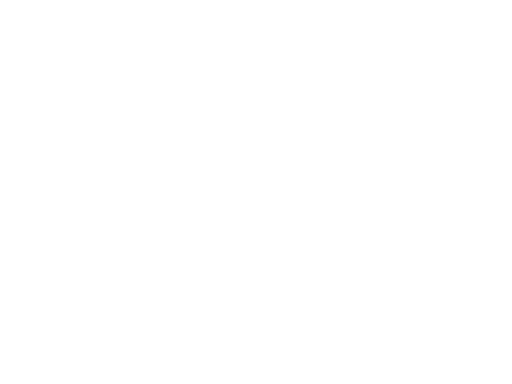

ValueError: not enough values to unpack (expected 1, got 0)

In [66]:
#Voronoi Animation Binary Coloration
%matplotlib notebook
fig = plt.figure()
camera = Camera(fig)
ax = fig.add_subplot(111)

array=raw_data
actual_IDs=array[:,5].astype(int)
unique_IDs=np.unique(array[:,5])
for size in range(100, 5100, 100):
    #sample array
    coords=array[:,3:5]
    array=full_sample(size,'sobol')

    #slice array
    points_and_IDs=array[:,3:6]
    points=points_and_IDs[:,0:2]

    #collapse infinite polygons #expand boundary
    boundary = np.array([[-1, -1], [-1, np.amax(array[:,4])+1], [np.amax(array[:,3])+1, np.amax(array[:,4])+1], [np.amax(array[:,3])+1, -1]])
    diameter = np.linalg.norm(boundary.ptp(axis=0))
    boundary_polygon = Polygon(boundary)

    #list of voronoi polygons (point index = polygon index)
    bounded_poly_list=[]
    for p in voronoi_polygons(Voronoi(points), diameter):
        try:
            bounded_p=p.intersection(boundary_polygon)
            bounded_poly_list.append(bounded_p)
        except:
            bounded_poly_list.append(np.nan)
            
    #split grains
    invalid=[]
    #list of grain polygons (unique grain index = polygon index)
    merged_poly_list=[]
    IDs=points_and_IDs[:,2]
    unique_IDs=np.unique(IDs)
    for grain_ID in unique_IDs:
        indexes=np.where(IDs==grain_ID)
        grain_fragments=[bounded_poly_list[i] for i in indexes[0] if str(bounded_poly_list[i]) != 'nan']
        grain_poly=unary_union(grain_fragments)
        if grain_poly.geom_type=='MultiPolygon': #invalid split grain
            invalid.append(grain_ID)
            merged_poly_list.append(np.nan)
        else:
            merged_poly_list.append(grain_poly)
    
    #get array again for plotting
    array=raw_data
    points_and_IDs=array[:,3:6]

    #create color map
    right_wrong=[]
    #for each coordinate
    for index in np.arange(0,len(array)):
        point=geometry.Point(array[index,3:5])
        index_2=0
        #find the polygon that contains the coord
        found=0
        for polygon in merged_poly_list: #needs to be not nan
            try:
                if polygon.contains(point):
                    if int(points_and_IDs[index,2])==unique_IDs[index_2]: 
                        right_wrong.append([0,0,0])
                        found=1
                        index_2+=1
                        break
                    else:
                        right_wrong.append([1,0,0])
                        found=1
                        index_2+=1
                        break #this breaks the loop!
                else: #polygon does not contain point
                    index_2+=1
            except: #invalid polygon
                index_2+=1
                continue #does the continue increment index as well? - print new loop and index
        #bad geometry
        if found==0:
            right_wrong.append([1,0,0])

    #plot
    percent=size/len(array)*100
    ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
    plt.scatter(array[:,3], array[:,4], c=right_wrong)          
    camera.snap()
anim = camera.animate(blit=True)
anim.save('Sobol Voronoi 5% Binary Coloration.mp4')

<IPython.core.display.Javascript object>


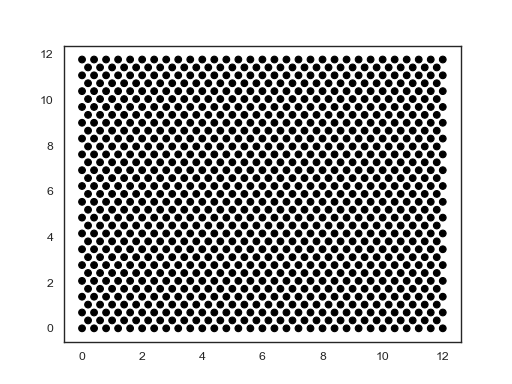

In [56]:
%matplotlib notebook
fig = plt.figure()

array=raw_data_slice
array=array[np.random.choice(array.shape[0], 5, replace=False), :]

actual_IDs=array[:,5].astype(int)
unique_IDs=np.unique(array[:,5])

#slice array
points_and_IDs=array[:,3:6]
points=points_and_IDs[:,0:2]

#collapse infinite polygons #expand boundary
boundary = np.array([[-1, -1], [-1, np.amax(array[:,4])+1], [np.amax(array[:,3])+1, np.amax(array[:,4])+1], [np.amax(array[:,3])+1, -1]])
diameter = np.linalg.norm(boundary.ptp(axis=0))
boundary_polygon = Polygon(boundary)

#list of voronoi polygons (point index = polygon index)
bounded_poly_list=[]
for p in voronoi_polygons(Voronoi(points), diameter):
    bounded_p=p.intersection(boundary_polygon)
    bounded_poly_list.append(bounded_p)

#split grains
invalid=[]
#list of grain polygons (unique grain index = polygon index)
merged_poly_list=[]
IDs=points_and_IDs[:,2]
unique_IDs=np.unique(IDs)
for grain_ID in unique_IDs:
    indexes=np.where(IDs==grain_ID)
    grain_fragments=[bounded_poly_list[i] for i in indexes[0]]
    grain_poly=unary_union(grain_fragments)
    if grain_poly.geom_type=='MultiPolygon': #invalid split grain
        invalid.append(grain_ID)
        merged_poly_list.append(np.nan)
    else:
        merged_poly_list.append(grain_poly)

array=raw_data_slice #repeat with all points - check here also
points_and_IDs=array[:,3:6]

#create color map
right_wrong=[]
#for each coordinate
for index in np.arange(0,len(array)):
    point=geometry.Point(array[index,3:5])
    index_2=0
    #find the polygon that contains the coord
    found=0
    for polygon in merged_poly_list: #needs to be not nan
        try:
            if polygon.contains(point):
                if int(points_and_IDs[index,2])==unique_IDs[index_2]: 
                    right_wrong.append([0,0,0])
                    found=1
                    index_2+=1
                    break
                else:
                    right_wrong.append([1,0,0])
                    found=1
                    index_2+=1
                    break #this breaks the loop!
            else: #polygon does not contain point
                index_2+=1
        except: #invalid polygon
            index_2+=1
            continue #does the continue increment index as well? - print new loop and index
    #bad geometry
    if found==0:
        right_wrong.append([1,0,0])

plt.scatter(array[:,3], array[:,4], c=right_wrong)   

In [ ]:
#run after testing above

In [10]:
#SVM Classification Accuracy
%matplotlib notebook
fig = plt.figure()

percents=[]
accuracies=[]

array=raw_data
actual_IDs=array[:,5].astype(int)
for size in range(100, 5100, 100):
    #predicted IDs for comparison
    x, y, z = svm_slice(sample(size,array,'sobol'),param_2=10e-3)
    svm_prediction=np.stack([x, y, z], axis=1)
    predicted_IDs=svm_prediction[nearest_neighbors(array[:,3:5],svm_prediction[:,0:2]), 2].ravel().astype(int)
    #create colormap
    correct=0
    for index in np.arange(0,len(array)):
        if actual_IDs[index]==predicted_IDs[index]:
            correct+=1
            
    percent=size/len(array)*100
    percents.append(percent)
    accuracies.append(correct/len(array)*100)

sns.lineplot(percents,accuracies)

<IPython.core.display.Javascript object>

<AxesSubplot:>

In [ ]:
#Voronoi Classification Accuracy
%matplotlib notebook
fig = plt.figure()

percents=[]
accuracies=[]

# array=raw_data
unique_IDs=np.unique(array[:,5])
for size in range(100, 5100, 100):
    #slice array
    points_and_IDs=array[:,3:6]
    points=points_and_IDs[:,0:2]

    #collapse infinite polygons
    boundary = np.array([[0, 0], [0, np.amax(array[:,4])], [np.amax(array[:,3]), np.amax(array[:,4])], [np.amax(array[:,3]), 0]])
    diameter = np.linalg.norm(boundary.ptp(axis=0))
    boundary_polygon = Polygon(boundary)

    #list of voronoi polygons (point index = polygon index)
    bounded_poly_list=[]
    for p in voronoi_polygons(Voronoi(points), diameter):
        bounded_p=p.intersection(boundary_polygon)
        bounded_poly_list.append(bounded_p)

    #split grains
    invalid=[]
    #list of grain polygons (unique grain index = polygon index)
    merged_poly_list=[]
    IDs=points_and_IDs[:,2]
    for grain_ID in np.unique(IDs):
        indexes=np.where(IDs==grain_ID)
        grain_fragments=[bounded_poly_list[i] for i in indexes[0]]
        grain_poly=unary_union(grain_fragments)
        if grain_poly.geom_type=='MultiPolygon': #invalid split grain
            invalid.append(grain_ID)
            merged_poly_list.append(np.nan)
        else:
            merged_poly_list.append(grain_poly)

    #create color map
    correct=0
    #for each coordinate
    for index in np.arange(0,len(array)):
        point=geometry.Point(array[index,3:5])
        index_2=0
        #find the polygon that contains the coord
        found=0
        for polygon in merged_poly_list:
            if polygon.contains(point):
                #see if the polygon ID is the same as the point ID
                if int(points_and_IDs[index,2])==unique_IDs[index_2]: 
                    correct+=1
                    found=1
                    break
            #increment index
            index_2+=1
        #edge grain
        if found==0:
            correct+=1
    
    percent=size/len(array)*100
    percents.append(percent)
    accuracies.append(correct/len(array)*100)
    
sns.lineplot(percents,accuracies)

In [ ]:
#should not have any errors!

# %matplotlib notebook
# fig = plt.figure()

# points_and_IDs=sample(len(array),array,strategy='random')
# # add 4 distant dummy points
# points = np.append(points_and_IDs[:,0:2], [[999,999], [-999,999], [999,-999], [-999,-999]], axis = 0)
# # compute Voronoi tesselation
# vor = Voronoi(points)
#  # plot & colorize
# temp_cmap = eulergb_cmap(points_and_IDs[:,2])
# for r in range(len(vor.point_region)):
#     region = vor.regions[vor.point_region[r]]
#     if not -1 in region:
#         polygon = [vor.vertices[i] for i in region]
#         plt.xlim([0,12]), plt.ylim([0,12])
#         plt.fill(*zip(*polygon), color=temp_cmap[r])
        
# temp_cmap = eulergb_cmap(array[:,5])
# plt.scatter(array[:,3], array[:,4], c=temp_cmap)  

# %matplotlib notebook
# fig = plt.figure()

# points_and_IDs=sample(len(array),array,strategy='random')
# # add 4 distant dummy points
# points = np.append(points_and_IDs[:,0:2], [[999,999], [-999,999], [999,-999], [-999,-999]], axis = 0)
# # compute Voronoi tesselation
# vor = Voronoi(points)
#  # plot & colorize
# temp_cmap = eulergb_cmap(points_and_IDs[:,2])
# for r in range(len(vor.point_region)):
#     region = vor.regions[vor.point_region[r]]
#     if not -1 in region:
#         polygon = [vor.vertices[i] for i in region]
#         plt.xlim([0,12]), plt.ylim([0,12])
#         plt.fill(*zip(*polygon), color=temp_cmap[r])

In [111]:
# fig = plt.figure()
# ax = fig.add_subplot(111)
# ims=[]

# array=raw_data_slice
# for size in range(10, 100, 1):
#     percent=size/len(array)*100
#     ttl = plt.text(0.5, 1.01, 'Sample = '+str(round(percent, 2))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
    
#     x, y, z = svm_slice(golden_sample(size,array))
#     temp_cmap = eulergb_cmap(z)
#     ims.append([plt.scatter(x, y, c=temp_cmap), ttl])

# anim = animation.ArtistAnimation(fig, ims, interval=100, blit=False,
#                               repeat_delay=2000)

# fig = plt.figure()
# ax = fig.add_subplot(111)
# ims=[]

# array=raw_data
# for size in range(10, 10000, 1000):
#     percent=size/len(array)*100
#     ttl = plt.text(0.5, 1.01, 'Sample = '+str(round(percent))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
    
#     x, y, z = svm_slice(golden_sample(size,array))
#     temp_cmap = eulergb_cmap(z)
#     ims.append([plt.scatter(x, y, c=temp_cmap), ttl])

# anim = animation.ArtistAnimation(fig, ims, interval=200, blit=False,
#                               repeat_delay=2000)

In [ ]:
# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data_slice
# for size in range(10, 50, 1):
#     x, y, z = svm_slice(golden_sample(size,array))
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# # anim.save('Golden SVM 5% Window.mp4')

# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(100, 5100, 100):
#     x, y, z = svm_slice(golden_sample(size,array),param_2=10e-3)
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# # anim.save('Golden SVM 5%.mp4')

#square and hex SVM

# fig = plt.figure()
# ax = fig.add_subplot(111)

# array=raw_data
# x, y, z = svm_slice(golden_sample(1000,array),param_2=10e-3)
# temp_cmap = eulergb_cmap(z)
# plt.scatter(x, y, c=temp_cmap)

# temp_cmap = eulergb_cmap(raw_data_slice[:,5])
# plt.title('100% of Total Data')
# plt.xlabel('x (μm)')
# plt.ylabel('y (μm)')
# plt.scatter(raw_data_slice[:,3], raw_data_slice[:,4], c=temp_cmap)
# plt.show()

# old, without title
# %matplotlib notebook
# from celluloid import Camera
# camera = Camera(plt.figure())
# array=raw_data
# for size in range(10, 10000, 1000):
#     x, y, z = svm_slice(golden_sample(size,array))
#     temp_cmap = eulergb_cmap(z)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# # anim.save('scatter2.mp4')

In [108]:
# %matplotlib notebook
# fig = plt.figure()
# ax = fig.add_subplot(111)
# ims=[]

# array=raw_data
# for size in range(100, 1100, 100):
#     percent=size/len(array)*100
#     ttl = plt.text(0.5, 1.01, 'Sample = '+str(round(percent))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
    
#     points_and_IDs=golden_sample(size,array)
#     # add 4 distant dummy points
#     points = np.append(points_and_IDs[:,0:2], [[999,999], [-999,999], [999,-999], [-999,-999]], axis = 0)
#     # compute Voronoi tesselation
#     vor = Voronoi(points)
#      # plot & colorize
#     temp_cmap = eulergb_cmap(points_and_IDs[:,2])
#     ploot=[]
#     for r in range(len(vor.point_region)):
#         region = vor.regions[vor.point_region[r]]
#         if not -1 in region:
#             polygon = [vor.vertices[i] for i in region]
#             plt.xlim([0,110]), plt.ylim([0,110])
#             ploot.extend(plt.fill(*zip(*polygon), color=temp_cmap[r]))
#     ims.append([ploot, ttl])

# anim = animation.ArtistAnimation(fig, ims, interval=200, blit=False,
#                               repeat_delay=2000)

#**********************************************************************

# #Voronoi diagram
# def random_vor_plot(sample,array):
#     #choose random points and IDs
#     random_coords_and_IDs=array[np.random.choice(array.shape[0], sample, replace=False), 3:6]
#     # add 4 distant dummy points
#     random_coords = np.append(random_coords_and_IDs[:,0:2], [[999,999], [-999,999], [999,-999], [-999,-999]], axis = 0)
#     # compute Voronoi tesselation
#     vor = Voronoi(random_coords)
#     # plot & colorize
#     temp_cmap = eulergb_cmap(random_coords_and_IDs[:,2])
#     for r in range(len(vor.point_region)):
#         region = vor.regions[vor.point_region[r]]
#         if not -1 in region:
#             polygon = [vor.vertices[i] for i in region]
#             plt.xlim([0,110]), plt.ylim([0,110])
#             plt.fill(*zip(*polygon), color=temp_cmap[r])
#     plt.show()
# 
# random_vor_plot(100,raw_data)

In [15]:
# #Voronoi Animation
# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(100, 5100, 100):
#     points_and_IDs=golden_sample(size,array)
#     # add 4 distant dummy points
#     points = np.append(points_and_IDs[:,0:2], [[999,999], [-999,999], [999,-999], [-999,-999]], axis = 0)
#     # compute Voronoi tesselation
#     vor = Voronoi(points)
#      # plot & colorize
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     temp_cmap = eulergb_cmap(points_and_IDs[:,2])
#     for r in range(len(vor.point_region)):
#         region = vor.regions[vor.point_region[r]]
#         if not -1 in region:
#             polygon = [vor.vertices[i] for i in region]
#             plt.xlim([0,110]), plt.ylim([0,110])
#             plt.fill(*zip(*polygon), color=temp_cmap[r])
#     camera.snap()
# anim = camera.animate(blit=True)
# # anim.save('Golden Voronoi 5%.mp4')

In [110]:
# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(100, 5100, 100):
#     x, y, z = svm_slice(sample(size,array,'random'),param_2=10e-3)
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# anim.save('Random SVM 5%.mp4')

# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(100, 5100, 100):
#     x, y, z = svm_slice(sample(size,array,'square'),param_2=10e-3)
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# anim.save('Square SVM 5%.mp4')

# %matplotlib notebook
# fig = plt.figure()
# camera = Camera(fig)
# ax = fig.add_subplot(111)

# array=raw_data
# for size in range(100, 5100, 100):
#     x, y, z = svm_slice(sample(size,array,'hex'),param_2=10e-3)
#     temp_cmap = eulergb_cmap(z)
#     percent=size/len(array)*100
#     ax.text(0.5, 1.01, 'Sample = '+str(round(percent,1))+'% of Total Data', horizontalalignment='center', verticalalignment='bottom', transform=ax.transAxes)
#     plt.scatter(x, y, c=temp_cmap)
#     camera.snap()
# anim = camera.animate(blit=True)
# anim.save('Hex SVM 5%.mp4')

In [140]:
# %matplotlib notebook
# fig = plt.figure()

# array=raw_data_slice
# actual_IDs=array[:,5].astype(int)

# # add 4 distant dummy points and compute Voronoi tesselation
# points_and_IDs=sample(len(array),array,strategy='sobol')
# points = np.append(points_and_IDs[:,0:2], [[999,999], [-999,999], [999,-999], [-999,-999]], axis = 0)
# vor = Voronoi(points)

# #create a list of polygons corresponding to point IDs
# polygons=[]
# for r in range(len(vor.point_region)):
#     region = vor.regions[vor.point_region[r]]
#     if not -1 in region:
#         polygon = [vor.vertices[i] for i in region]
#         polygons.append(Polygon(polygon))

# plt.xlim([0,12]), plt.ylim([0,12])
# for polygon in polygons:
#     plt.plot(*polygon.exterior.xy, color='black')
    
# # #create color map
# # right_wrong=[]
# # #for each coordinate
# # for index in np.arange(0,len(array)):
# #     point=geometry.Point(array[index,3:5])
# #     index_2=0
# #     #find the polygon that contains the coord
# #     found=0
# #     for polygon in polygons:
# #         if polygon.contains(point):
# #             #see if the polygon ID is the same as the point ID
# #             if int(points_and_IDs[index_2,2])==actual_IDs[index]: 
# #                 right_wrong.append([0,0,0])
# #                 found=1
# #                 break
# #             else:
# #                 right_wrong.append([1,0,0])
# #                 found=1
# #                 break
# #         #increment index
# #         index_2+=1
# #     #no polygon contains the point
# #     if found==0:
# #         right_wrong.append([1,0,0])

# # plt.scatter(array[:,3], array[:,4], c=right_wrong)   